In [3]:
import pandas as pd
import os
import sys
import warnings
import glob
import numpy as np
# suppress pandas purely educational warnings
from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

sys.path.append(os.path.expanduser('../../'))
from scripts.utils.file_helpers import pull_csv_from_directory, upload_csv_aws
from scripts.utils.write_metadata import append_metadata
from scripts.utils.index_plot import plot_domain, plot_region_domain
from scripts.utils.calculate_index import (handle_outliers, min_max_standardize, process_domain_csv_files, 
                                        compute_averaged_indicators, compute_summed_indicators, indicator_dicts, 
                                        add_census_tracts, domain_summary_stats)
pd.set_option('display.max_columns', 500)


In [4]:
# set-up
bucket_name = 'ca-climate-index'
aws_dir = '3_fair_data/index_data/'

pull_csv_from_directory(bucket_name, aws_dir, output_folder='aws_csvs', search_zipped=False, print_name=False)

Metric data retrieved from 3_fair_data/index_data/.


In [5]:
def process_domain_csv_files(prefix, input_folder, output_folder, meta_csv, merged_output_file):
    '''
    Pulls metric CSV files based on domain prefix variable from the input folder, merges all together based on shared GEOID column. 
    NaN values within the GEOID column are removed, and infinite values (if any) in other columns are adjusted to NaN values.
    Lastly, an uninhabited island tract is also given NaN metric values.
    
    Parameters
    ----------
    prefix: str
        Shared prefix for the desired domain csv files to call in:
            'society_'
            'built_'
            'governance_'
            'climate_'
    input_folder: str
        Name of the folder that is storing all metric csv files
    output_folder: str
        Name of the folder to store pulled domain specific csv files.
    meta_csv: str
        Local path to the metadata pipeline.
    merged_output_file: str
        Desired name of merged output csv file.
    '''

    # Function to detect incremental columns
    def is_incremental(series):
        """Check if a column is incremental (starts from 0 or 1 and increases by 1)."""
        if series.dtype in [np.int64, np.float64]:  # Ensure numeric columns
            diff = series.diff().dropna()  # Calculate the difference between consecutive values
            return (diff == 1).all() and series.iloc[0] in [0, 1]
        return False

    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Load the metadata CSV
    df = pd.read_csv(meta_csv)

    # Get the list of metric file names and corresponding 'Metric' and 'High value result (vulnerable or resilient)' entries
    metric_files = df[['Metric file name', 'Metric', 'High value result (vulnerable or resilient)']]

    # Dictionary to hold the metric and corresponding last column from the CSV files
    metric_last_column_dict = {}

    # Second dictionary for resilience and vulnerability grouping
    resilience_vulnerability_dict = {'resilient': [], 'vulnerable': []}

    # Find all CSV files starting with the provided prefix in the input folder and matching the metric file names
    source_files = [file for file in glob.glob(os.path.join(input_folder, f'{prefix}*.csv')) 
                    if os.path.basename(file) in metric_files['Metric file name'].values]

    # Iterate through the source files and process them
    for file in source_files:
        # Get the 'Metric' entry for the current file
        metric_info = metric_files.loc[metric_files['Metric file name'] == os.path.basename(file)]
        metric_name = metric_info['Metric'].values[0]
        high_value_result = metric_info['High value result (vulnerable or resilient)'].values[0]

        # Load the CSV file
        csv_df = pd.read_csv(file)

        # Detect and remove incremental columns
        incremental_cols = [col for col in csv_df.columns if is_incremental(csv_df[col])]
        csv_df.drop(columns=incremental_cols, inplace=True)

        # Get the last column name
        last_column = csv_df.columns[-1]

        # Add the metric name and last column name to the dictionary
        metric_last_column_dict[metric_name] = last_column

        # Add the metric name to the appropriate resilience or vulnerability group
        if high_value_result.lower() == 'resilient':
            resilience_vulnerability_dict['resilient'].append(metric_name)
        elif high_value_result.lower() == 'vulnerable':
            resilience_vulnerability_dict['vulnerable'].append(metric_name)

        # Construct the destination file path
        destination_path = os.path.join(output_folder, os.path.basename(file))

        # Save the modified CSV to the output folder
        csv_df.to_csv(destination_path, index=False)

        # Remove the original file
        os.remove(file)

    print(f"Processed and saved {len(source_files)} CSV files within {prefix} domain.")
    print('\nMetric dictionary created and called: metric_last_column_dict')

    # --- Additional Processing: Merging CSV Files ---

    # Get a list of all CSV files in the output folder
    csv_files = glob.glob(os.path.join(output_folder, '*.csv'))

    # Initialize an empty DataFrame for merging
    merged_df = pd.DataFrame()

    # Iterate through each CSV file and merge them on the 'GEOID' column
    for file in csv_files:
        # Read the CSV file into a DataFrame
        df = pd.read_csv(file)
        
        # Rename 'GEO_ID', 'tract', 'TRACT', 'Census_Tract', 'GEOID', 'USCB_GEOID' to 'GEOID' if they exist
        rename_cols = ['GEO_ID', 'GEOID', 'tract', 'TRACT', 'Census_Tract', 'census_tract', 'USCB_GEOID', 'Unnamed: 0']
        for col in rename_cols:
            if col in df.columns:
                df.rename(columns={col: 'GEOID'}, inplace=True)
                break
         
        # Keep only the 'GEOID' and the last column from each file
        last_column = df.columns[-1]
        df = df[['GEOID', last_column]]
        
        # Merge the DataFrame with the existing merged DataFrame
        if merged_df.empty:
            merged_df = df
        else:
            merged_df = pd.merge(merged_df, df, on='GEOID', how='outer')

    # Drop rows where 'GEOID' is NaN
    merged_df = merged_df.dropna(subset=['GEOID'])

    # Convert census tract to string and eliminate scientific notation default
    merged_df['GEOID'] = merged_df['GEOID'].dropna().apply(lambda x: '{:.0f}'.format(x))

    # Convert all values within the island tract (near San Francisco) to NaN, as it is uninhabited 
    island_tract = '6075980401'
    merged_df.loc[merged_df['GEOID'] == island_tract, merged_df.columns != 'GEOID'] = np.nan

    # Check if all entries within the island tract are NaN
    island_row = merged_df.loc[merged_df['GEOID'] == island_tract]
    if island_row.iloc[:, 1:].isnull().all().all():
        print(f"\nAll entries within the island tract ({island_tract}) are NaN.")
    else:
        print(f"\nSome entries within the island tract ({island_tract}) are not NaN.")

    merged_df['GEOID'] = merged_df['GEOID'].apply(lambda x: '0' + str(x))
    merged_df['GEOID'] = merged_df['GEOID'].astype(str).apply(lambda x: x.rstrip('0').rstrip('.') if '.' in x else x)

    # Selecting only numeric columns
    numeric_df = merged_df.select_dtypes(include=[np.number])

    # Counting infinite values
    num_infinite = np.isinf(numeric_df).sum().sum()

    print(f"\nNumber of infinite entries in the DataFrame: {num_infinite}")
    print('Replacing infinite entries (if any) with NaN')

    # Replace infinite values with NaN
    merged_df.replace([np.inf, -np.inf], np.nan, inplace=True)

    # Counting infinite values after replacement
    num_infinite = np.isinf(numeric_df).sum().sum()
    print(f"Number of infinite entries in the DataFrame after replacement: {num_infinite}")

    print(f"\nFile processing complete, dataframe will now be saved as a .csv")
    
    # Save the merged DataFrame to a CSV file
    merged_df.to_csv(merged_output_file, index=False)

    print(f"Processed CSV saved as {merged_output_file}")
    
    return metric_last_column_dict, resilience_vulnerability_dict


In [6]:
# domain-specific
domain_prefix = '' # pull all domains
input_folder = r'aws_csvs'
output_folder = domain_prefix + "folder"
meta_csv = r'../utils/calcrai_metrics.csv'

merged_output_file = 'all_domain_files.csv'

metric_last_column_dict, resilience_vulnerability_dict = process_domain_csv_files(domain_prefix, input_folder, output_folder, meta_csv, merged_output_file)

Processed and saved 110 CSV files within  domain.

Metric dictionary created and called: metric_last_column_dict

All entries within the island tract (6075980401) are NaN.

Number of infinite entries in the DataFrame: 67
Replacing infinite entries (if any) with NaN
Number of infinite entries in the DataFrame after replacement: 67

File processing complete, dataframe will now be saved as a .csv
Processed CSV saved as all_domain_files.csv


In [7]:
all_metrics = pd.read_csv('all_domain_files.csv')

In [8]:
resilience_vulnerability_dict

{'resilient': ['# of cellular towers',
  '% of underground transmission lines',
  '# of microwave service towers',
  '# of mobile broadcast towers',
  '# of paging transmission towers',
  '# of power plants',
  '# of radio transmission towers',
  '# of public airports',
  '# of bridges',
  '# of miles of highway',
  '# of miles of freight rail',
  '# of broadcast service providers',
  '# of wastewater treatment facilities',
  'enrollment in national flood insurance program',
  'total amount of funding received 2014-2022',
  '# of paramedics and emergency medical technicians per 10,000 people',
  '# of firefighters per 10,000 people',
  '# of fire stations per 10,000 people',
  '# of national flood insurance program participants',
  'total amount of hazard mitigation funding recieved between 1990-2023',
  "% of households with mortgage, used as a proxy for posession of a homeowner's insurance policy",
  '% of survey respondents who have engaged in at least one preparedness action in the

In [9]:
metric_last_column_dict

{'% of area unserved at broadband speeds of >25 mpbs download and >3 mbps upload': 'low_internet_download_flag',
 '# of cellular towers': 'cellular_towers_data_count',
 '% of underground transmission lines': 'percent_underground_transmission_lines',
 '% of homes built before 1980': 'percent_housing_before_1980',
 '% of mobile residential structures': 'percent_mobile_homes',
 '% of homes lacking complete kitchen or plumbing facilities': 'percent_without_kitchen_facilities_or_plumbing',
 '# of vacant homes under ownership': 'estimated_total_vacant_housing_units',
 '# of microwave service towers': 'microwave_towers_data_count',
 '# of mobile broadcast towers': 'mobile_towers_data_count',
 '# of paging transmission towers': 'paging_towers_data_count',
 '# of power plants': 'power_plant_count',
 'average annual Public Safety Power Shutoff events ': 'avg_num_psps_event',
 '# of radio transmission towers': 'radio_towers_data_count',
 '# of public airports': 'number_of_airports',
 '# of heavy 

In [10]:
all_metrics

,GEOID,low_internet_download_flag,cellular_towers_data_count,percent_underground_transmission_lines,percent_housing_before_1980,percent_mobile_homes,percent_without_kitchen_facilities_or_plumbing,estimated_total_vacant_housing_units,microwave_towers_data_count,mobile_towers_data_count,paging_towers_data_count,power_plant_count,avg_num_psps_event,radio_towers_data_count,number_of_airports,number_of_bottlenecks,numbers_of_bridges,highway_length_in_miles,railway_length_in_miles,tv_contour_data_count,num_exclusive_wastewater_facilities,drought_coverage_percentage,drought_crop_loss_acres,drought_crop_loss_indemnity_amount,change_in_drought_years,percent_weeks_drought,mean_change_annual_heat_days,mean_change_annual_warm_nights,floodplain_percentage,avg_flood_insurance_payout_per_claim,estimated_flood_crop_loss_cost,precip_99percentile,surface_runoff,total_flood_fatalities,median_flood_warning_days,mean_change_cold_days,heat_crop_loss_acres,heat_crop_loss_indemnity_amount,avg_age_adjust_heat_hospitalizations_per_10000,median_heat_warning_days,slr_vulnerable_building_content_cost,fire_stations_count_diff,hospitals_count_diff,police_stations_count_diff,schools_count_diff,building_exposed_slr_count,slr_vulnerability_delta_percentage_change,slr_vulnerable_wastewater_treatment_count,rcp_4.5__50th_percent_change,burn_area_m2,change_ffwi_days,average_damaged_destroyed_structures_wildfire,average_annual_fatalities_wildfire,median_red_flag_warning_days,nfip_participation,total_emergency_management_funding,num_emergency_medical_technicians_and_paramedics_employed_per_10000,num_firefighting_and_prevention_workers_employed_per_10000,num_fire_stations_per_10000_people,num_flood_policies,total_hazard_mitigation_funding,housing_units_with_mortgage,percent_prepared_for_general_disaster,percent_prepared_without_power,percent_prepared_without_water,num_police_officers_employed_per_10000,num_registered_nurses_employed_per_10000,percent_under_timber_management,percent_sampled_wells_contaminated,CRI Metric Percentage,protected_areas_percentage,esi_mean,ssma_mean,percent_vulnerable_soils,percent_vulnerable_drought,percent_vulnerable_fire,SpBioWtEco,tract_percent_impervious,percent_population_ambulatory_disabilities,percent_total_pop_american_indian_alaska_native,blood and organ banks per 10000 people,percent_population_cognitive_disabilities,est_gini_index,hachman_index,est_median_income_dollars,percent_children_household_financial_assistance,percent_1miurban_10mirural,health and personal care stores per 10000 people,heavy and civil engineering construction per 10000 people,hospitals per 10000 people,avg_hpsscore_mental_shortage_metric,narcotic_support_per_10000,real_percent_total_pop_over_65,personal and household goods repair and maintenance per 10000 people,avg_hpsscore_primary_care_metric,specialty trade contractors per 10000 people,percent_total_pop_under_5,asthma_related_ed_visits_per_10000_people_2019,cardiovascular_disease_related_ed_visits_per_10000_people_2019,education_percent_2019,avg_percent_population_homeless,housing_burden_percent_2019,sum_imp_water_bodies,linguistic_isolation_percent_2019,low_birth_weight_percent_2019,Percent of households without air conditioning,Percent of population employed and aged > 16 working outdoors,poverty_percent_2019,unemployment_percent_2019,"Number of Violent Crimes per 10,000 Population",percent_population_without_health_insurance
0,6001400100,0.0,2.0,0.0,15.032680,2.0,0.0,119.0,734.0,28.0,12.0,0.0,0.800000,19.0,3.0,5.0,302.0,920.838160,181.100468,13.0,16.0,37.984370,197.583333,7394.25,3.500000,0.570255,2.683333,17.908333,NaN,5463.8925,0.0,0.817024,1.264492,1.0,3.0,-3.225000,769.522222,14348.571429,74.250000,2.0,650084.0,3.0,0.0,1.0,14.0,1315.0,NaN,4.0,-3.740648,NaN,0.000000,4.0,0.0,3.5,1.0,3835219.0,6.220614,6.461024,0.552943,2642.0,1.935016e+08,68.7,52.380952,57.142857,57.142857,12.441227,82.130130,NaN,NaN,3.664105,17.313634,-0.153958,-0.150978,85.7,94.2,86.1,0.788310,10.386114,4.680330,0.0,0.042072,5.170

In [11]:
# standardizing our df
columns_to_process = [col for col in all_metrics.columns if col != 'GEOID']
min_max_metrics = min_max_standardize(all_metrics, columns_to_process)

All standardized columns are within the [0, 1] range (considering tolerance).


In [12]:
# List of words to filter columns
words = ['GEOID', 'standardized']

# Initialize an empty list to hold the selected columns
selected_columns = []

# Iterate over the words
for word in words:
    # If the word is 'standardized', use a regular expression to match only when it appears at the end of a string
    if word == 'standardized':
        selected_columns.extend(min_max_metrics.columns[min_max_metrics.columns.str.contains(r'standardized$', regex=True)].tolist())
    else:
        # For other words, use a normal contains check
        selected_columns.extend(min_max_metrics.columns[min_max_metrics.columns.str.contains(word)].tolist())

# Create the filtered DataFrame with the selected columns
min_max_standardized_all_metrics_df = min_max_metrics[selected_columns]


In [13]:
min_max_standardized_all_metrics_df

,GEOID,low_internet_download_flag_min_max_standardized,cellular_towers_data_count_min_max_standardized,percent_underground_transmission_lines_min_max_standardized,percent_housing_before_1980_min_max_standardized,percent_mobile_homes_min_max_standardized,percent_without_kitchen_facilities_or_plumbing_min_max_standardized,estimated_total_vacant_housing_units_min_max_standardized,microwave_towers_data_count_min_max_standardized,mobile_towers_data_count_min_max_standardized,paging_towers_data_count_min_max_standardized,power_plant_count_min_max_standardized,avg_num_psps_event_min_max_standardized,radio_towers_data_count_min_max_standardized,number_of_airports_min_max_standardized,number_of_bottlenecks_min_max_standardized,numbers_of_bridges_min_max_standardized,highway_length_in_miles_min_max_standardized,railway_length_in_miles_min_max_standardized,tv_contour_data_count_min_max_standardized,num_exclusive_wastewater_facilities_min_max_standardized,drought_coverage_percentage_min_max_standardized,drought_crop_loss_acres_min_max_standardized,drought_crop_loss_indemnity_amount_min_max_standardized,change_in_drought_years_min_max_standardized,percent_weeks_drought_min_max_standardized,mean_change_annual_heat_days_min_max_standardized,mean_change_annual_warm_nights_min_max_standardized,floodplain_percentage_min_max_standardized,avg_flood_insurance_payout_per_claim_min_max_standardized,estimated_flood_crop_loss_cost_min_max_standardized,precip_99percentile_min_max_standardized,surface_runoff_min_max_standardized,total_flood_fatalities_min_max_standardized,median_flood_warning_days_min_max_standardized,mean_change_cold_days_min_max_standardized,heat_crop_loss_acres_min_max_standardized,heat_crop_loss_indemnity_amount_min_max_standardized,avg_age_adjust_heat_hospitalizations_per_10000_min_max_standardized,median_heat_warning_days_min_max_standardized,slr_vulnerable_building_content_cost_min_max_standardized,fire_stations_count_diff_min_max_standardized,hospitals_count_diff_min_max_standardized,police_stations_count_diff_min_max_standardized,schools_count_diff_min_max_standardized,building_exposed_slr_count_min_max_standardized,slr_vulnerability_delta_percentage_change_min_max_standardized,slr_vulnerable_wastewater_treatment_count_min_max_standardized,rcp_4.5__50th_percent_change_min_max_standardized,burn_area_m2_min_max_standardized,change_ffwi_days_min_max_standardized,average_damaged_destroyed_structures_wildfire_min_max_standardized,average_annual_fatalities_wildfire_min_max_standardized,median_red_flag_warning_days_min_max_standardized,nfip_participation_min_max_standardized,total_emergency_management_funding_min_max_standardized,num_emergency_medical_technicians_and_paramedics_employed_per_10000_min_max_standardized,num_firefighting_and_prevention_workers_employed_per_10000_min_max_standardized,num_fire_stations_per_10000_people_min_max_standardized,num_flood_policies_min_max_standardized,total_hazard_mitigation_funding_min_max_standardized,housing_units_with_mortgage_min_max_standardized,percent_prepared_for_general_disaster_min_max_standardized,percent_prepared_without_power_min_max_standardized,percent_prepared_without_water_min_max_standardized,num_police_officers_employed_per_10000_min_max_standardized,num_registered_nurses_employed_per_10000_min_max_standardized,percent_under_timber_management_min_max_standardized,percent_sampled_wells_contaminated_min_max_standardized,CRI Metric Percentage_min_max_standardized,protected_areas_percentage_min_max_standardized,esi_mean_min_max_standardized,ssma_mean_min_max_standardized,percent_vulnerable_soils_min_max_standardized,percent_vulnerable_drought_min_max_standardized,percent_vulnerable_fire_min_max_standardized,SpBioWtEco_min_max_standardized,tract_percent_impervious_min_max_standardized,percent_population_ambulatory_disabilities_min_max_standardized,percent_total_pop_american_indian_alaska_native_min_max_standardized,blood and organ banks per 10000 people_min_max_standardized,percent

In [14]:
# GEOID handling
min_max_standardized_all_metrics_df['GEOID'] = min_max_standardized_all_metrics_df['GEOID'].apply(lambda x: '0' + str(x))
min_max_standardized_all_metrics_df['GEOID'] = min_max_standardized_all_metrics_df['GEOID'].astype(str).apply(lambda x: x.rstrip('0').rstrip('.') if '.' in x else x)

C:\Users\jesse\AppData\Local\Temp\ipykernel_23100\3132168410.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  min_max_standardized_all_metrics_df['GEOID'] = min_max_standardized_all_metrics_df['GEOID'].apply(lambda x: '0' + str(x))
C:\Users\jesse\AppData\Local\Temp\ipykernel_23100\3132168410.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  min_max_standardized_all_metrics_df['GEOID'] = min_max_standardized_all_metrics_df['GEOID'].astype(str).apply(lambda x: x.rstrip('0').rstrip('.') if '.' in x else x

In [25]:
resilience_vulnerability_dict

{'resilient': ['# of cellular towers',
  '% of underground transmission lines',
  '# of microwave service towers',
  '# of mobile broadcast towers',
  '# of paging transmission towers',
  '# of power plants',
  '# of radio transmission towers',
  '# of public airports',
  '# of bridges',
  '# of miles of highway',
  '# of miles of freight rail',
  '# of broadcast service providers',
  '# of wastewater treatment facilities',
  'enrollment in national flood insurance program',
  'total amount of funding received 2014-2022',
  '# of paramedics and emergency medical technicians per 10,000 people',
  '# of firefighters per 10,000 people',
  '# of fire stations per 10,000 people',
  '# of national flood insurance program participants',
  'total amount of hazard mitigation funding recieved between 1990-2023',
  "% of households with mortgage, used as a proxy for posession of a homeowner's insurance policy",
  '% of survey respondents who have engaged in at least one preparedness action in the

In [15]:
# Cell 1: Adjust Vulnerable Columns
vulnerable_metric_names = resilience_vulnerability_dict['vulnerable']

# Get the actual column names corresponding to resilient metrics
vulnerable_columns_in_df = [
    f"{metric_last_column_dict[metric_name]}_min_max_standardized"
    for metric_name in vulnerable_metric_names if metric_name in metric_last_column_dict
]

# Adjust the resilient columns in the original DataFrame
adjusted_vulnerable_df = min_max_standardized_all_metrics_df.copy()

for column_name in vulnerable_columns_in_df:
    # Check if the column exists in the DataFrame
    if column_name in adjusted_vulnerable_df.columns:
        # Subtract from 1 to adjust the values
        adjusted_vulnerable_df[column_name] = 1 - adjusted_vulnerable_df[column_name]
    else:
        print(f"Column '{column_name}' not found in DataFrame for adjustment.")

# Output result to inspect the adjusted DataFrame
#print("Adjusted DataFrame with resilient columns:")
#print(adjusted_resilient_df.head())


In [16]:
min_max_standardized_all_metrics_df

,GEOID,low_internet_download_flag_min_max_standardized,cellular_towers_data_count_min_max_standardized,percent_underground_transmission_lines_min_max_standardized,percent_housing_before_1980_min_max_standardized,percent_mobile_homes_min_max_standardized,percent_without_kitchen_facilities_or_plumbing_min_max_standardized,estimated_total_vacant_housing_units_min_max_standardized,microwave_towers_data_count_min_max_standardized,mobile_towers_data_count_min_max_standardized,paging_towers_data_count_min_max_standardized,power_plant_count_min_max_standardized,avg_num_psps_event_min_max_standardized,radio_towers_data_count_min_max_standardized,number_of_airports_min_max_standardized,number_of_bottlenecks_min_max_standardized,numbers_of_bridges_min_max_standardized,highway_length_in_miles_min_max_standardized,railway_length_in_miles_min_max_standardized,tv_contour_data_count_min_max_standardized,num_exclusive_wastewater_facilities_min_max_standardized,drought_coverage_percentage_min_max_standardized,drought_crop_loss_acres_min_max_standardized,drought_crop_loss_indemnity_amount_min_max_standardized,change_in_drought_years_min_max_standardized,percent_weeks_drought_min_max_standardized,mean_change_annual_heat_days_min_max_standardized,mean_change_annual_warm_nights_min_max_standardized,floodplain_percentage_min_max_standardized,avg_flood_insurance_payout_per_claim_min_max_standardized,estimated_flood_crop_loss_cost_min_max_standardized,precip_99percentile_min_max_standardized,surface_runoff_min_max_standardized,total_flood_fatalities_min_max_standardized,median_flood_warning_days_min_max_standardized,mean_change_cold_days_min_max_standardized,heat_crop_loss_acres_min_max_standardized,heat_crop_loss_indemnity_amount_min_max_standardized,avg_age_adjust_heat_hospitalizations_per_10000_min_max_standardized,median_heat_warning_days_min_max_standardized,slr_vulnerable_building_content_cost_min_max_standardized,fire_stations_count_diff_min_max_standardized,hospitals_count_diff_min_max_standardized,police_stations_count_diff_min_max_standardized,schools_count_diff_min_max_standardized,building_exposed_slr_count_min_max_standardized,slr_vulnerability_delta_percentage_change_min_max_standardized,slr_vulnerable_wastewater_treatment_count_min_max_standardized,rcp_4.5__50th_percent_change_min_max_standardized,burn_area_m2_min_max_standardized,change_ffwi_days_min_max_standardized,average_damaged_destroyed_structures_wildfire_min_max_standardized,average_annual_fatalities_wildfire_min_max_standardized,median_red_flag_warning_days_min_max_standardized,nfip_participation_min_max_standardized,total_emergency_management_funding_min_max_standardized,num_emergency_medical_technicians_and_paramedics_employed_per_10000_min_max_standardized,num_firefighting_and_prevention_workers_employed_per_10000_min_max_standardized,num_fire_stations_per_10000_people_min_max_standardized,num_flood_policies_min_max_standardized,total_hazard_mitigation_funding_min_max_standardized,housing_units_with_mortgage_min_max_standardized,percent_prepared_for_general_disaster_min_max_standardized,percent_prepared_without_power_min_max_standardized,percent_prepared_without_water_min_max_standardized,num_police_officers_employed_per_10000_min_max_standardized,num_registered_nurses_employed_per_10000_min_max_standardized,percent_under_timber_management_min_max_standardized,percent_sampled_wells_contaminated_min_max_standardized,CRI Metric Percentage_min_max_standardized,protected_areas_percentage_min_max_standardized,esi_mean_min_max_standardized,ssma_mean_min_max_standardized,percent_vulnerable_soils_min_max_standardized,percent_vulnerable_drought_min_max_standardized,percent_vulnerable_fire_min_max_standardized,SpBioWtEco_min_max_standardized,tract_percent_impervious_min_max_standardized,percent_population_ambulatory_disabilities_min_max_standardized,percent_total_pop_american_indian_alaska_native_min_max_standardized,blood and organ banks per 10000 people_min_max_standardized,percent

In [17]:
adjusted_vulnerable_df

,GEOID,low_internet_download_flag_min_max_standardized,cellular_towers_data_count_min_max_standardized,percent_underground_transmission_lines_min_max_standardized,percent_housing_before_1980_min_max_standardized,percent_mobile_homes_min_max_standardized,percent_without_kitchen_facilities_or_plumbing_min_max_standardized,estimated_total_vacant_housing_units_min_max_standardized,microwave_towers_data_count_min_max_standardized,mobile_towers_data_count_min_max_standardized,paging_towers_data_count_min_max_standardized,power_plant_count_min_max_standardized,avg_num_psps_event_min_max_standardized,radio_towers_data_count_min_max_standardized,number_of_airports_min_max_standardized,number_of_bottlenecks_min_max_standardized,numbers_of_bridges_min_max_standardized,highway_length_in_miles_min_max_standardized,railway_length_in_miles_min_max_standardized,tv_contour_data_count_min_max_standardized,num_exclusive_wastewater_facilities_min_max_standardized,drought_coverage_percentage_min_max_standardized,drought_crop_loss_acres_min_max_standardized,drought_crop_loss_indemnity_amount_min_max_standardized,change_in_drought_years_min_max_standardized,percent_weeks_drought_min_max_standardized,mean_change_annual_heat_days_min_max_standardized,mean_change_annual_warm_nights_min_max_standardized,floodplain_percentage_min_max_standardized,avg_flood_insurance_payout_per_claim_min_max_standardized,estimated_flood_crop_loss_cost_min_max_standardized,precip_99percentile_min_max_standardized,surface_runoff_min_max_standardized,total_flood_fatalities_min_max_standardized,median_flood_warning_days_min_max_standardized,mean_change_cold_days_min_max_standardized,heat_crop_loss_acres_min_max_standardized,heat_crop_loss_indemnity_amount_min_max_standardized,avg_age_adjust_heat_hospitalizations_per_10000_min_max_standardized,median_heat_warning_days_min_max_standardized,slr_vulnerable_building_content_cost_min_max_standardized,fire_stations_count_diff_min_max_standardized,hospitals_count_diff_min_max_standardized,police_stations_count_diff_min_max_standardized,schools_count_diff_min_max_standardized,building_exposed_slr_count_min_max_standardized,slr_vulnerability_delta_percentage_change_min_max_standardized,slr_vulnerable_wastewater_treatment_count_min_max_standardized,rcp_4.5__50th_percent_change_min_max_standardized,burn_area_m2_min_max_standardized,change_ffwi_days_min_max_standardized,average_damaged_destroyed_structures_wildfire_min_max_standardized,average_annual_fatalities_wildfire_min_max_standardized,median_red_flag_warning_days_min_max_standardized,nfip_participation_min_max_standardized,total_emergency_management_funding_min_max_standardized,num_emergency_medical_technicians_and_paramedics_employed_per_10000_min_max_standardized,num_firefighting_and_prevention_workers_employed_per_10000_min_max_standardized,num_fire_stations_per_10000_people_min_max_standardized,num_flood_policies_min_max_standardized,total_hazard_mitigation_funding_min_max_standardized,housing_units_with_mortgage_min_max_standardized,percent_prepared_for_general_disaster_min_max_standardized,percent_prepared_without_power_min_max_standardized,percent_prepared_without_water_min_max_standardized,num_police_officers_employed_per_10000_min_max_standardized,num_registered_nurses_employed_per_10000_min_max_standardized,percent_under_timber_management_min_max_standardized,percent_sampled_wells_contaminated_min_max_standardized,CRI Metric Percentage_min_max_standardized,protected_areas_percentage_min_max_standardized,esi_mean_min_max_standardized,ssma_mean_min_max_standardized,percent_vulnerable_soils_min_max_standardized,percent_vulnerable_drought_min_max_standardized,percent_vulnerable_fire_min_max_standardized,SpBioWtEco_min_max_standardized,tract_percent_impervious_min_max_standardized,percent_population_ambulatory_disabilities_min_max_standardized,percent_total_pop_american_indian_alaska_native_min_max_standardized,blood and organ banks per 10000 people_min_max_standardized,percent

In [18]:
# Cell 2: Rename All Columns
# Create a mapping to rename all columns
rename_mapping_all = {
    f"{v}_min_max_standardized": k 
    for k, v in metric_last_column_dict.items() 
    if f"{v}_min_max_standardized" in adjusted_vulnerable_df.columns
}

# Rename the columns in the DataFrame
adjusted_vulnerablility_renamed_df = adjusted_vulnerable_df.rename(columns=rename_mapping_all)

# Output the updated DataFrame to check the new column names
#print("Renamed columns:")
#print(adjusted_resilient_df.head())


In [19]:
adjusted_vulnerablility_renamed_df

,GEOID,% of area unserved at broadband speeds of >25 mpbs download and >3 mbps upload,# of cellular towers,% of underground transmission lines,% of homes built before 1980,% of mobile residential structures,% of homes lacking complete kitchen or plumbing facilities,# of vacant homes under ownership,# of microwave service towers,# of mobile broadcast towers,# of paging transmission towers,# of power plants,average annual Public Safety Power Shutoff events,# of radio transmission towers,# of public airports,# of heavy congestion areas,# of bridges,# of miles of highway,# of miles of freight rail,# of broadcast service providers,# of wastewater treatment facilities,average annual drought % coverage,average # of acres lost from heat per year,average cost of crop lost from heat per year,"% change in the number of drought years classified as having Moderate, Severe, or Extreme drought conditions via SPEI",total number of weeks in drought,mean annual change in extreme heat days,mean annual change in warm nights,% of area in 100 year floodplain,average flood insurance claim payout per number of claims,estimated monetary crop damage,absolute change in 99th percentile 1-day accumulated precipitation,absolute change in 99th percentile surface runoff,# of direct flood/flash flood fatalities since 1996,median number of flood (including coastal and flash) warning days,mean annual change in cold days,average # of acres lost from drought per year,average cost of crop loss from drought per year,"average number of age adjusted heat related hospitalizations per 10,000",median number of days with excessive heat warnings,monetary value of replacing buildings & contents,change in number of fire stations vulnerable to sea level rise between baseline and 1.4m rise conditions,change in number of hospitals vulnerable to sea level rise between baseline and 1.4m rise conditions,change in number of police stations vulnerable to sea level rise between baseline and 1.4m rise conditions,change in number of schools vulnerable to sea level rise between baseline and 1.4m rise conditions,# of exposed buildings to sea level rise,percent change in slr tract vulnerablility between 2000 and 2100,# of wastewater treatment plants vulnerable to sea level rise under 1.4m rise conditions,"counties projected to lose > 10% wetland habitat by 2100 under ""full coastal development"" predictions",change in total area burned per year,change in median annual # of days with Fosberg Fire Weather Index value 50 and greater,# of buildings destroyed/damaged from wildfire per year,# of fatalities from wildfire per year,median annual # of days with red flag warnings,enrollment in national flood insurance program,total amount of funding received 2014-2022,"# of paramedics and emergency medical technicians per 10,000 people","# of firefighters per 10,000 people","# of fire stations per 10,000 people",# of national flood insurance program participants,total amount of hazard mitigation funding recieved between 1990-2023,"% of households with mortgage, used as a proxy for posession of a homeowner's insurance policy",% of survey respondents who have engaged in at least one preparedness action in the last year,% of survey respondents who can live in their homes for at least 3 days without power,% of survey respondents who can live in their homes for at least 3 days without running water,"# of police officers per 10,000 people","# of registered nurses per 10,000 people",% of land under timber management practices,"% of domestic wells considered high risk for any of the following contaminants: nitrate, arsenic, 1,2,3-Trichloropropane, hexavalent chromium, uranium",% of days with unhealthy or worse air quality days between 1980-2022,% of land under management practices,mean evaporative stress index,mean surface soil moisture anomaly,% of soil cover rated moderately fragile or worse,% of soil rated moderately drought vulnerable or worse,% of soil moderately susceptible to fire damage,ecoregion b

In [20]:
gdf = add_census_tracts(adjusted_vulnerablility_renamed_df)
gdf.columns

Index(['GEOID',
       '% of area unserved at broadband speeds of >25 mpbs download and >3 mbps upload',
       '# of cellular towers', '% of underground transmission lines',
       '% of homes built before 1980', '% of mobile residential structures',
       '% of homes lacking complete kitchen or plumbing facilities',
       '# of vacant homes under ownership', '# of microwave service towers',
       '# of mobile broadcast towers',
       ...
       'TRACTCE', 'NAME', 'NAMELSAD', 'MTFCC', 'FUNCSTAT', 'ALAND', 'AWATER',
       'INTPTLAT', 'INTPTLON', 'geometry'],
      dtype='object', length=123)

In [21]:
gdf.head()

,GEOID,% of area unserved at broadband speeds of >25 mpbs download and >3 mbps upload,# of cellular towers,% of underground transmission lines,% of homes built before 1980,% of mobile residential structures,% of homes lacking complete kitchen or plumbing facilities,# of vacant homes under ownership,# of microwave service towers,# of mobile broadcast towers,# of paging transmission towers,# of power plants,average annual Public Safety Power Shutoff events,# of radio transmission towers,# of public airports,# of heavy congestion areas,# of bridges,# of miles of highway,# of miles of freight rail,# of broadcast service providers,# of wastewater treatment facilities,average annual drought % coverage,average # of acres lost from heat per year,average cost of crop lost from heat per year,"% change in the number of drought years classified as having Moderate, Severe, or Extreme drought conditions via SPEI",total number of weeks in drought,mean annual change in extreme heat days,mean annual change in warm nights,% of area in 100 year floodplain,average flood insurance claim payout per number of claims,estimated monetary crop damage,absolute change in 99th percentile 1-day accumulated precipitation,absolute change in 99th percentile surface runoff,# of direct flood/flash flood fatalities since 1996,median number of flood (including coastal and flash) warning days,mean annual change in cold days,average # of acres lost from drought per year,average cost of crop loss from drought per year,"average number of age adjusted heat related hospitalizations per 10,000",median number of days with excessive heat warnings,monetary value of replacing buildings & contents,change in number of fire stations vulnerable to sea level rise between baseline and 1.4m rise conditions,change in number of hospitals vulnerable to sea level rise between baseline and 1.4m rise conditions,change in number of police stations vulnerable to sea level rise between baseline and 1.4m rise conditions,change in number of schools vulnerable to sea level rise between baseline and 1.4m rise conditions,# of exposed buildings to sea level rise,percent change in slr tract vulnerablility between 2000 and 2100,# of wastewater treatment plants vulnerable to sea level rise under 1.4m rise conditions,"counties projected to lose > 10% wetland habitat by 2100 under ""full coastal development"" predictions",change in total area burned per year,change in median annual # of days with Fosberg Fire Weather Index value 50 and greater,# of buildings destroyed/damaged from wildfire per year,# of fatalities from wildfire per year,median annual # of days with red flag warnings,enrollment in national flood insurance program,total amount of funding received 2014-2022,"# of paramedics and emergency medical technicians per 10,000 people","# of firefighters per 10,000 people","# of fire stations per 10,000 people",# of national flood insurance program participants,total amount of hazard mitigation funding recieved between 1990-2023,"% of households with mortgage, used as a proxy for posession of a homeowner's insurance policy",% of survey respondents who have engaged in at least one preparedness action in the last year,% of survey respondents who can live in their homes for at least 3 days without power,% of survey respondents who can live in their homes for at least 3 days without running water,"# of police officers per 10,000 people","# of registered nurses per 10,000 people",% of land under timber management practices,"% of domestic wells considered high risk for any of the following contaminants: nitrate, arsenic, 1,2,3-Trichloropropane, hexavalent chromium, uranium",% of days with unhealthy or worse air quality days between 1980-2022,% of land under management practices,mean evaporative stress index,mean surface soil moisture anomaly,% of soil cover rated moderately fragile or worse,% of soil rated moderately drought vulnerable or worse,% of soil moderately susceptible to fire damage,ecoregion b

In [29]:
import os
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import box
import re  # For regex operations

def plot_region_individual_metrics(gdf, counties_to_plot=None, region=None, plot_all=False, savefig=False, font_color='black', domain='society_economy_', domain_label_map=None, output_folder='output_plots'):
    """
    Plots a domain score vulnerability for selected counties or regions, with the option to exclude features within a bounding box.
    
    This version also iterates over columns in the GeoDataFrame that contain the word 'standardized' and saves each plot.

    Parameters:
    -----------
    gdf : GeoDataFrame
        A GeoDataFrame containing the data you want to plot, which must include the column 'GEOID' to match with the census tract data.
    
    counties_to_plot : list of str, optional
        A list of county FIPS codes (as strings) to plot. If None, no counties will be plotted.
        Example: ['037', '071', '065', '029', '111'].
    
    region : str, optional
        A predefined region to plot. Options: 'bay_area', 'central_region', 'inland_deserts', 'north_central', 'northern', or 'south_coast'.
        If specified, this will override `counties_to_plot`.
    
    plot_all : bool, optional
        If True, plots all counties in California. Overrides `counties_to_plot` and `region`.
    
    savefig : bool, optional
        If True, the plot will be saved as a PNG file. Default is False.

    font_color : str, optional
        Color of the font for county labels. Default is 'black'.

    domain : str, optional
        The domain name used for labeling and column names. Default is 'society_economy_'.

    domain_label_map : dict, optional
        A dictionary to map the domain variable to a more readable label. Example: {'society_economy_': 'Society and Economy Domain'}

    output_folder : str, optional
        The folder where the plot files should be saved. Default is 'output_plots'.

    Returns:
    --------
    None
        Iterates through standardized columns and saves the plots in the specified folder.
    """
    
    # If a domain label map is provided, use it to get a readable title. Otherwise, create it from the domain string.
    if domain_label_map:
        domain_name = domain_label_map.get(domain, domain.replace('_', ' ').title())
    else:
        domain_name = domain.replace('_', ' ').title()

    # Dictionary of county labels
    county_labels = {
        '001': 'Alameda', '003': 'Alpine', '005': 'Amador', '007': 'Butte', '009': 'Calaveras',
        '011': 'Colusa', '013': 'Contra Costa', '015': 'Del Norte', '017': 'El Dorado', '019': 'Fresno',
        '021': 'Glenn', '023': 'Humboldt', '025': 'Imperial', '027': 'Inyo', '029': 'Kern',
        '031': 'Kings', '033': 'Lake', '035': 'Lassen', '037': 'Los Angeles', '039': 'Madera',
        '041': 'Marin', '043': 'Mariposa', '045': 'Mendocino', '047': 'Merced', '049': 'Modoc',
        '051': 'Mono', '053': 'Monterey', '055': 'Napa', '057': 'Nevada', '059': 'Orange',
        '061': 'Placer', '063': 'Plumas', '065': 'Riverside', '067': 'Sacramento', '069': 'San Benito',
        '071': 'San Bernardino', '073': 'San Diego', '075': 'San Francisco', '077': 'San Joaquin',
        '079': 'San Luis Obispo', '081': 'San Mateo', '083': 'Santa Barbara', '085': 'Santa Clara',
        '087': 'Santa Cruz', '089': 'Shasta', '091': 'Sierra', '093': 'Siskiyou', '095': 'Solano',
        '097': 'Sonoma', '099': 'Stanislaus', '101': 'Sutter', '103': 'Tehama', '105': 'Trinity',
        '107': 'Tulare', '109': 'Tuolumne', '111': 'Ventura', '113': 'Yolo', '115': 'Yuba'
    }

    # Define the new regional groups of counties
    regions = {
        'bay_area': ['001', '013', '041', '055', '081', '085', '087', '075', '095', '097'],
        'central_region': ['019', '029', '031', '039', '043', '047', '053', '069', '079', '099', '107', '109'],
        'inland_deserts': ['025', '027', '051', '065', '071'],
        'north_central': ['067', '077', '017', '033', '057', '061', '091', '101', '063', '113', '115'],
        'northern': ['015', '023', '035', '045', '049', '093', '089', '103', '105'],
        'south_coast': ['037', '059', '073', '083', '111']
    }

    # Set counties_to_plot based on the specified region or plot_all flag
    if plot_all:
        counties_to_plot = list(county_labels.keys())
        title_prefix = f'Resiliency Index of All Counties in California \n'
    elif region:
        counties_to_plot = regions.get(region, [])
        region_name = region.replace('_', ' ').title()  # Capitalize the region name for display
        title_prefix = f'Resiliency Index of California\'s {region_name} \n'
    else:
        title_prefix = f'Resiliency Index of Selected Counties \n'

    # Convert to GeoDataFrame with the correct CRS if necessary
    df2_filtered = gpd.GeoDataFrame(gdf, geometry='geometry', crs=4269)

    # Define the bounding box to exclude (xmin, ymin, xmax, ymax)
    exclusion_box = box(-122.8, 37.6, -123.2, 37.85) 
    
    # Exclude features within the bounding box
    df2_filtered = df2_filtered[~df2_filtered.intersects(exclusion_box)]

    # Check for invalid geometries
    invalid_geometries = df2_filtered[~df2_filtered['geometry'].is_valid]
    print("Number of invalid geometries:", len(invalid_geometries))

    # Group by COUNTYFP and take the geometry of the first row in each group
    county_boundaries = df2_filtered.dissolve(by='COUNTYFP')['geometry']

    # Check if there are any valid geometries left after filtering
    if len(county_boundaries) == 0:
        print('No valid geometries. Cannot plot.')
        return

    # Create the output directory if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Define columns to exclude
    excluded_columns = [
        'GEOID', 'STATEFP', 'COUNTYFP', 'TRACTCE', 
        'NAME', 'NAMELSAD', 'MTFCC', 'FUNCSTAT', 
        'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry'
    ]

    # Function to sanitize column names
    def sanitize_column_name(column_name):
        # Replace specific characters with desired words
        column_name = column_name.replace('%', 'percent')
        column_name = column_name.replace('#', 'number')
        column_name = column_name.replace('<', 'less than')
        column_name = column_name.replace('>', 'greater than')
        # Replace other invalid characters with '_'
        return re.sub(r'[<>:"/\\|?*]', '_', column_name)

    # Iterate over each column in the gdf that is not in the excluded list
    for column in gdf.columns:
        if column not in excluded_columns:
            print(f"Plotting for column: {column}")

            # Create the plot
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            df2_filtered.plot(column=column, 
                              ax=ax, 
                              vmin=0, vmax=1, 
                              legend=True, 
                              cmap='Purples', 
                              legend_kwds={'label': 'Resilience (larger values are more resilient)', 'orientation': 'horizontal', 'shrink': 0.5, 'pad': 0.05})

            # Plot county boundaries
            county_boundaries.boundary.plot(ax=ax, linewidth=0.55, edgecolor='black')

            # Set the plot title using the current column name
            title = f"{title_prefix} {column.replace('_', ' ').title()}"
            ax.set_title(title, fontsize=13)

            # Sanitize the column name for the filename
            sanitized_column_name = sanitize_column_name(column)

            # Optionally save the figure
            if savefig:
                file_name = f"{sanitized_column_name}_plot.png"
                output_path = os.path.join(output_folder, file_name)
                plt.savefig(output_path, dpi=300)
                print(f"Plot saved: {output_path}")

            # Display the plot
            plt.show()

    print(f"All plots have been saved to {output_folder}")


Number of invalid geometries: 0
Plotting for column: % of area unserved at broadband speeds of >25 mpbs download and >3 mbps upload
Plot saved: plots_directory\percent of area unserved at broadband speeds of greater than25 mpbs download and greater than3 mbps upload_plot.png


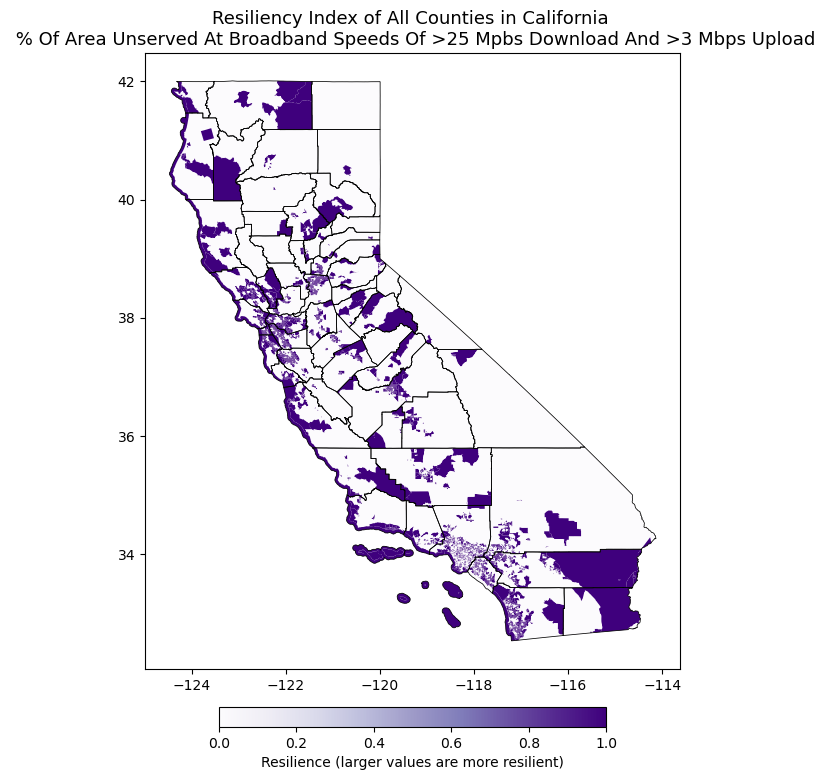

Plotting for column: # of cellular towers
Plot saved: plots_directory\number of cellular towers_plot.png


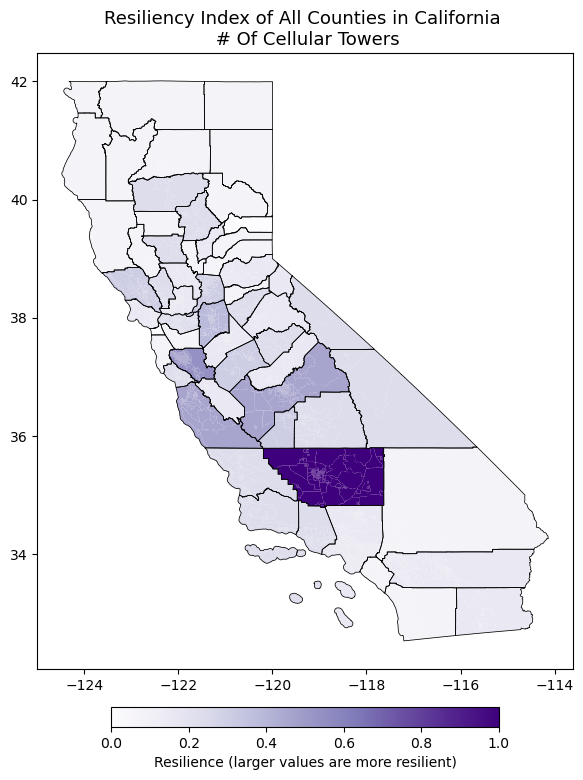

Plotting for column: % of underground transmission lines
Plot saved: plots_directory\percent of underground transmission lines_plot.png


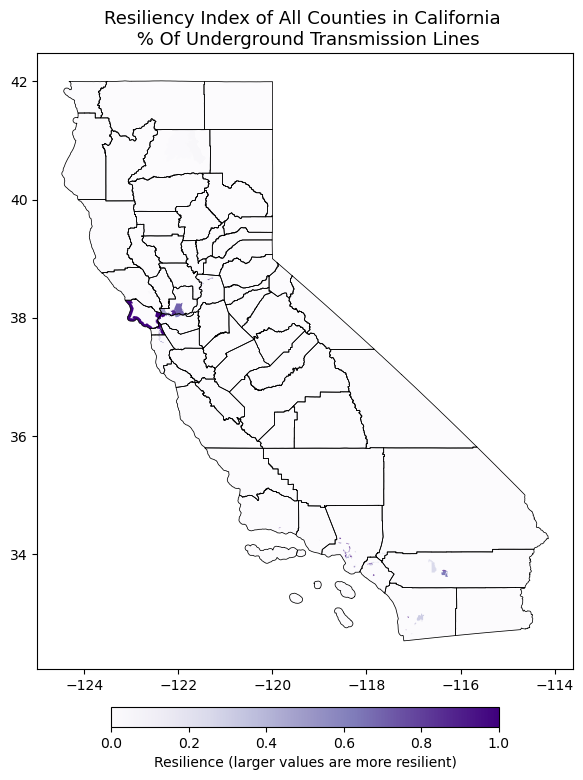

Plotting for column: % of homes built before 1980
Plot saved: plots_directory\percent of homes built before 1980_plot.png


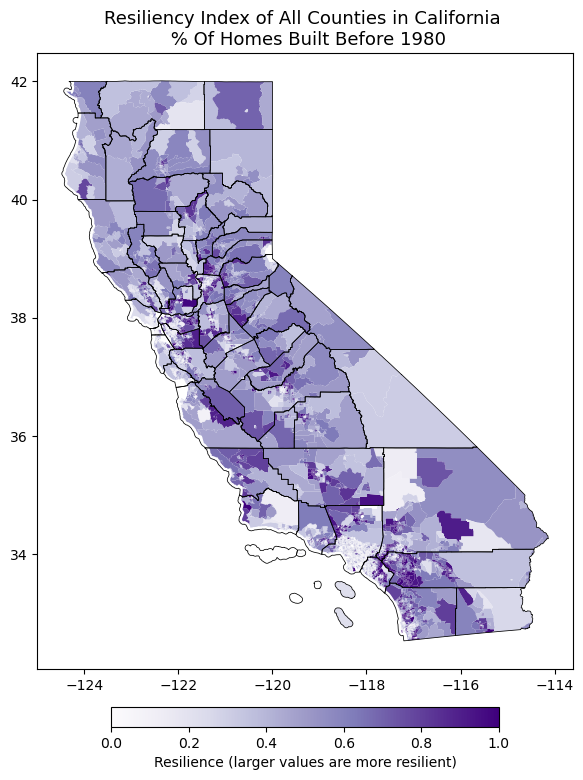

Plotting for column: % of mobile residential structures
Plot saved: plots_directory\percent of mobile residential structures_plot.png


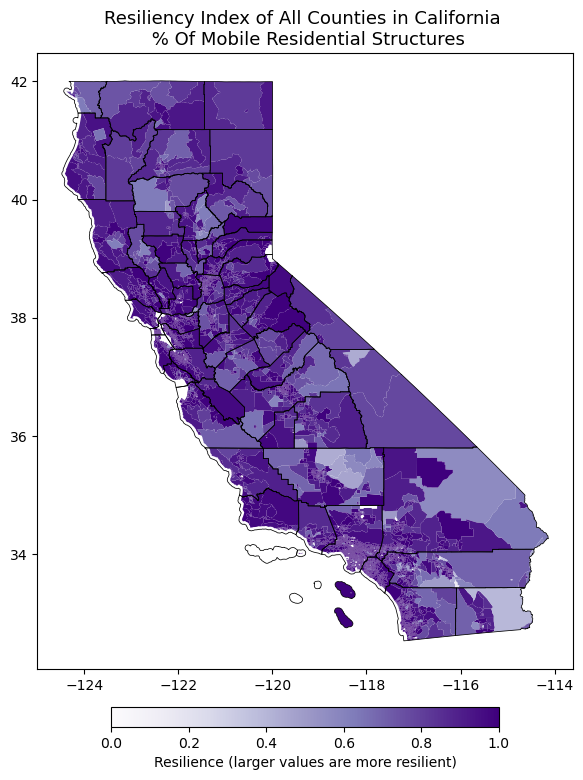

Plotting for column: % of homes lacking complete kitchen or plumbing facilities
Plot saved: plots_directory\percent of homes lacking complete kitchen or plumbing facilities_plot.png


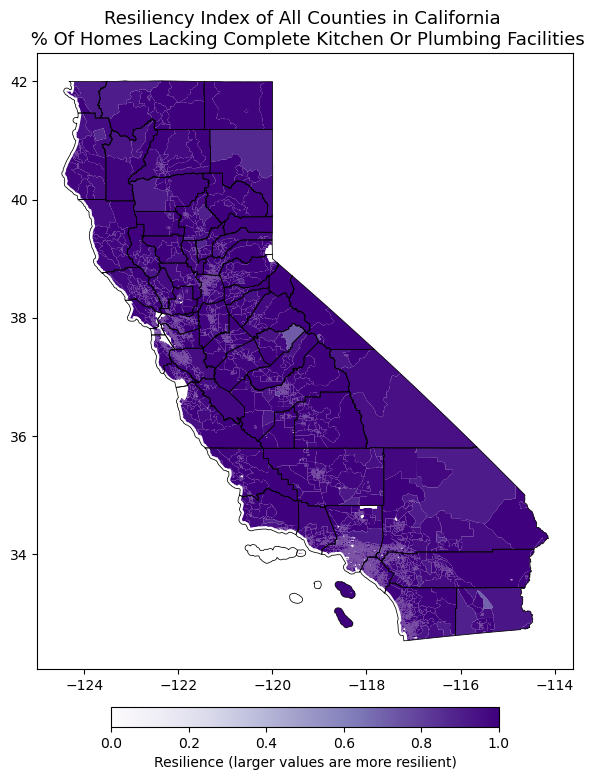

Plotting for column: # of vacant homes under ownership
Plot saved: plots_directory\number of vacant homes under ownership_plot.png


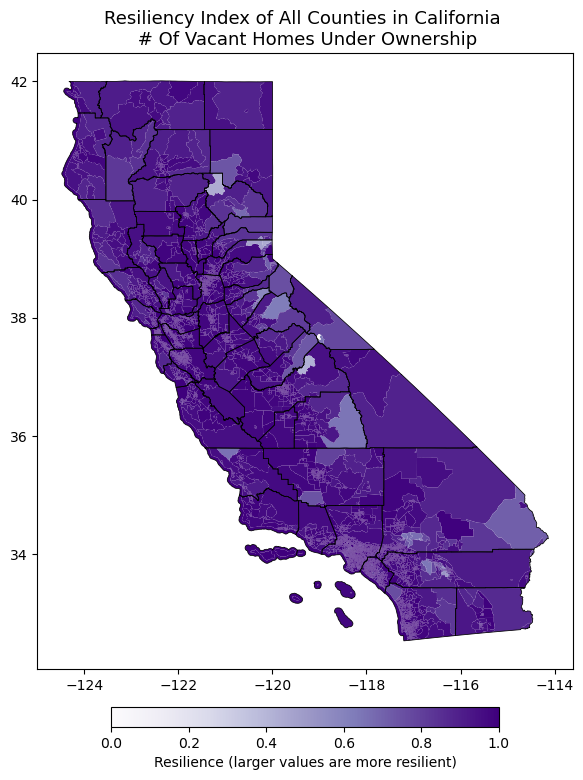

Plotting for column: # of microwave service towers
Plot saved: plots_directory\number of microwave service towers_plot.png


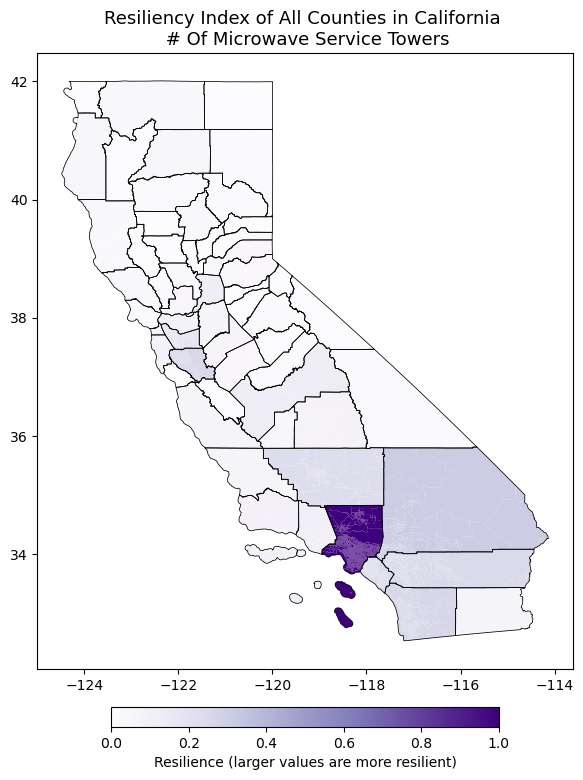

Plotting for column: # of mobile broadcast towers
Plot saved: plots_directory\number of mobile broadcast towers_plot.png


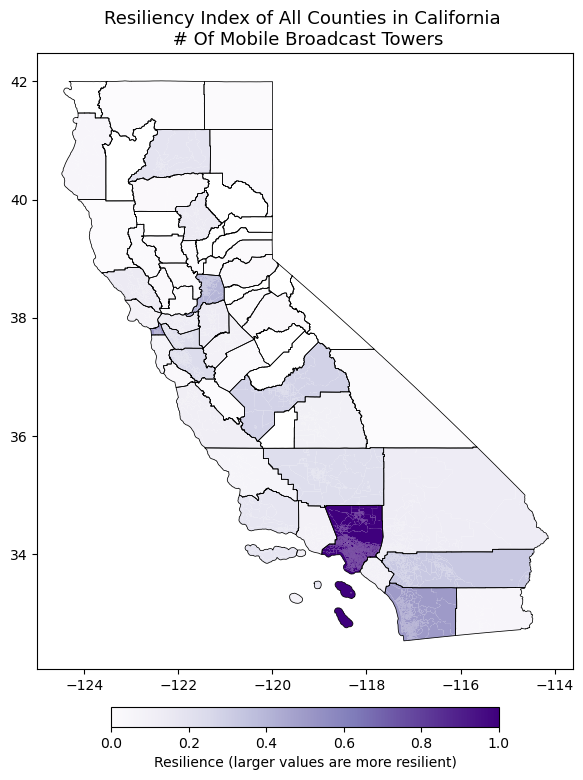

Plotting for column: # of paging transmission towers
Plot saved: plots_directory\number of paging transmission towers_plot.png


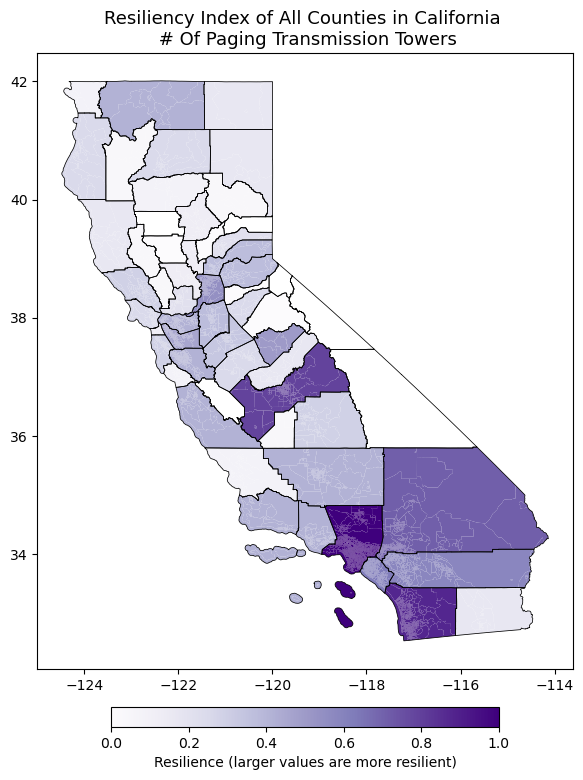

Plotting for column: # of power plants
Plot saved: plots_directory\number of power plants_plot.png


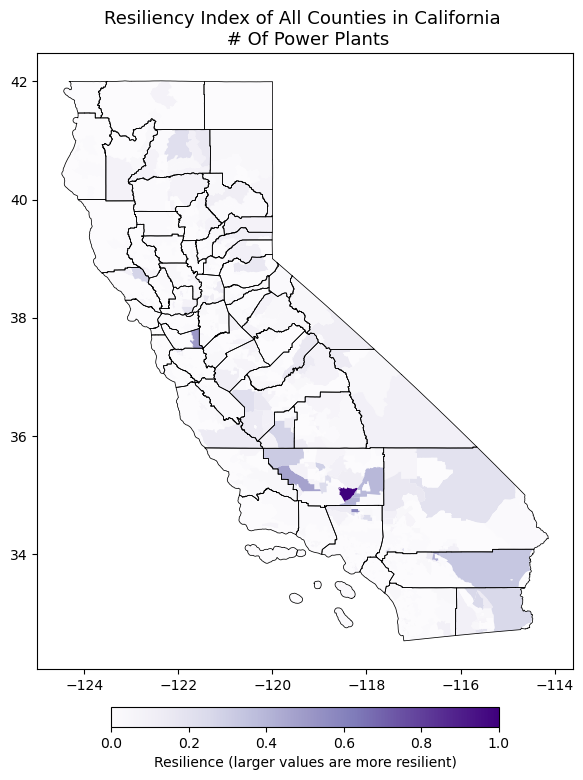

Plotting for column: average annual Public Safety Power Shutoff events 
Plot saved: plots_directory\average annual Public Safety Power Shutoff events _plot.png


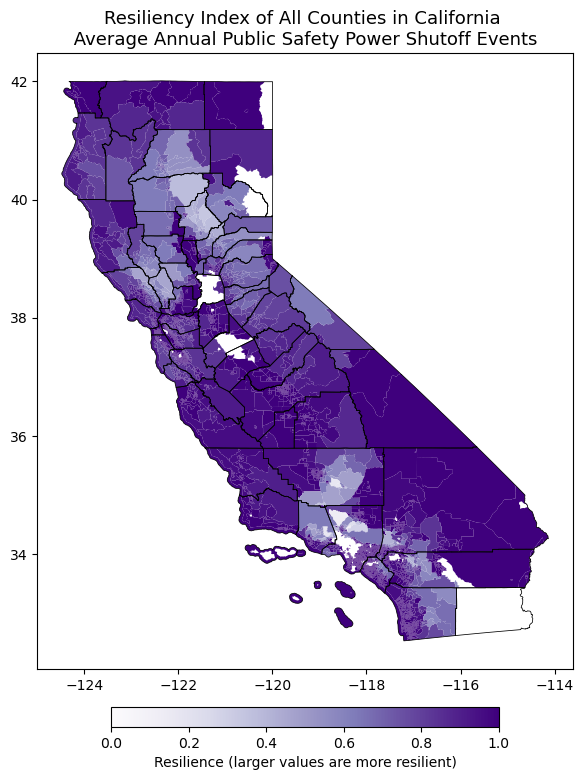

Plotting for column: # of radio transmission towers
Plot saved: plots_directory\number of radio transmission towers_plot.png


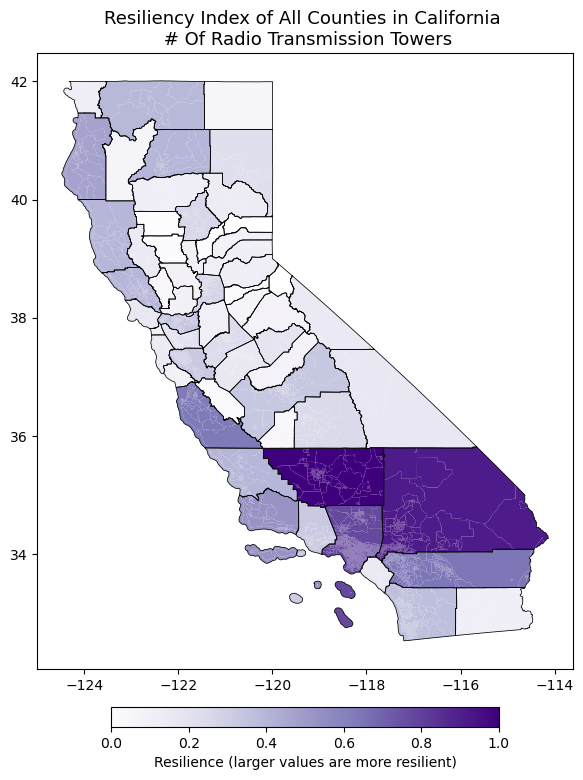

Plotting for column: # of public airports
Plot saved: plots_directory\number of public airports_plot.png


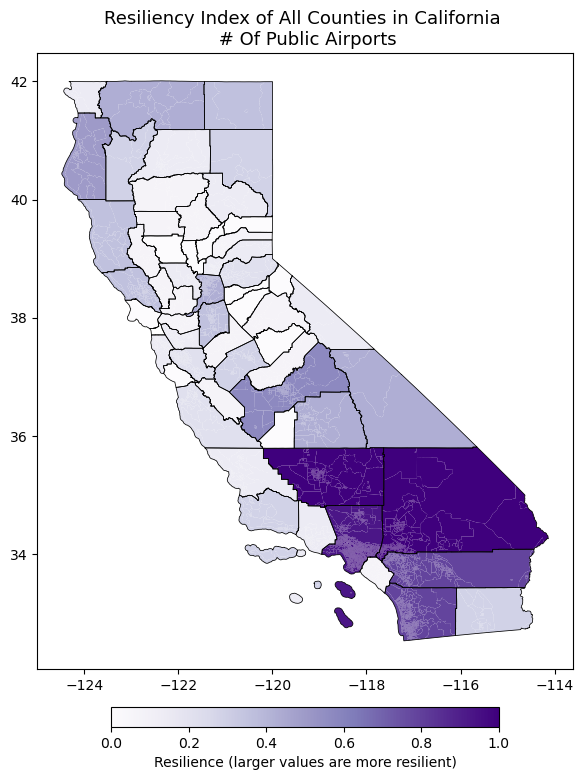

Plotting for column: # of heavy congestion areas
Plot saved: plots_directory\number of heavy congestion areas_plot.png


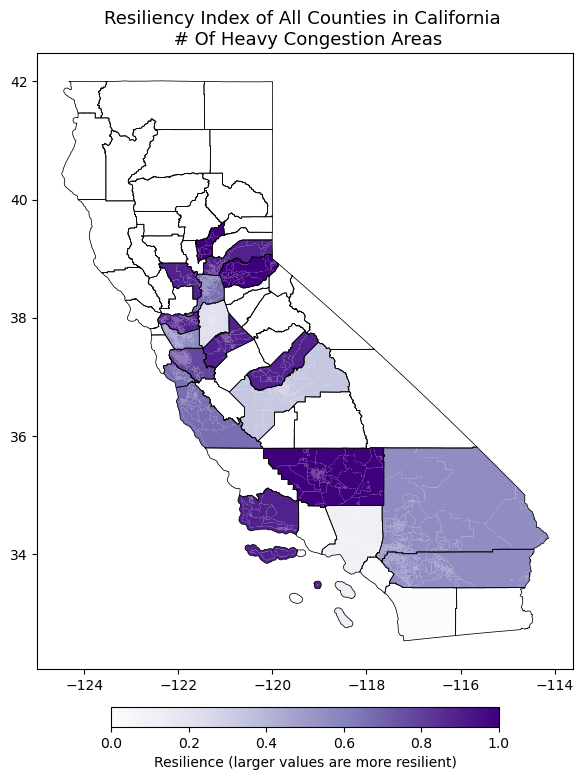

Plotting for column: # of bridges
Plot saved: plots_directory\number of bridges_plot.png


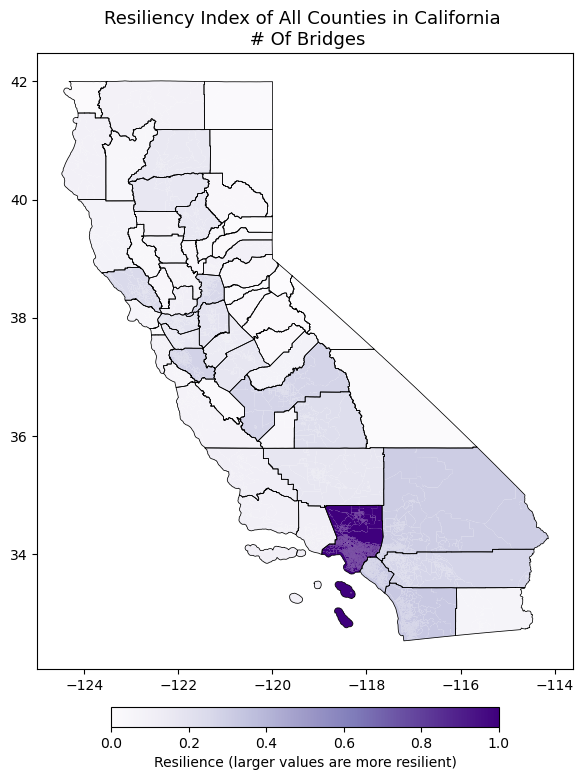

Plotting for column: # of miles of highway
Plot saved: plots_directory\number of miles of highway_plot.png


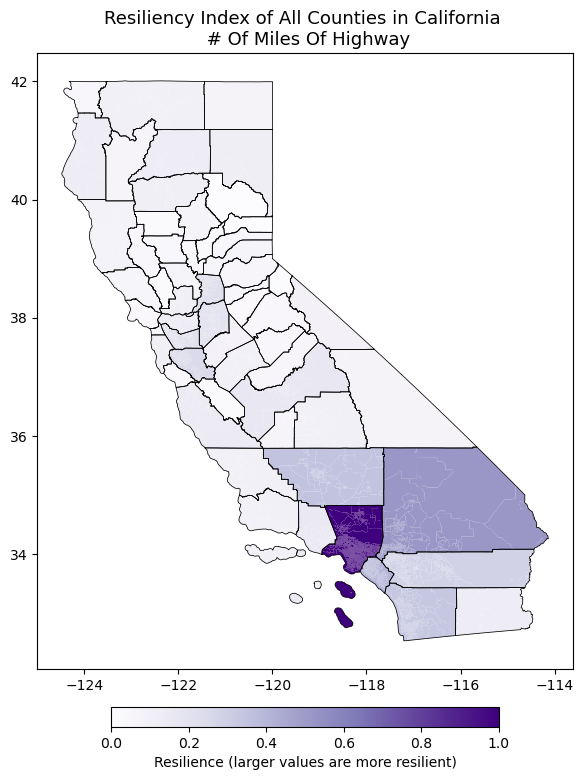

Plotting for column: # of miles of freight rail
Plot saved: plots_directory\number of miles of freight rail_plot.png


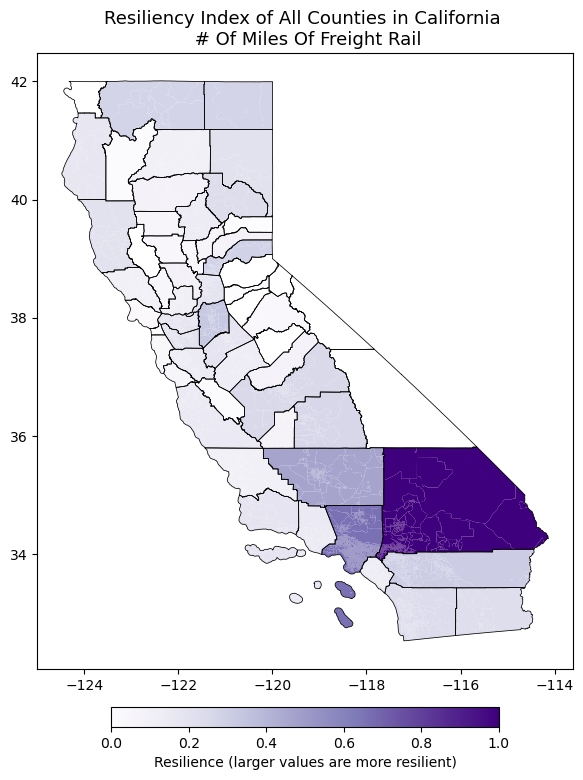

Plotting for column: # of broadcast service providers
Plot saved: plots_directory\number of broadcast service providers_plot.png


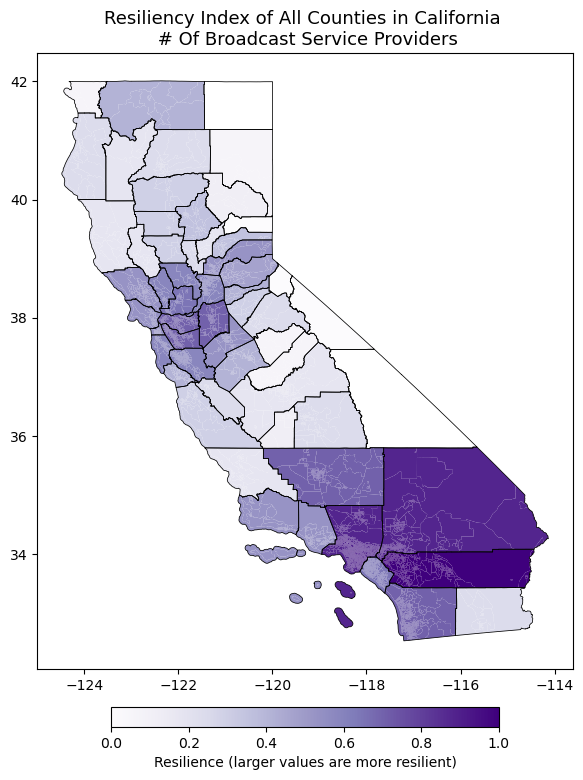

Plotting for column: # of wastewater treatment facilities
Plot saved: plots_directory\number of wastewater treatment facilities_plot.png


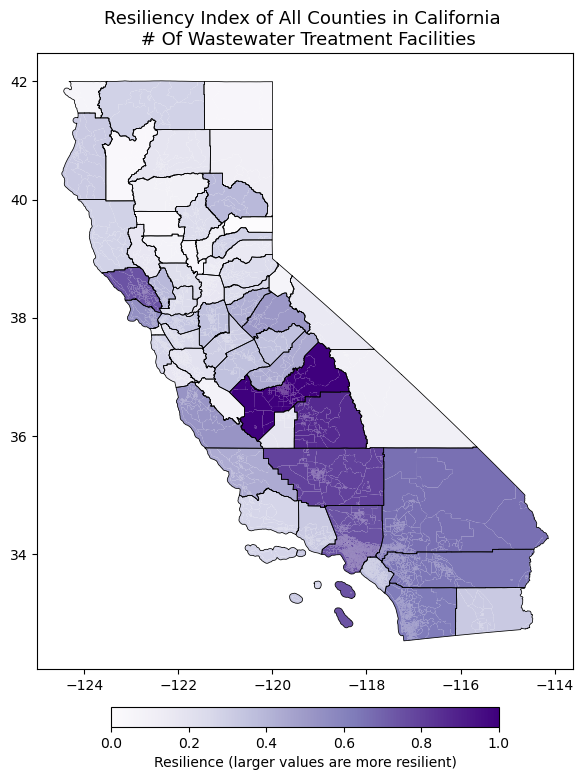

Plotting for column: average annual drought % coverage
Plot saved: plots_directory\average annual drought percent coverage_plot.png


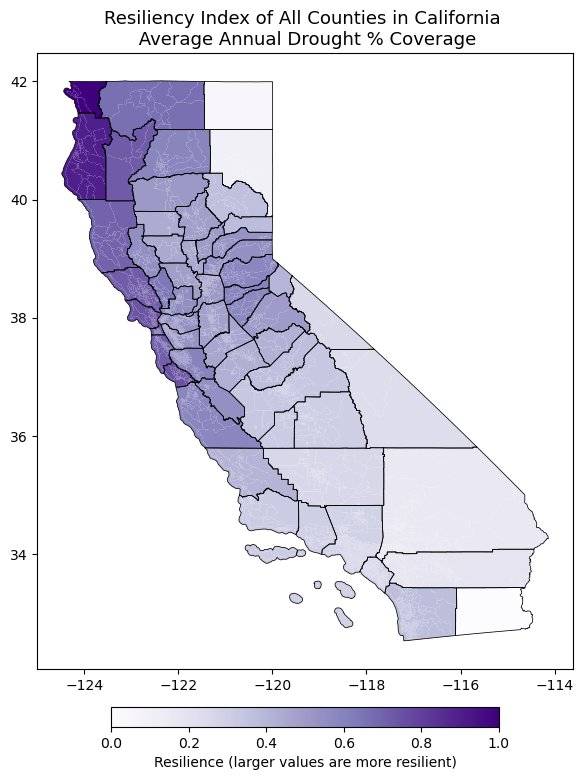

Plotting for column: average # of acres lost from heat per year
Plot saved: plots_directory\average number of acres lost from heat per year_plot.png


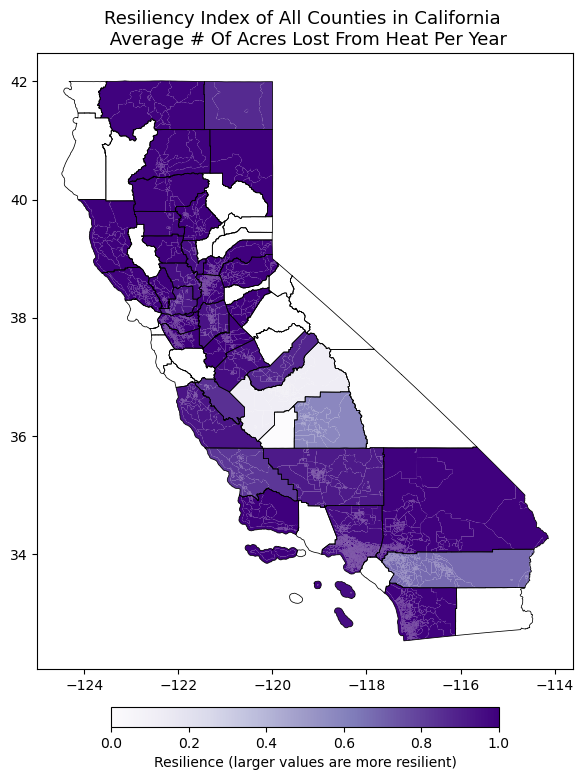

Plotting for column: average cost of crop lost from heat per year
Plot saved: plots_directory\average cost of crop lost from heat per year_plot.png


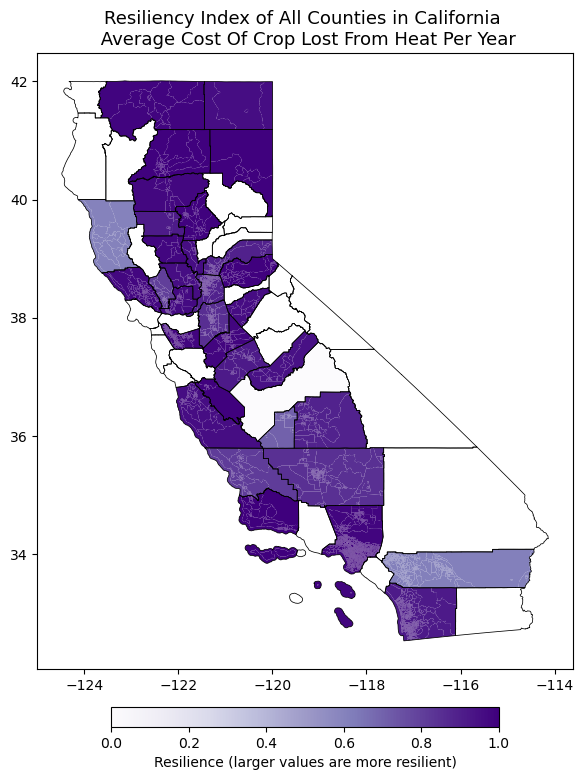

Plotting for column: % change in the number of drought years classified as having Moderate, Severe, or Extreme drought conditions via SPEI
Plot saved: plots_directory\percent change in the number of drought years classified as having Moderate, Severe, or Extreme drought conditions via SPEI_plot.png


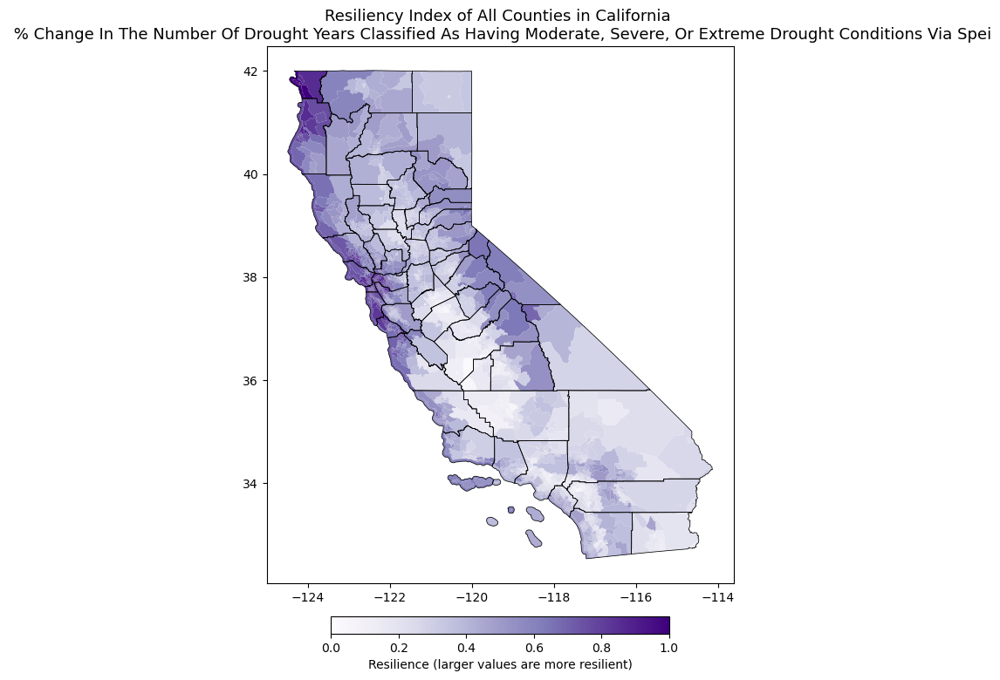

Plotting for column: total number of weeks in drought
Plot saved: plots_directory\total number of weeks in drought_plot.png


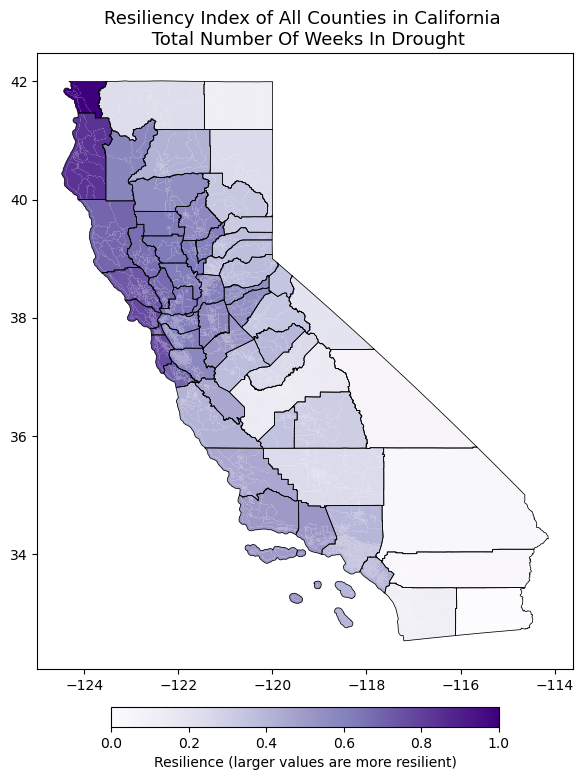

Plotting for column: mean annual change in extreme heat days
Plot saved: plots_directory\mean annual change in extreme heat days_plot.png


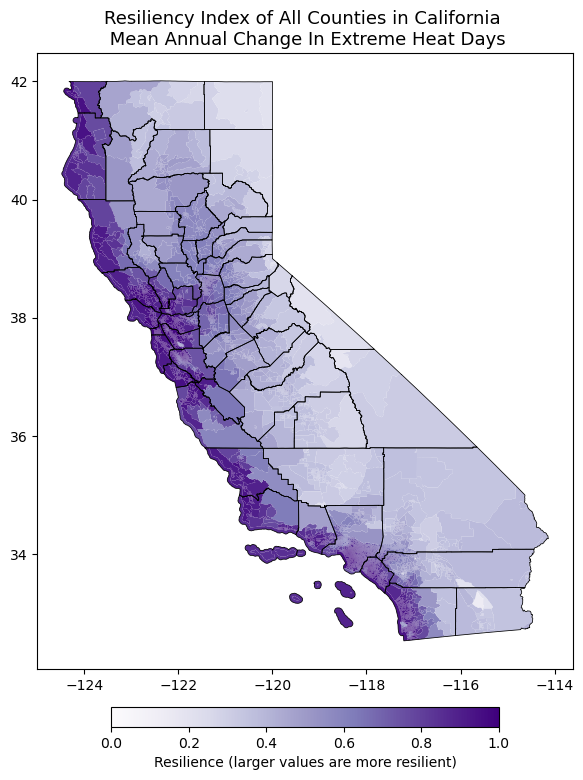

Plotting for column: mean annual change in warm nights
Plot saved: plots_directory\mean annual change in warm nights_plot.png


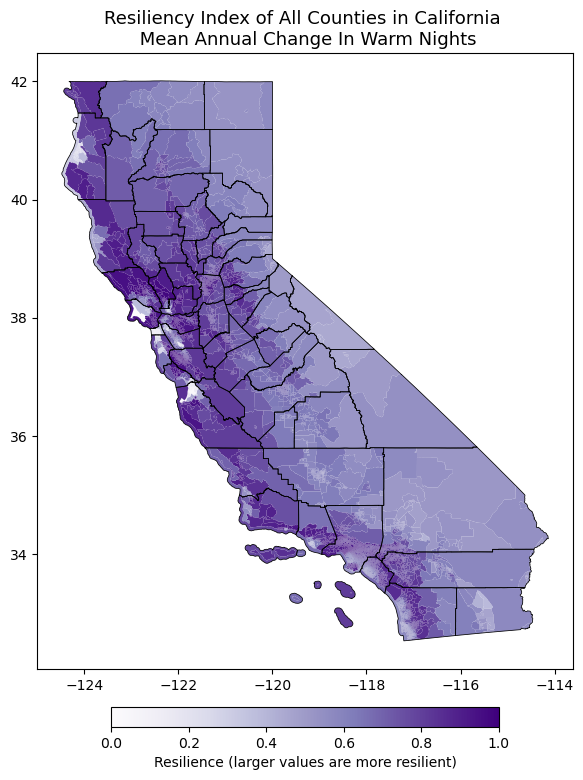

Plotting for column: % of area in 100 year floodplain
Plot saved: plots_directory\percent of area in 100 year floodplain_plot.png


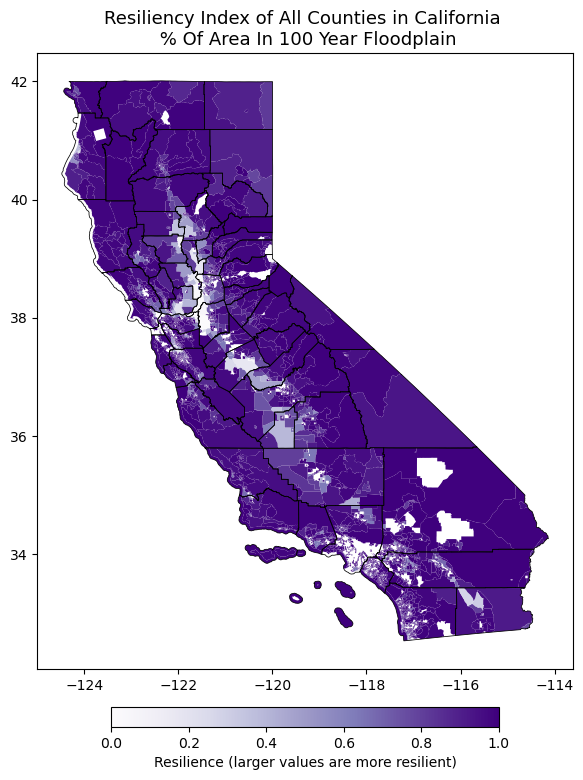

Plotting for column: average flood insurance claim payout per number of claims
Plot saved: plots_directory\average flood insurance claim payout per number of claims_plot.png


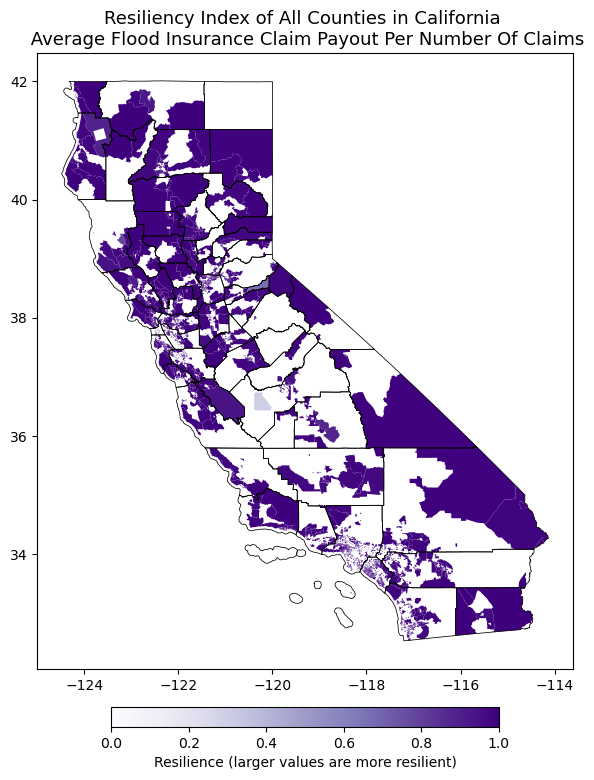

Plotting for column: estimated monetary crop damage
Plot saved: plots_directory\estimated monetary crop damage_plot.png


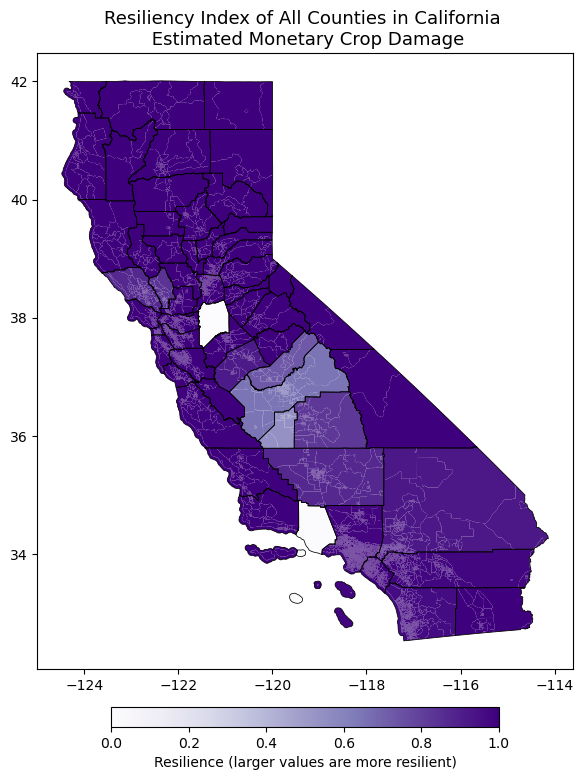

Plotting for column: absolute change in 99th percentile 1-day accumulated precipitation
Plot saved: plots_directory\absolute change in 99th percentile 1-day accumulated precipitation_plot.png


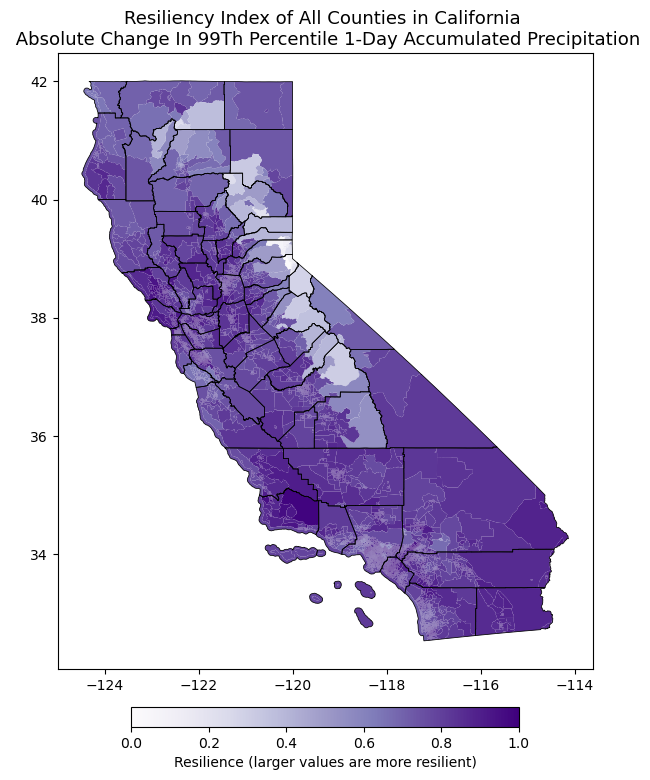

Plotting for column: absolute change in 99th percentile surface runoff
Plot saved: plots_directory\absolute change in 99th percentile surface runoff_plot.png


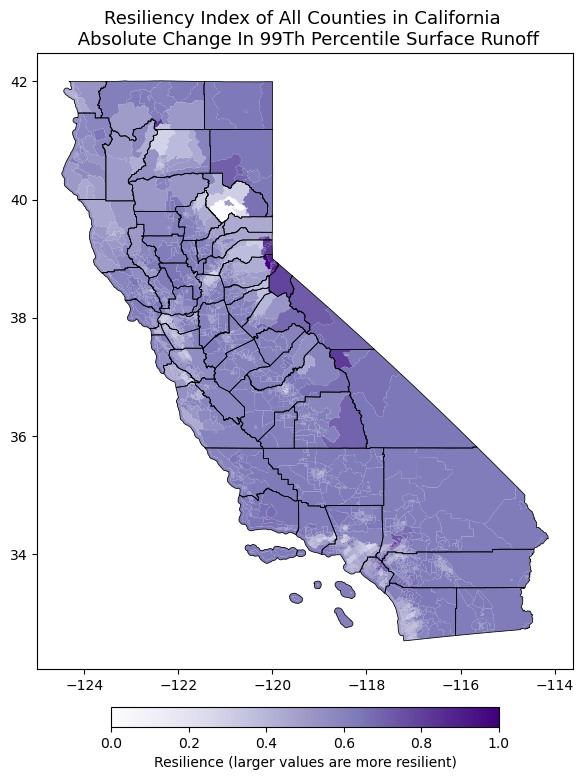

Plotting for column: # of direct flood/flash flood fatalities since 1996
Plot saved: plots_directory\number of direct flood_flash flood fatalities since 1996_plot.png


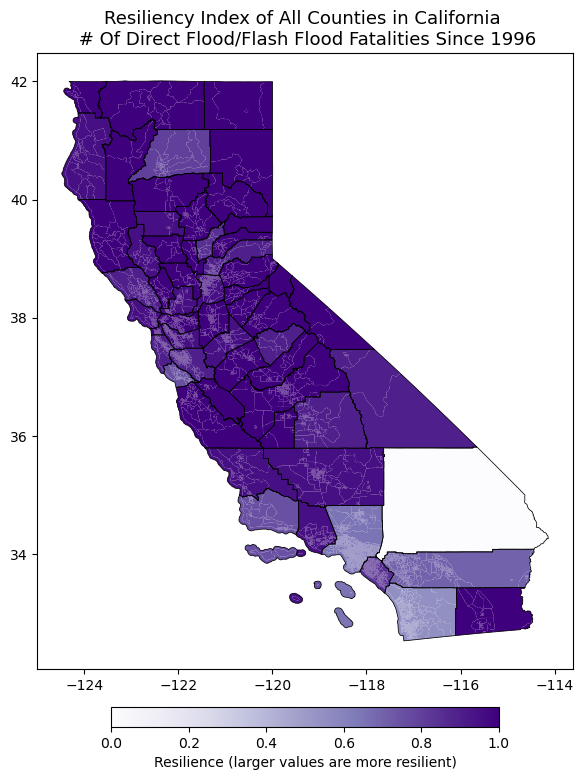

Plotting for column: median number of flood (including coastal and flash) warning days
Plot saved: plots_directory\median number of flood (including coastal and flash) warning days_plot.png


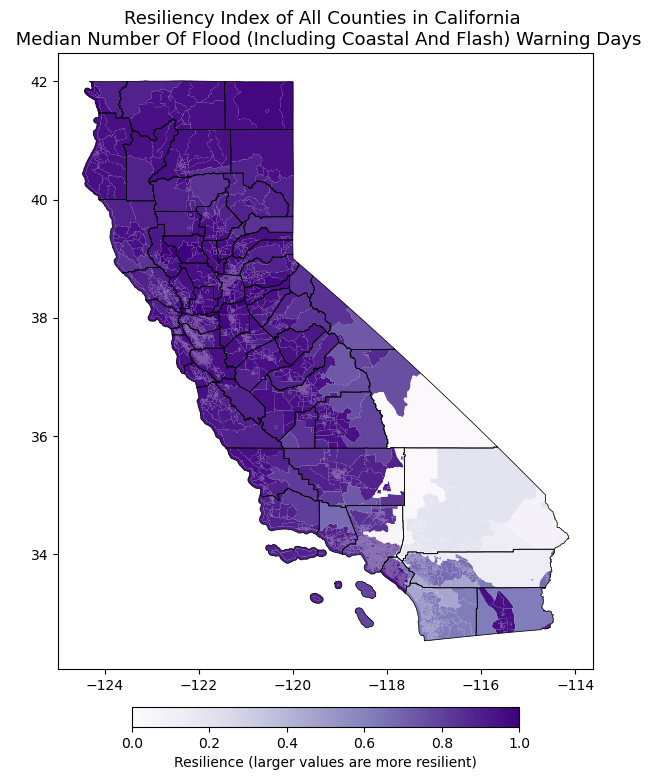

Plotting for column: mean annual change in cold days
Plot saved: plots_directory\mean annual change in cold days_plot.png


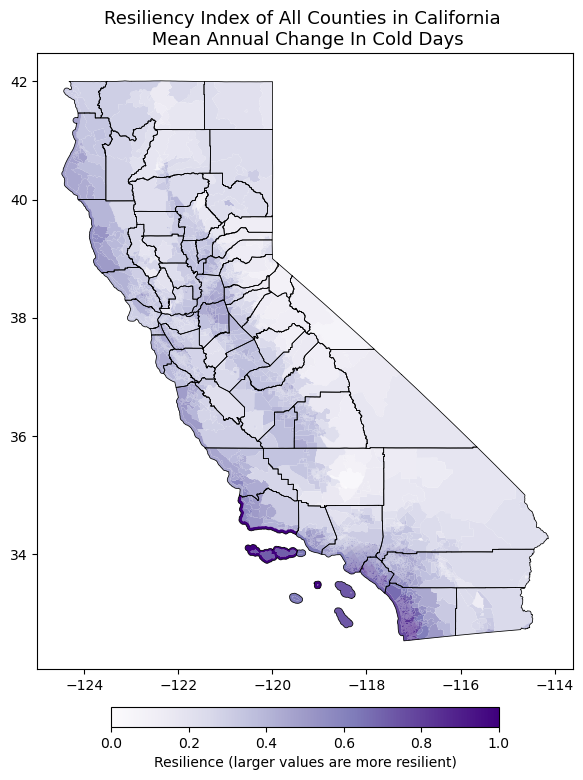

Plotting for column: average # of acres lost from drought per year
Plot saved: plots_directory\average number of acres lost from drought per year_plot.png


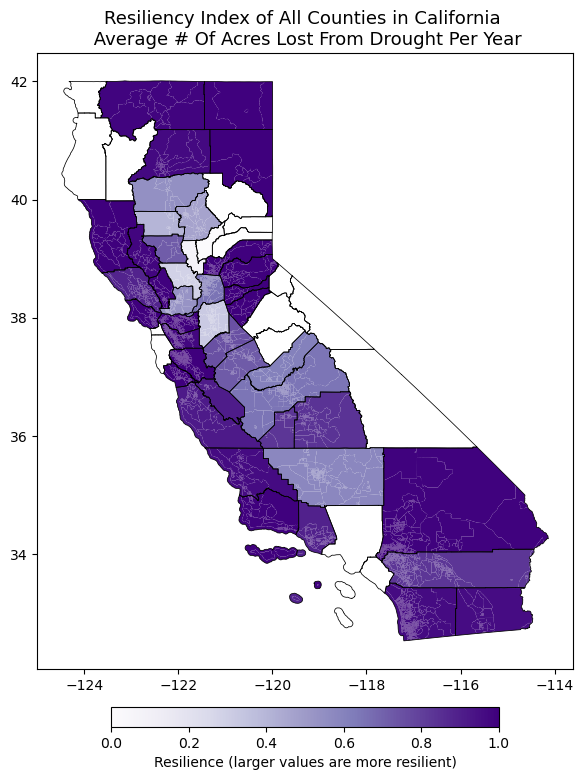

Plotting for column: average cost of crop loss from drought per year
Plot saved: plots_directory\average cost of crop loss from drought per year_plot.png


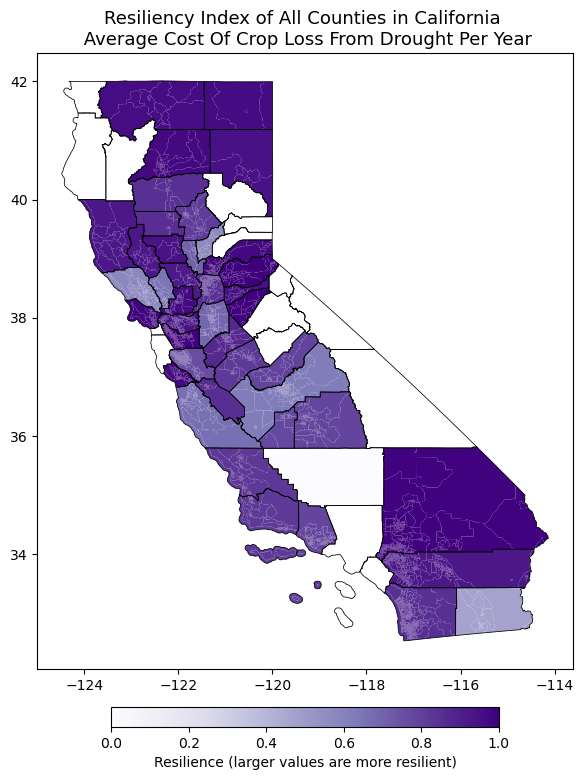

Plotting for column: average number of age adjusted heat related hospitalizations per 10,000
Plot saved: plots_directory\average number of age adjusted heat related hospitalizations per 10,000_plot.png


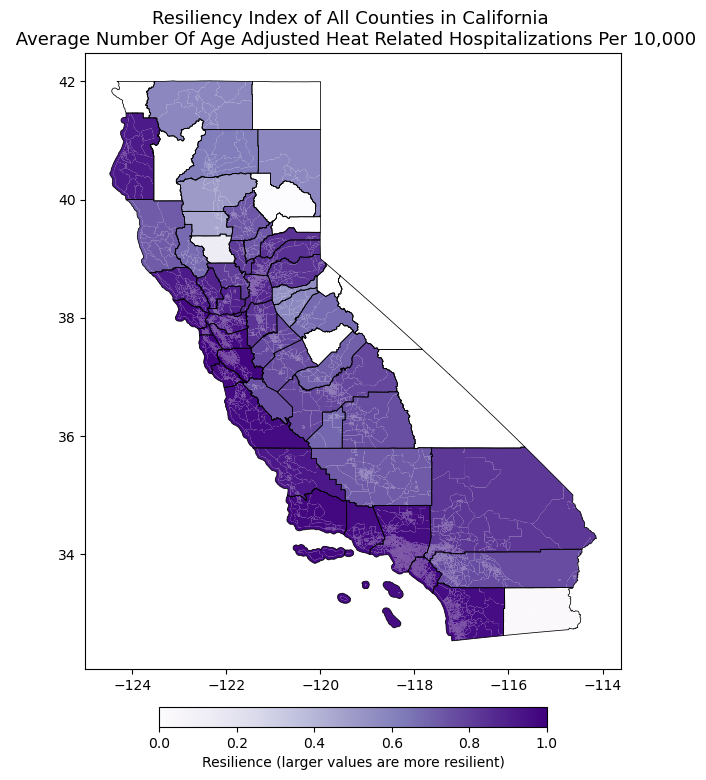

Plotting for column: median number of days with excessive heat warnings
Plot saved: plots_directory\median number of days with excessive heat warnings_plot.png


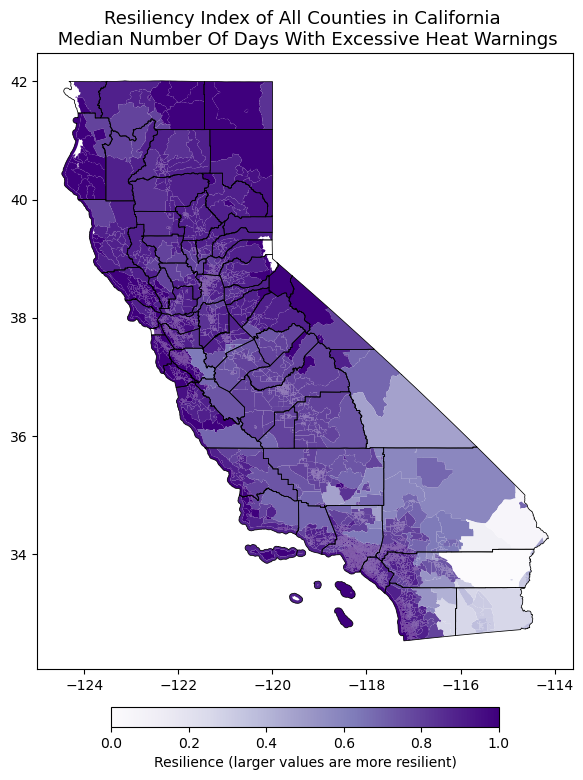

Plotting for column: monetary value of replacing buildings & contents
Plot saved: plots_directory\monetary value of replacing buildings & contents_plot.png


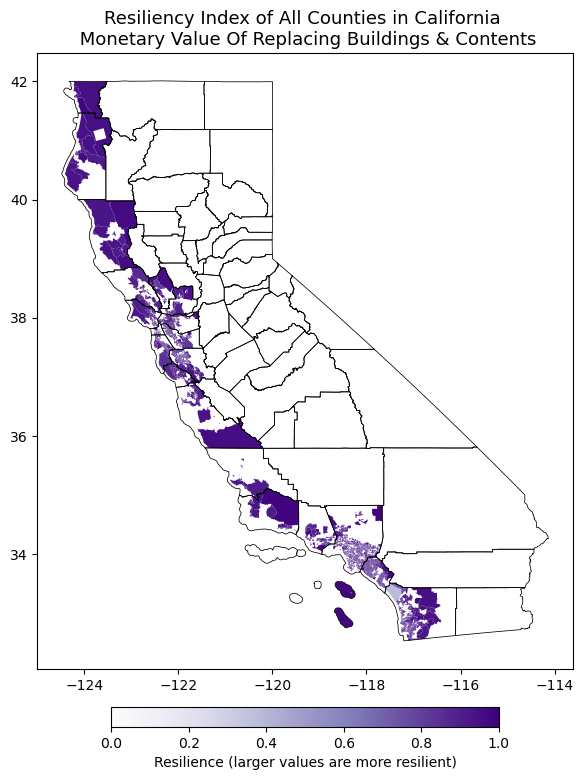

Plotting for column: change in number of fire stations vulnerable to sea level rise between baseline and 1.4m rise conditions
Plot saved: plots_directory\change in number of fire stations vulnerable to sea level rise between baseline and 1.4m rise conditions_plot.png


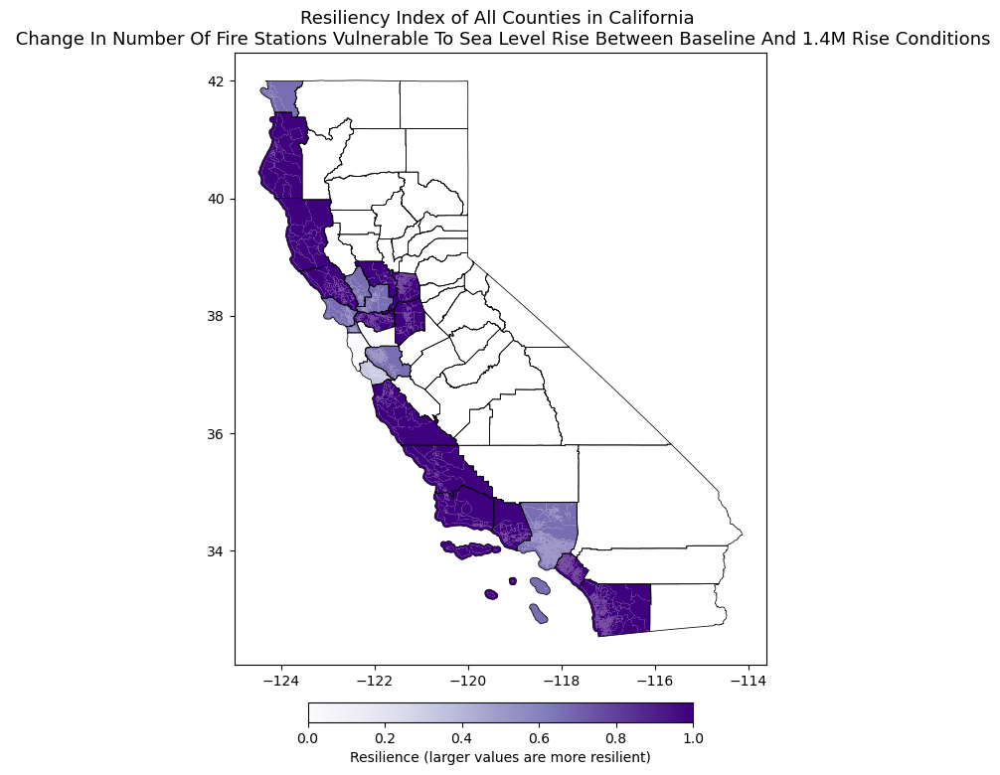

Plotting for column: change in number of hospitals vulnerable to sea level rise between baseline and 1.4m rise conditions
Plot saved: plots_directory\change in number of hospitals vulnerable to sea level rise between baseline and 1.4m rise conditions_plot.png


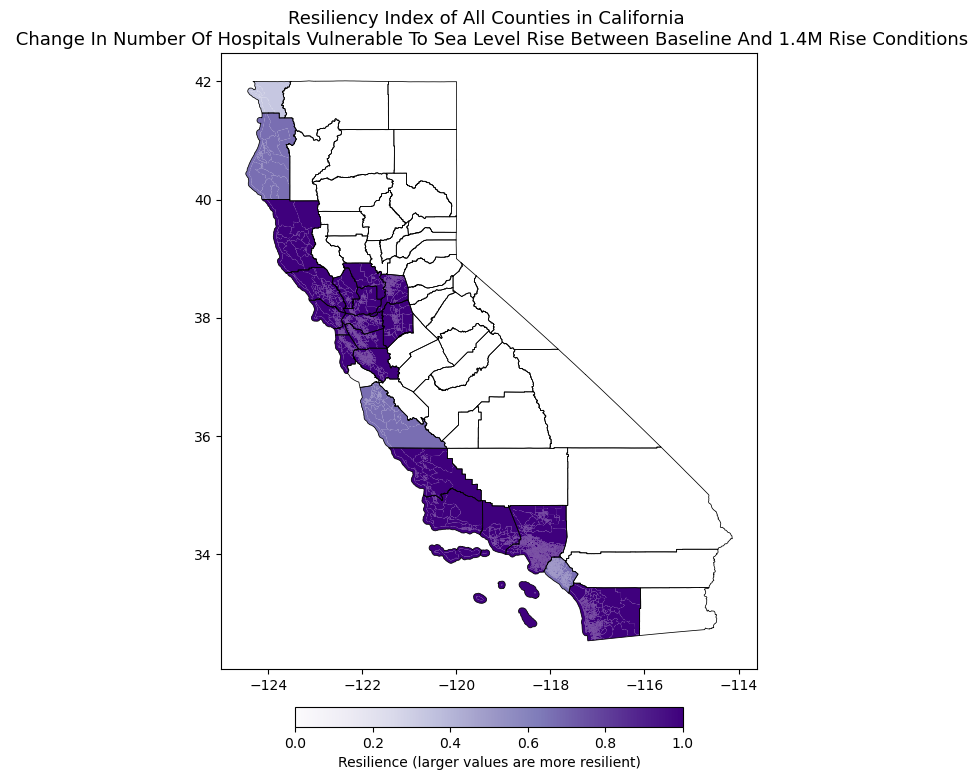

Plotting for column: change in number of police stations vulnerable to sea level rise between baseline and 1.4m rise conditions
Plot saved: plots_directory\change in number of police stations vulnerable to sea level rise between baseline and 1.4m rise conditions_plot.png


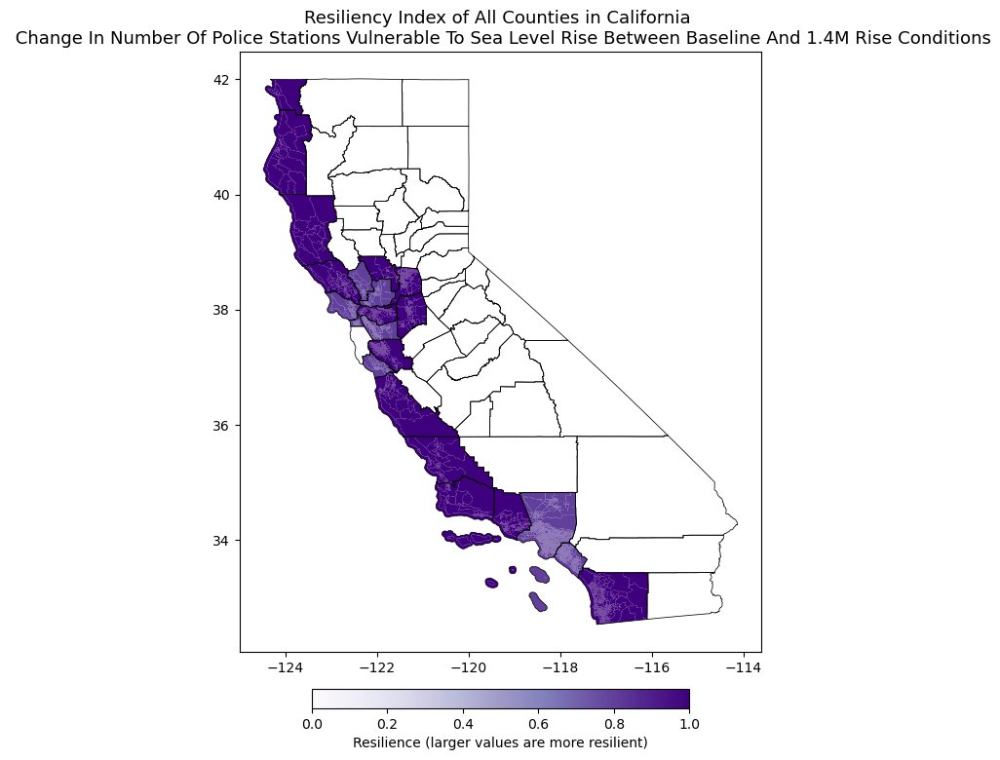

Plotting for column: change in number of schools vulnerable to sea level rise between baseline and 1.4m rise conditions
Plot saved: plots_directory\change in number of schools vulnerable to sea level rise between baseline and 1.4m rise conditions_plot.png


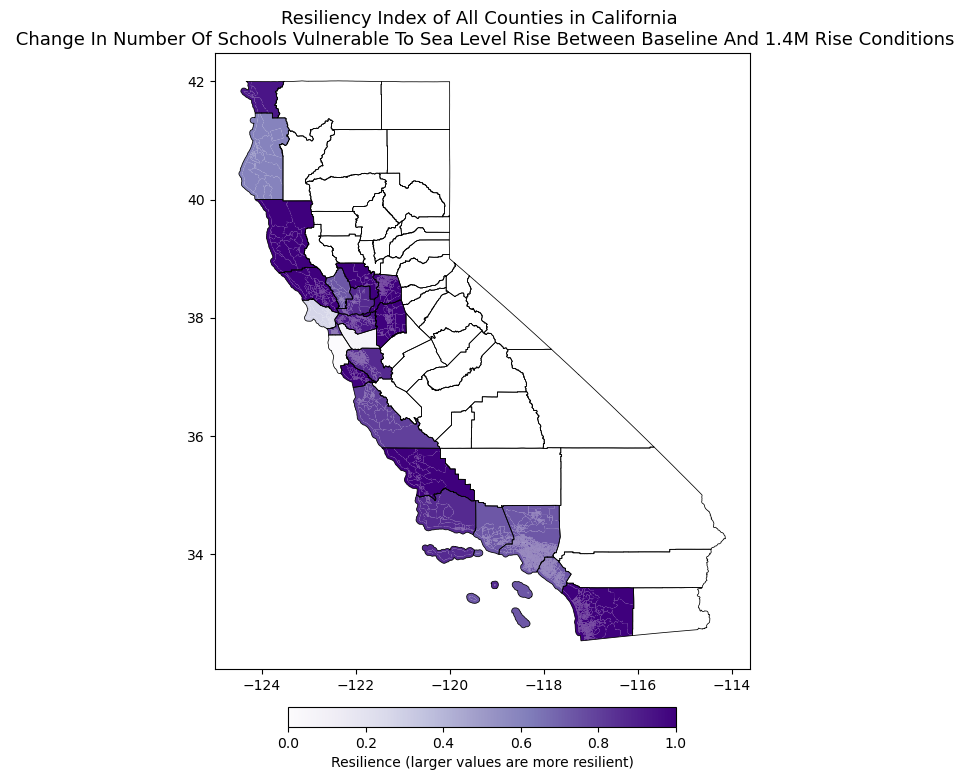

Plotting for column: # of exposed buildings to sea level rise
Plot saved: plots_directory\number of exposed buildings to sea level rise_plot.png


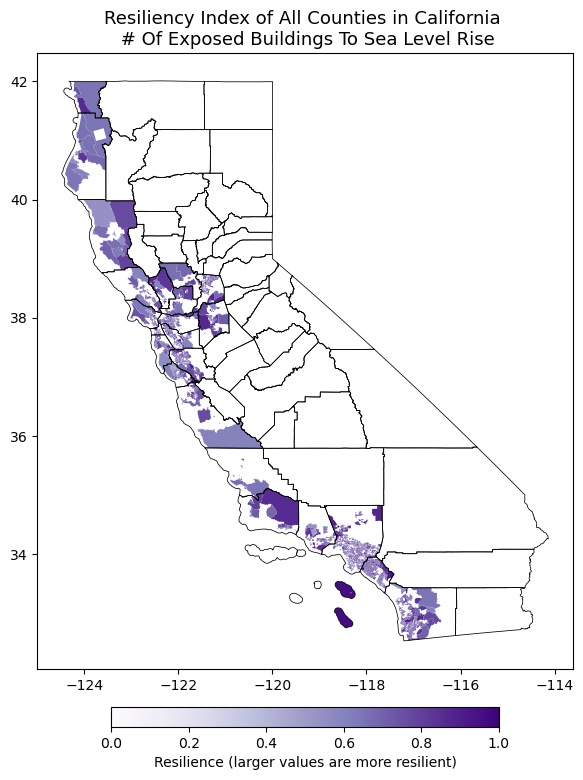

Plotting for column: percent change in slr tract vulnerablility between 2000 and 2100
Plot saved: plots_directory\percent change in slr tract vulnerablility between 2000 and 2100_plot.png


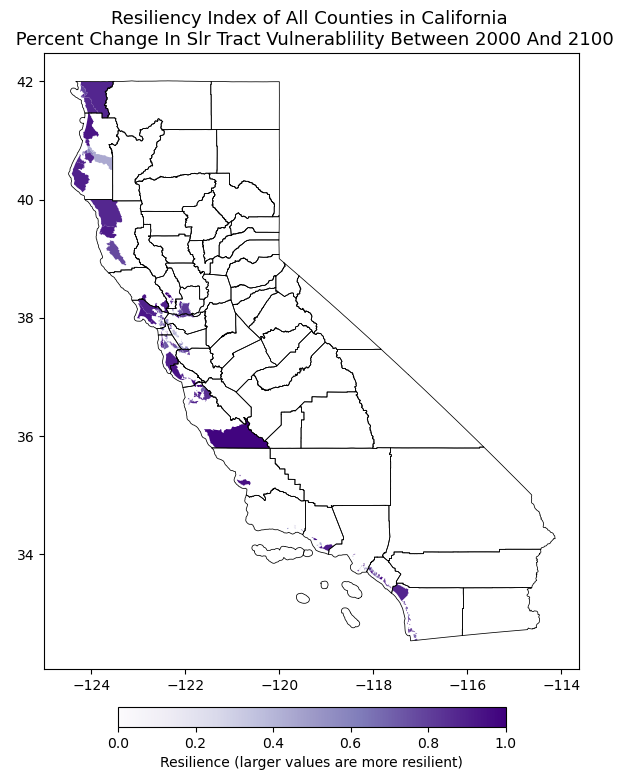

Plotting for column: # of wastewater treatment plants vulnerable to sea level rise under 1.4m rise conditions
Plot saved: plots_directory\number of wastewater treatment plants vulnerable to sea level rise under 1.4m rise conditions_plot.png


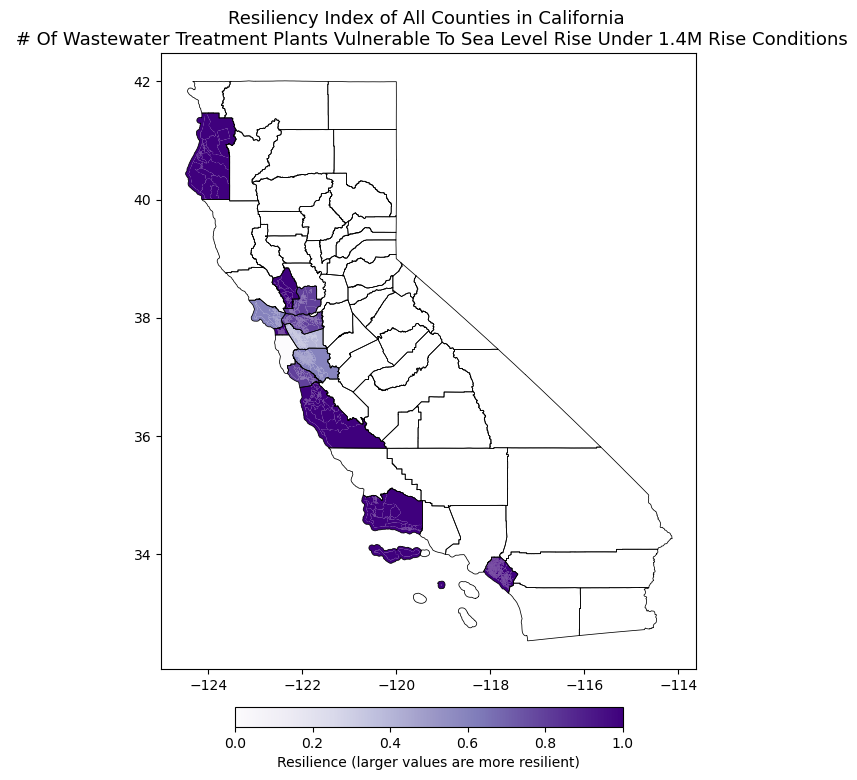

Plotting for column: counties projected to lose > 10% wetland habitat by 2100 under "full coastal development" predictions
Plot saved: plots_directory\counties projected to lose greater than 10percent wetland habitat by 2100 under _full coastal development_ predictions_plot.png


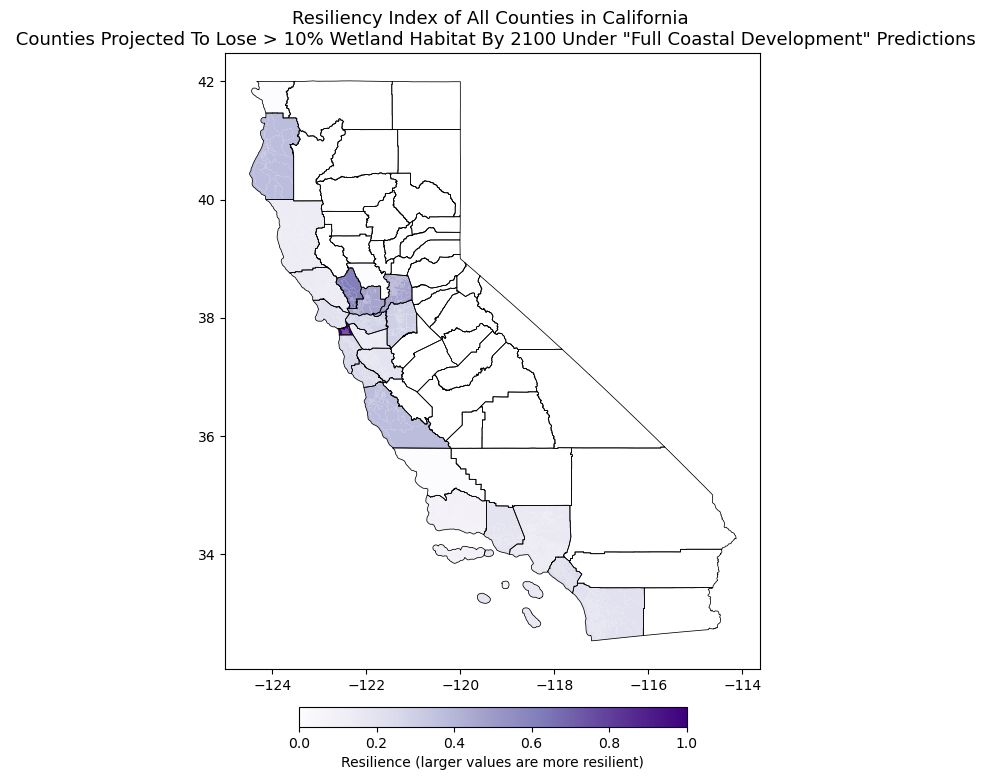

Plotting for column: change in total area burned per year
Plot saved: plots_directory\change in total area burned per year_plot.png


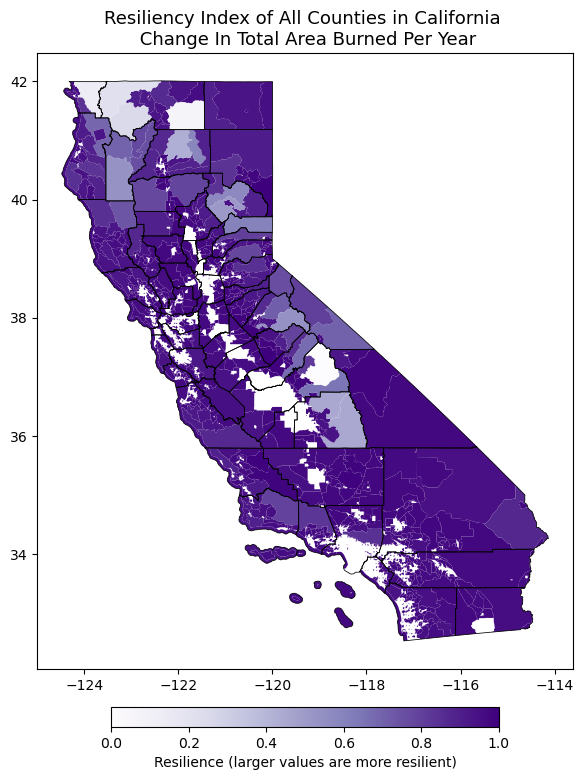

Plotting for column: change in median annual # of days with Fosberg Fire Weather Index value 50 and greater
Plot saved: plots_directory\change in median annual number of days with Fosberg Fire Weather Index value 50 and greater_plot.png


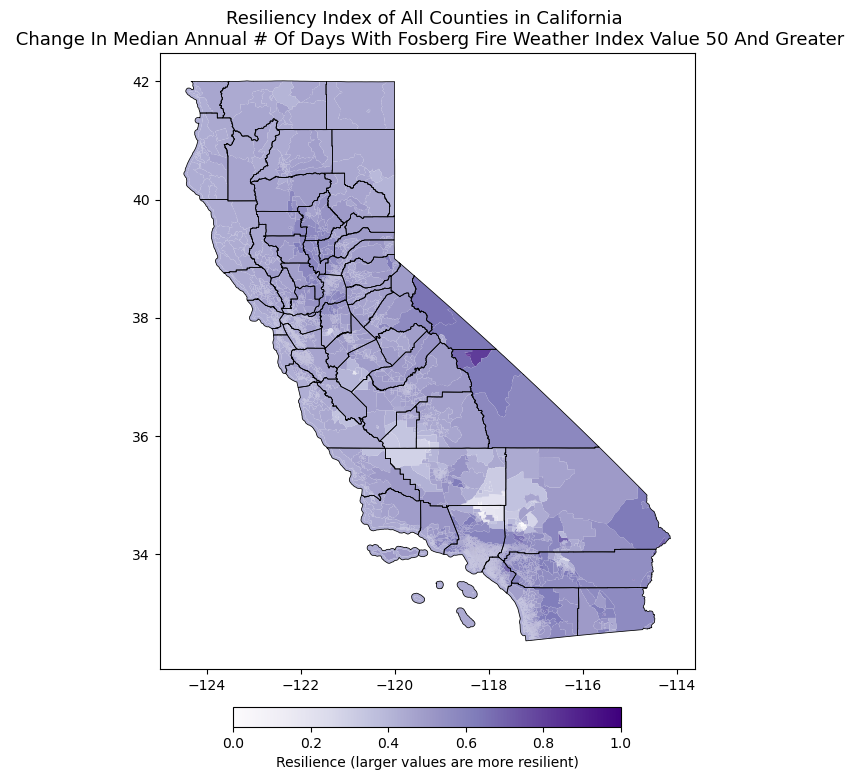

Plotting for column: # of buildings destroyed/damaged from wildfire per year
Plot saved: plots_directory\number of buildings destroyed_damaged from wildfire per year_plot.png


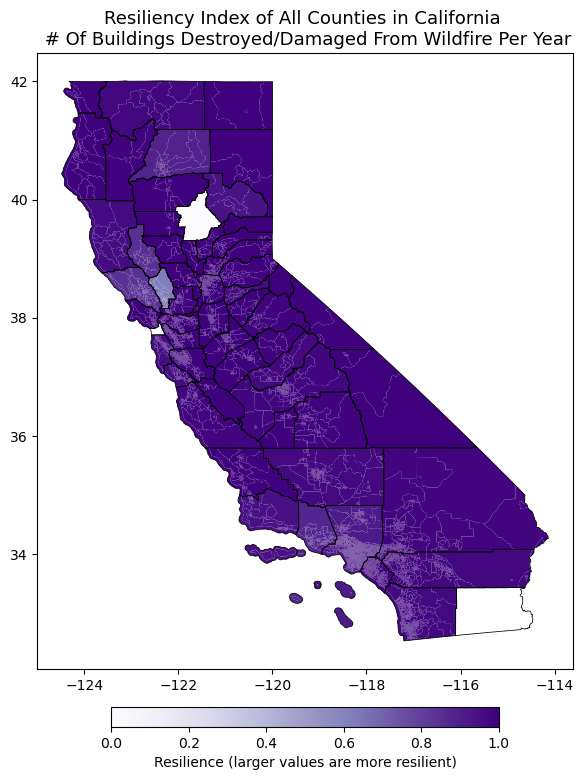

Plotting for column: # of fatalities from wildfire per year
Plot saved: plots_directory\number of fatalities from wildfire per year_plot.png


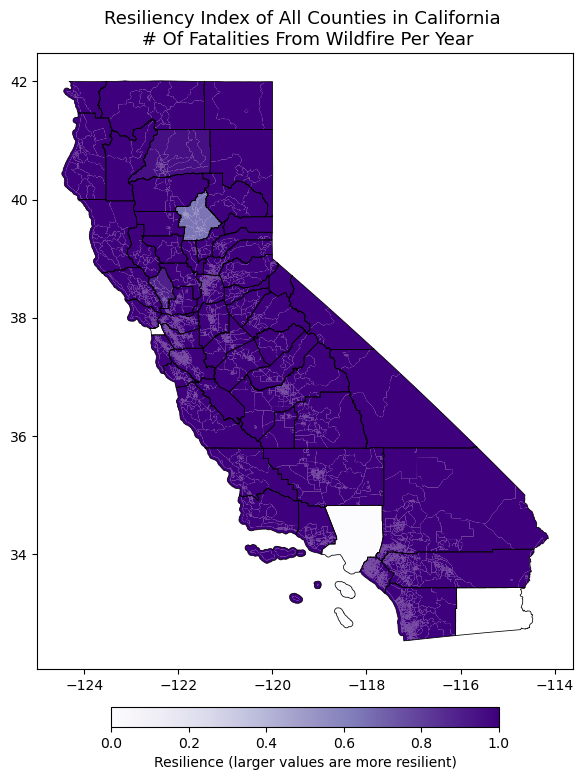

Plotting for column: median annual # of days with red flag warnings
Plot saved: plots_directory\median annual number of days with red flag warnings_plot.png


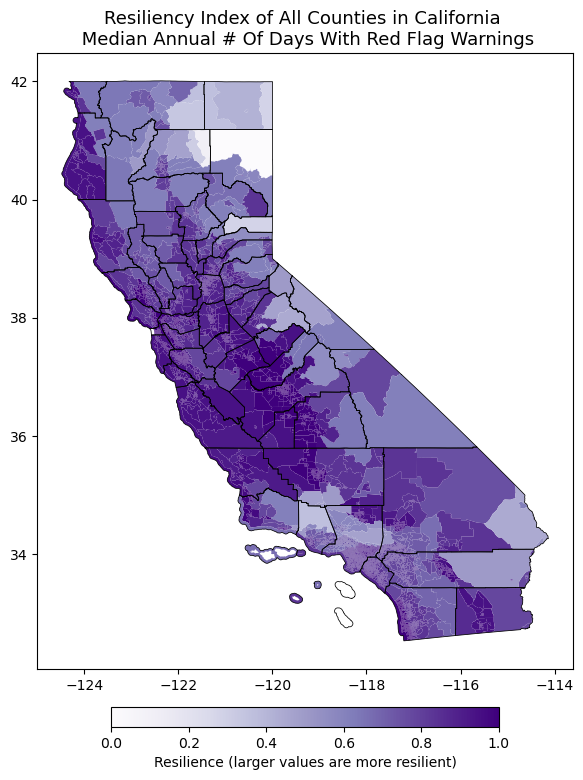

Plotting for column: enrollment in national flood insurance program
Plot saved: plots_directory\enrollment in national flood insurance program_plot.png


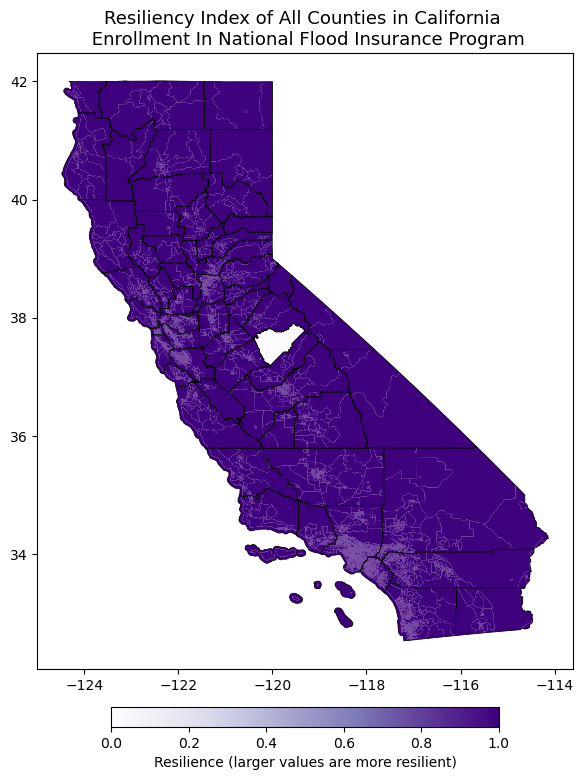

Plotting for column: total amount of funding received 2014-2022
Plot saved: plots_directory\total amount of funding received 2014-2022_plot.png


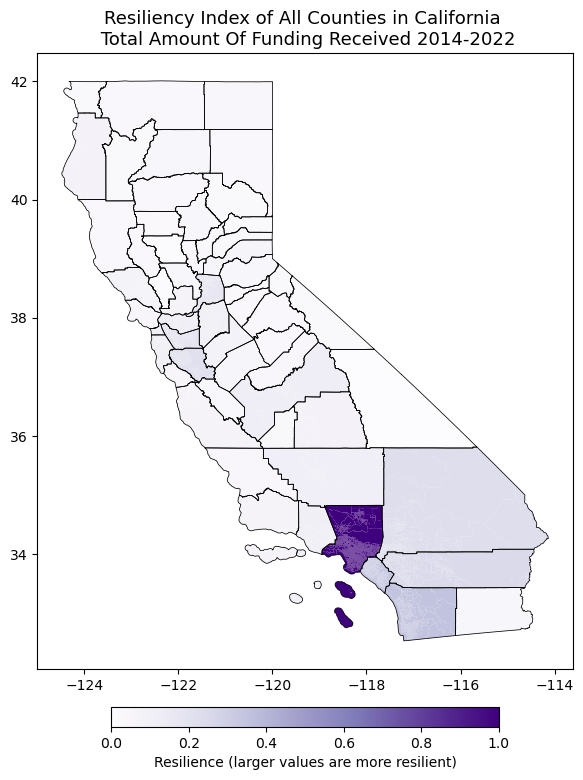

Plotting for column: # of paramedics and emergency medical technicians per 10,000 people
Plot saved: plots_directory\number of paramedics and emergency medical technicians per 10,000 people_plot.png


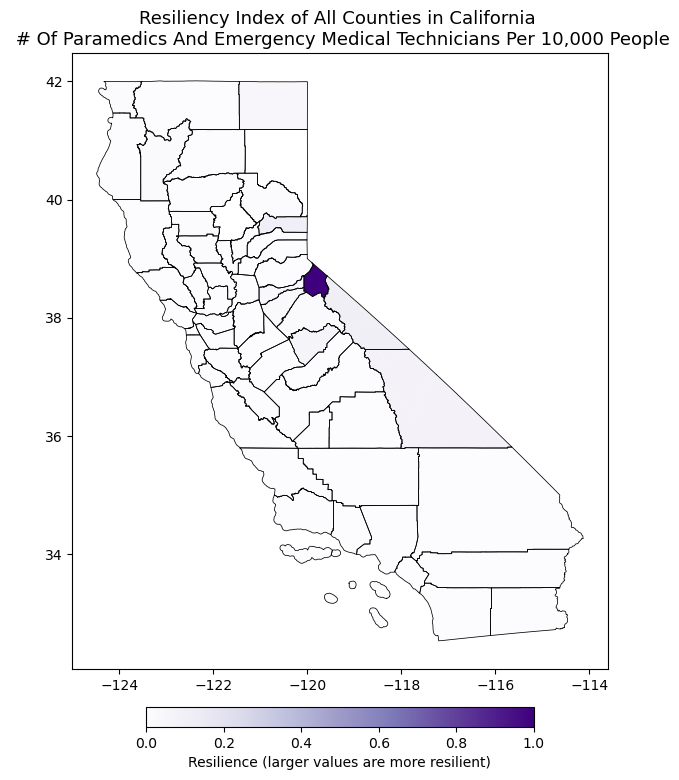

Plotting for column: # of firefighters per 10,000 people
Plot saved: plots_directory\number of firefighters per 10,000 people_plot.png


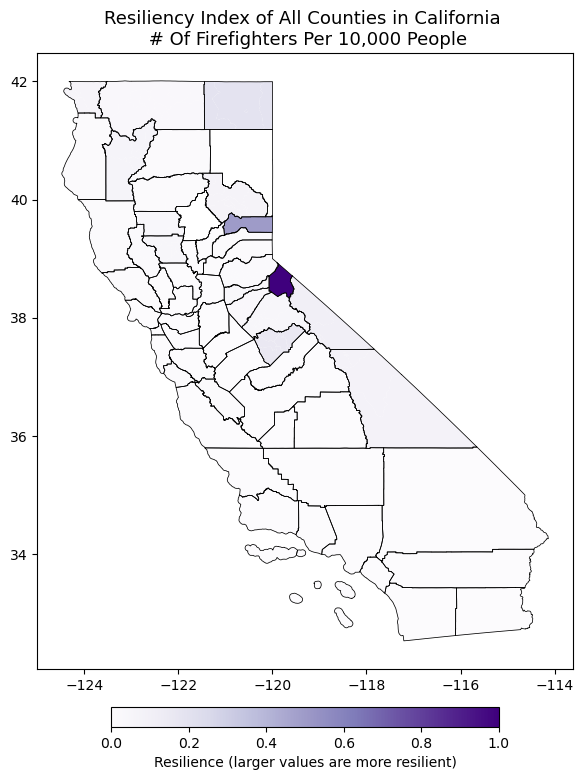

Plotting for column: # of fire stations per 10,000 people
Plot saved: plots_directory\number of fire stations per 10,000 people_plot.png


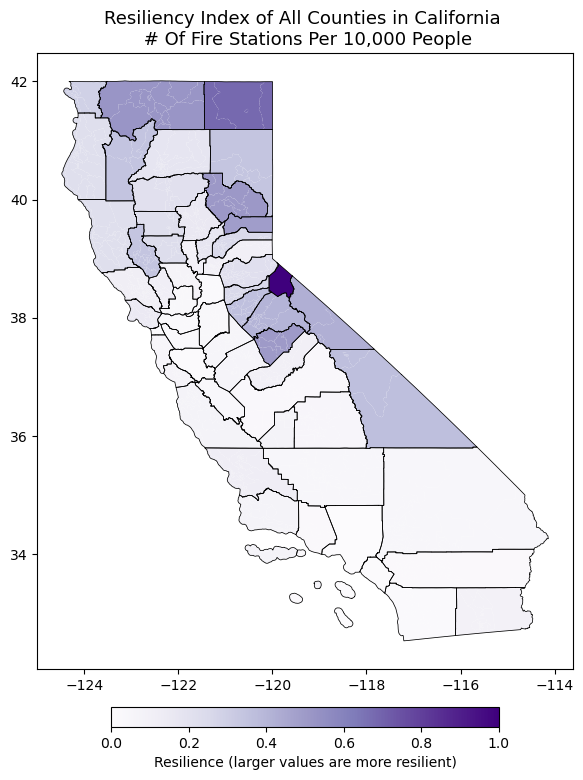

Plotting for column: # of national flood insurance program participants
Plot saved: plots_directory\number of national flood insurance program participants_plot.png


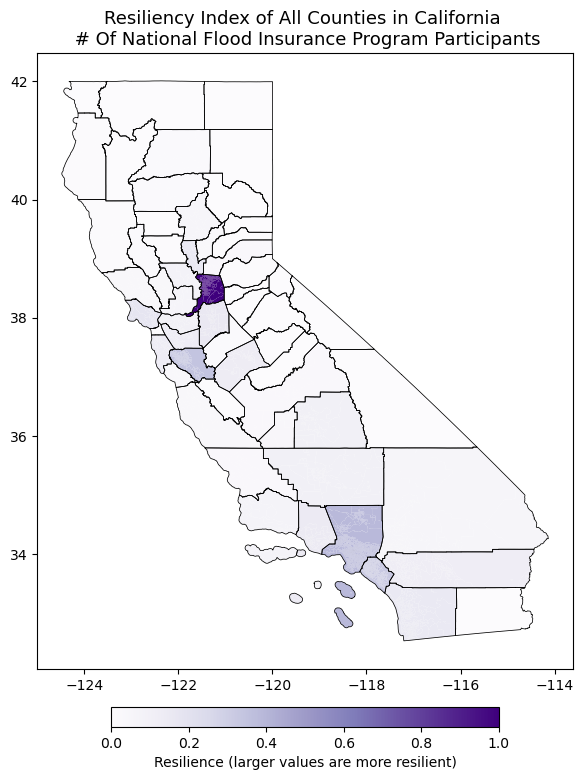

Plotting for column: total amount of hazard mitigation funding recieved between 1990-2023
Plot saved: plots_directory\total amount of hazard mitigation funding recieved between 1990-2023_plot.png


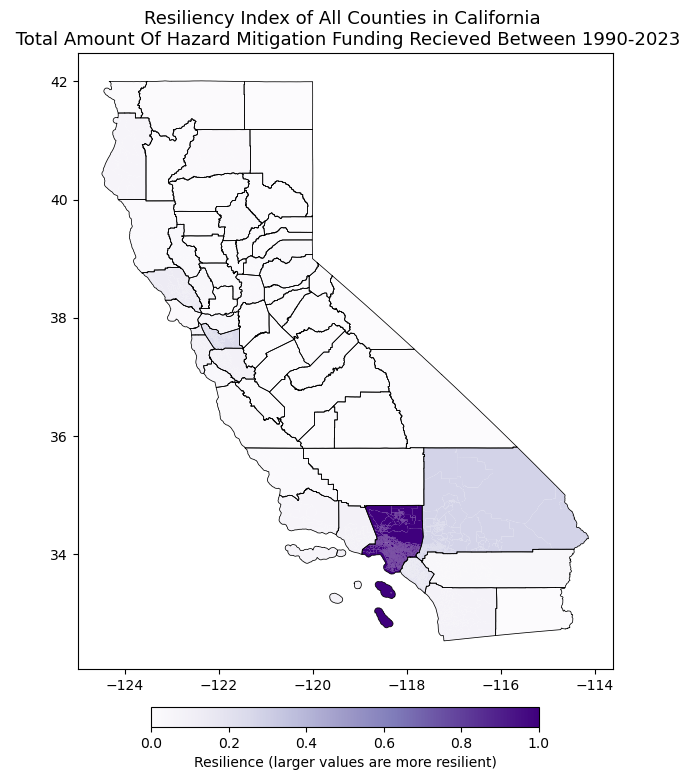

Plotting for column: % of households with mortgage, used as a proxy for posession of a homeowner's insurance policy
Plot saved: plots_directory\percent of households with mortgage, used as a proxy for posession of a homeowner's insurance policy_plot.png


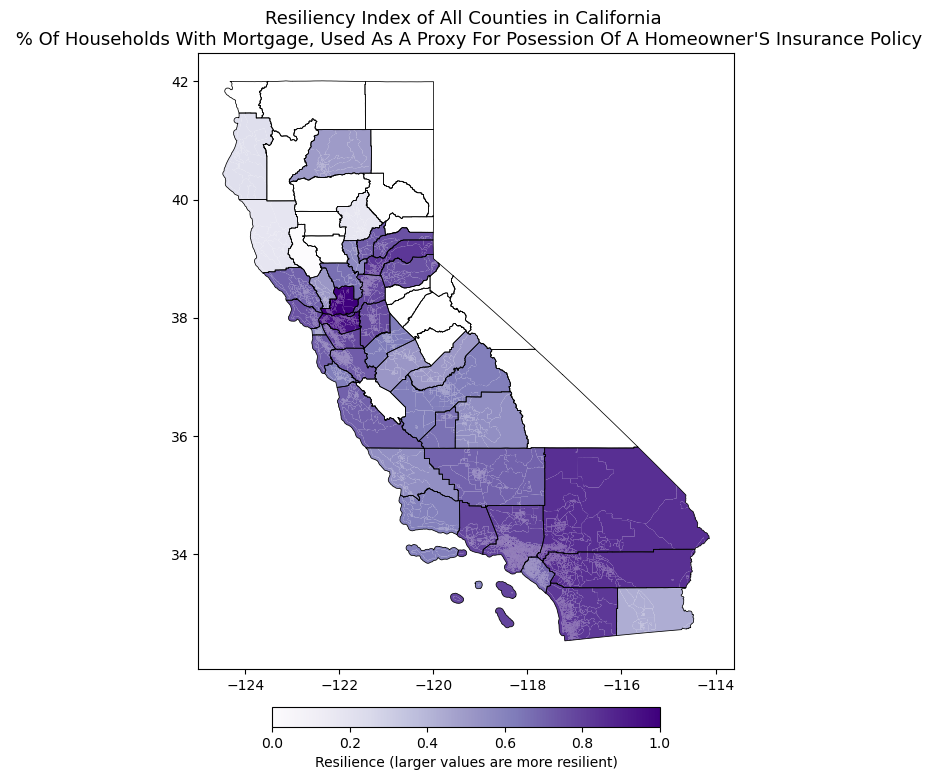

Plotting for column: % of survey respondents who have engaged in at least one preparedness action in the last year
Plot saved: plots_directory\percent of survey respondents who have engaged in at least one preparedness action in the last year_plot.png


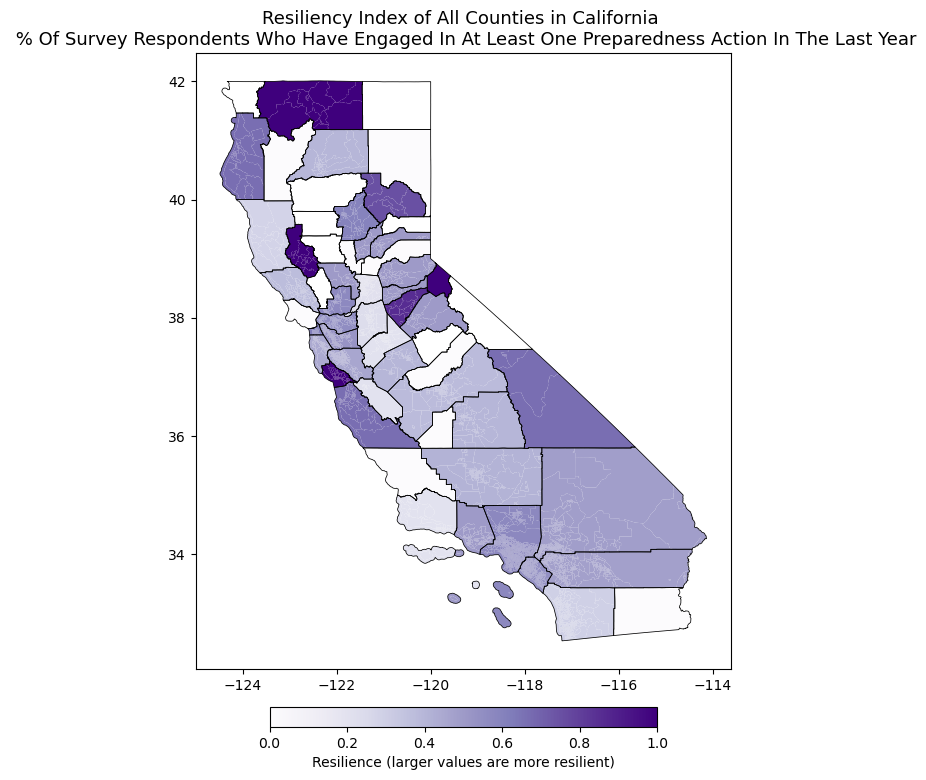

Plotting for column: % of survey respondents who can live in their homes for at least 3 days without power
Plot saved: plots_directory\percent of survey respondents who can live in their homes for at least 3 days without power_plot.png


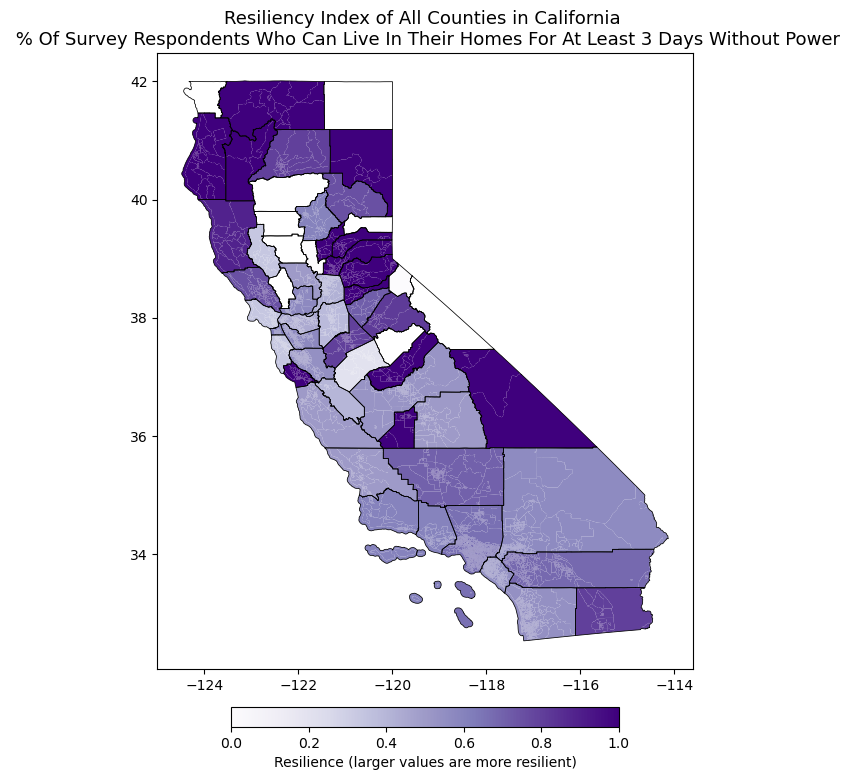

Plotting for column: % of survey respondents who can live in their homes for at least 3 days without running water
Plot saved: plots_directory\percent of survey respondents who can live in their homes for at least 3 days without running water_plot.png


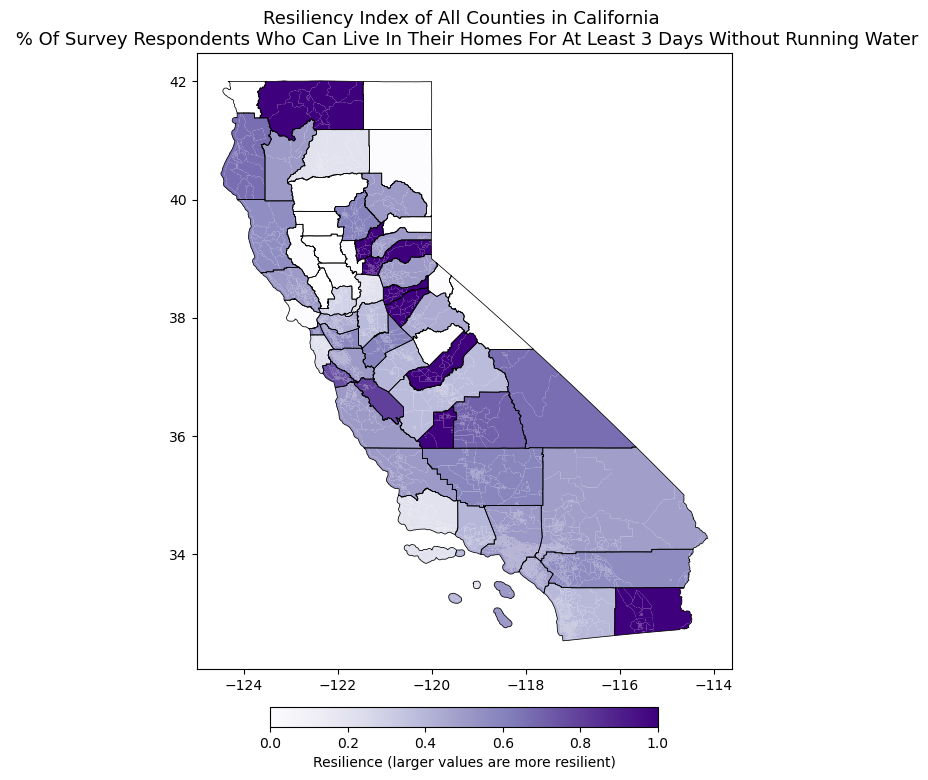

Plotting for column: # of police officers per 10,000 people
Plot saved: plots_directory\number of police officers per 10,000 people_plot.png


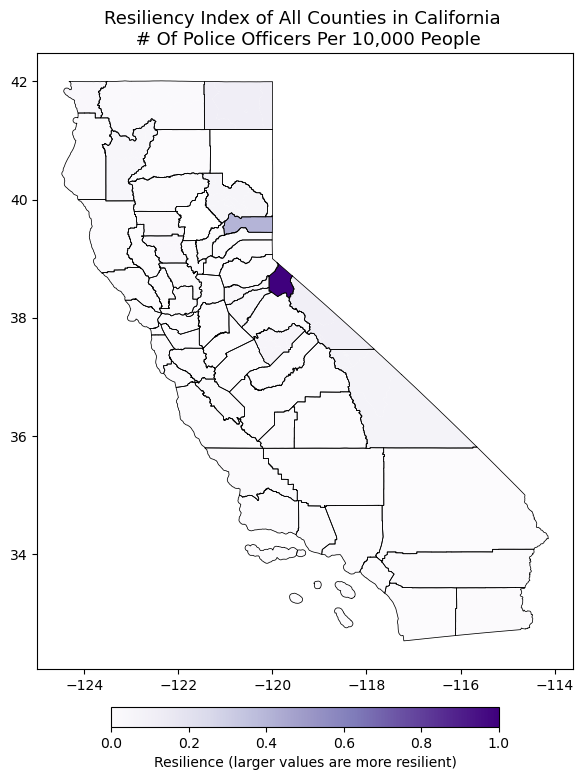

Plotting for column: # of registered nurses per 10,000 people
Plot saved: plots_directory\number of registered nurses per 10,000 people_plot.png


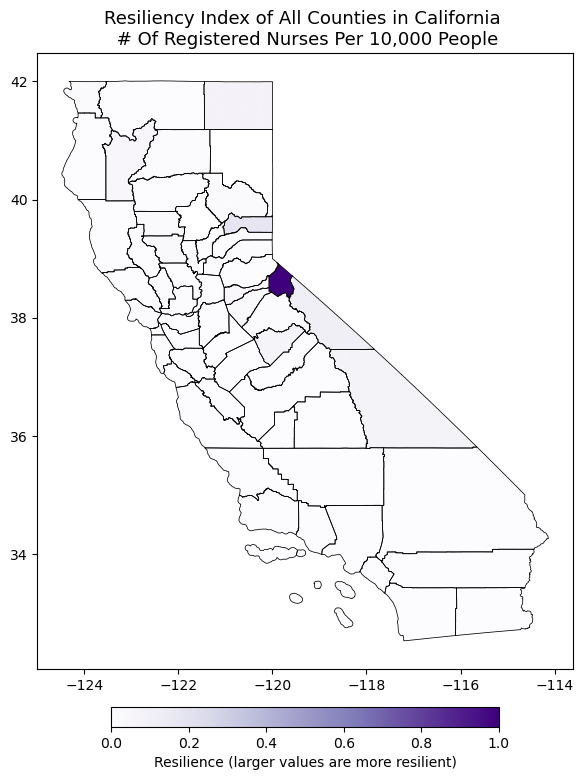

Plotting for column: % of land under timber management practices
Plot saved: plots_directory\percent of land under timber management practices_plot.png


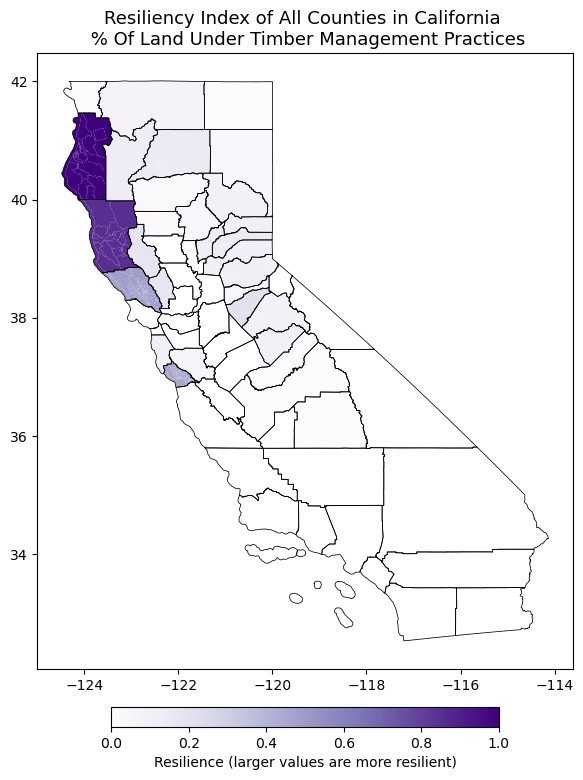

Plotting for column: % of domestic wells considered high risk for any of the following contaminants: nitrate, arsenic, 1,2,3-Trichloropropane, hexavalent chromium, uranium
Plot saved: plots_directory\percent of domestic wells considered high risk for any of the following contaminants_ nitrate, arsenic, 1,2,3-Trichloropropane, hexavalent chromium, uranium_plot.png


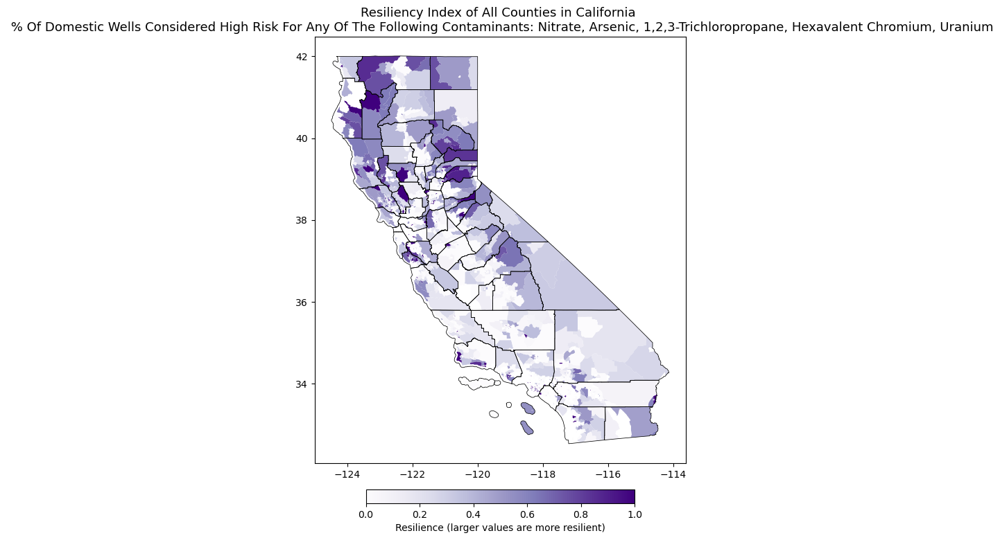

Plotting for column: % of days with unhealthy or worse air quality days between 1980-2022
Plot saved: plots_directory\percent of days with unhealthy or worse air quality days between 1980-2022_plot.png


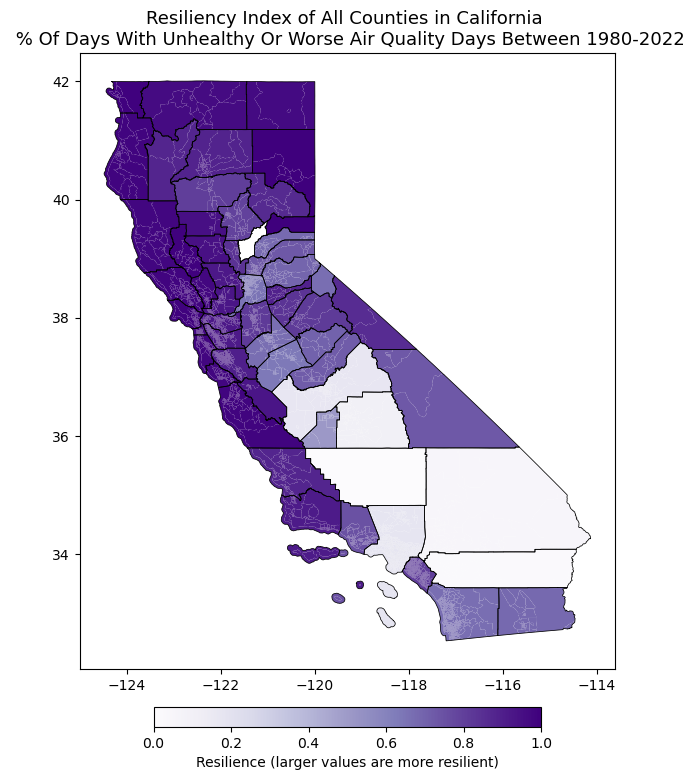

Plotting for column: % of land under management practices
Plot saved: plots_directory\percent of land under management practices_plot.png


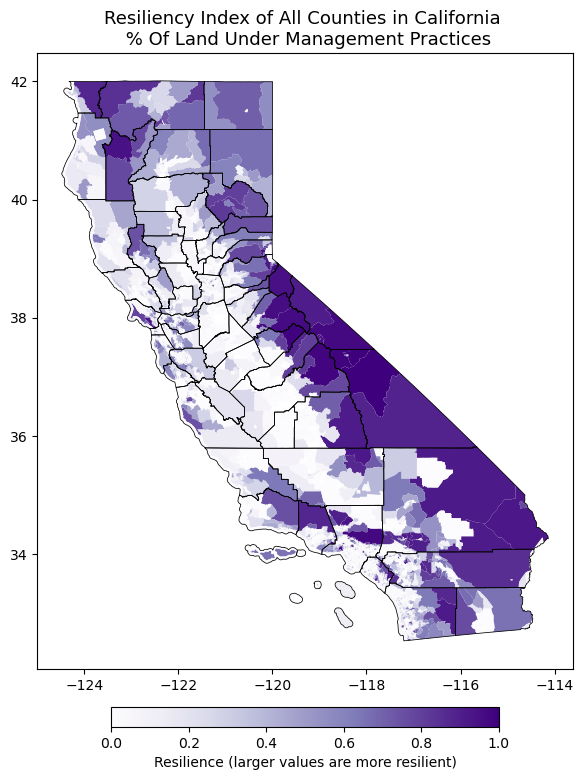

Plotting for column: mean evaporative stress index
Plot saved: plots_directory\mean evaporative stress index_plot.png


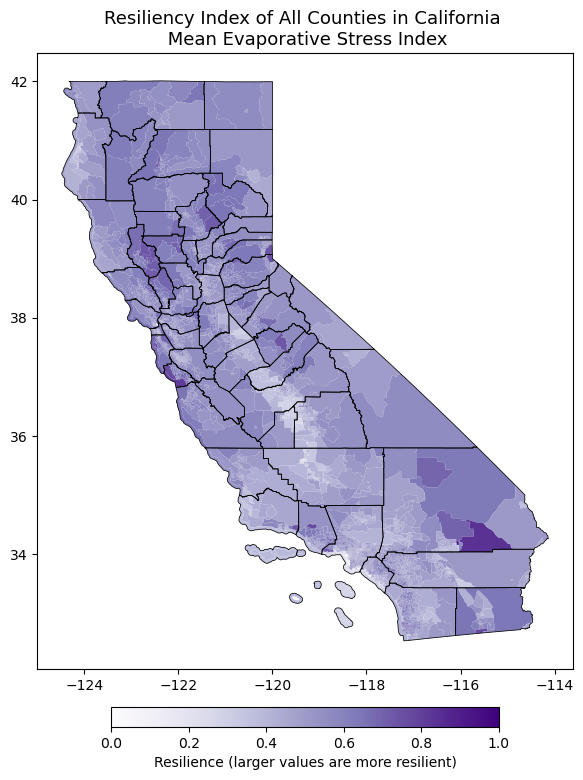

Plotting for column: mean surface soil moisture anomaly
Plot saved: plots_directory\mean surface soil moisture anomaly_plot.png


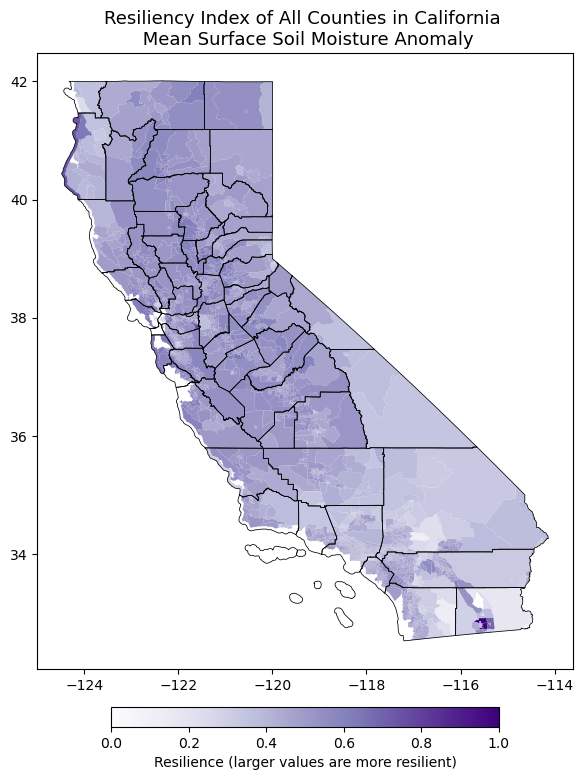

Plotting for column: % of soil cover rated moderately fragile or worse
Plot saved: plots_directory\percent of soil cover rated moderately fragile or worse_plot.png


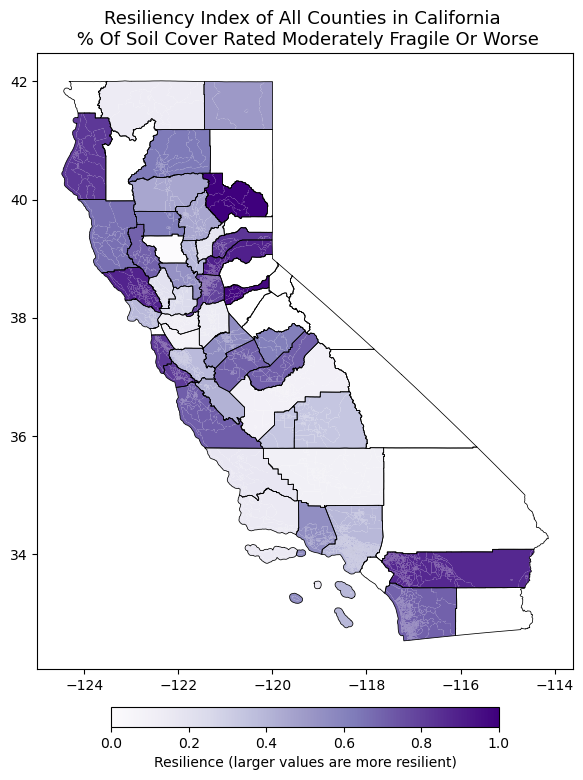

Plotting for column: % of soil rated moderately drought vulnerable or worse
Plot saved: plots_directory\percent of soil rated moderately drought vulnerable or worse_plot.png


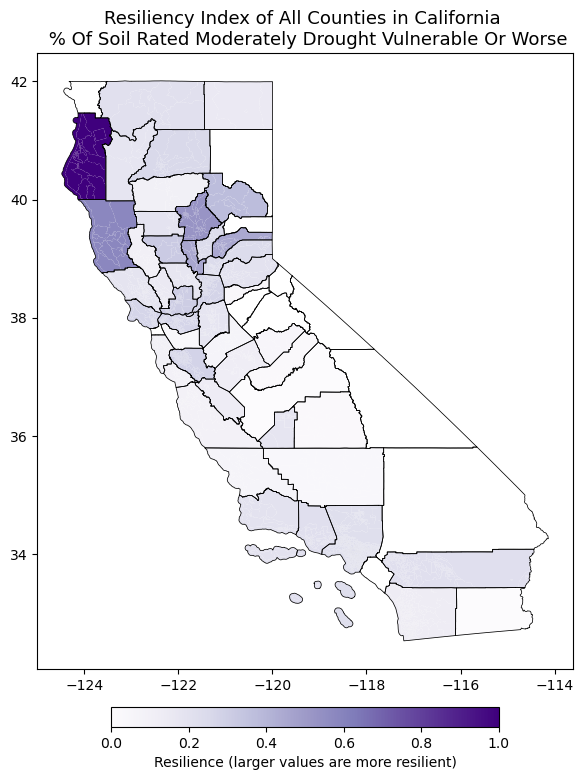

Plotting for column: % of soil moderately susceptible to fire damage
Plot saved: plots_directory\percent of soil moderately susceptible to fire damage_plot.png


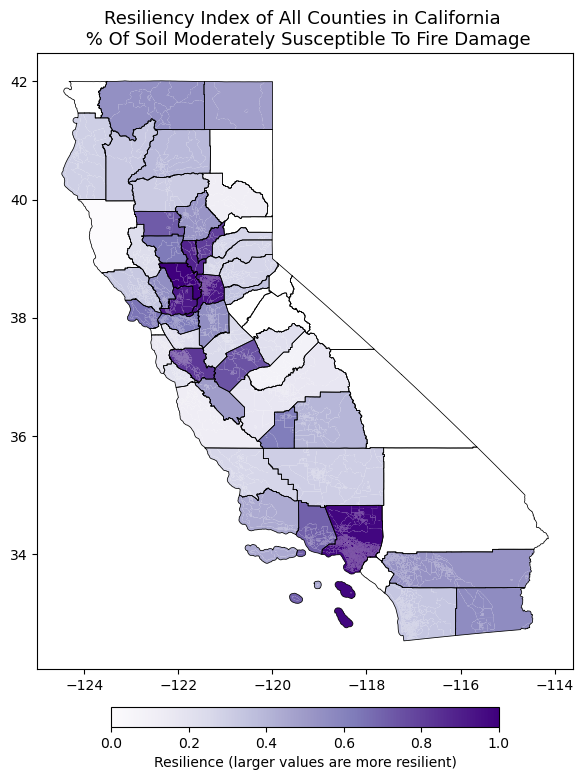

Plotting for column: ecoregion biodiversity weight score
Plot saved: plots_directory\ecoregion biodiversity weight score_plot.png


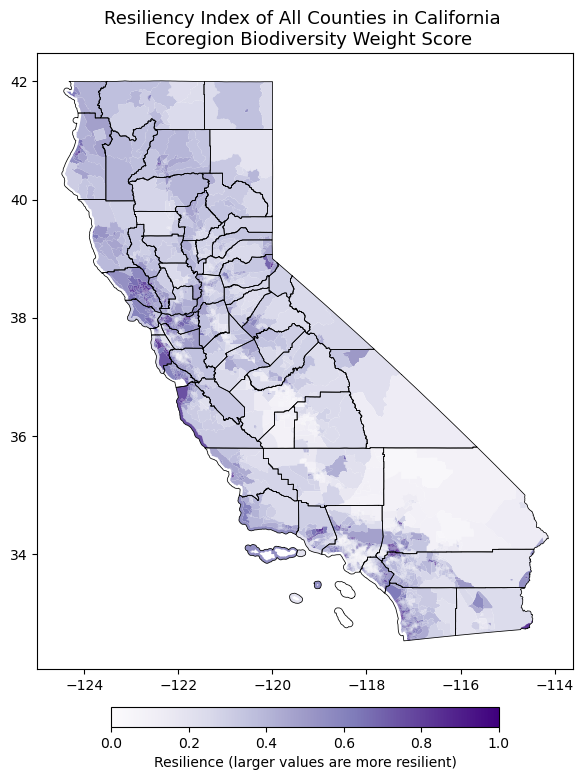

Plotting for column: % of impervious land
Plot saved: plots_directory\percent of impervious land_plot.png


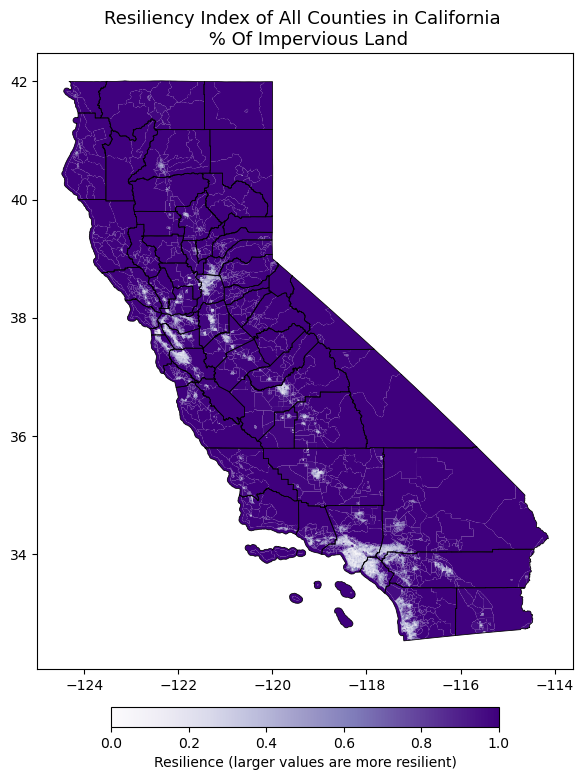

Plotting for column: % of population living with an ambulatory disability
Plot saved: plots_directory\percent of population living with an ambulatory disability_plot.png


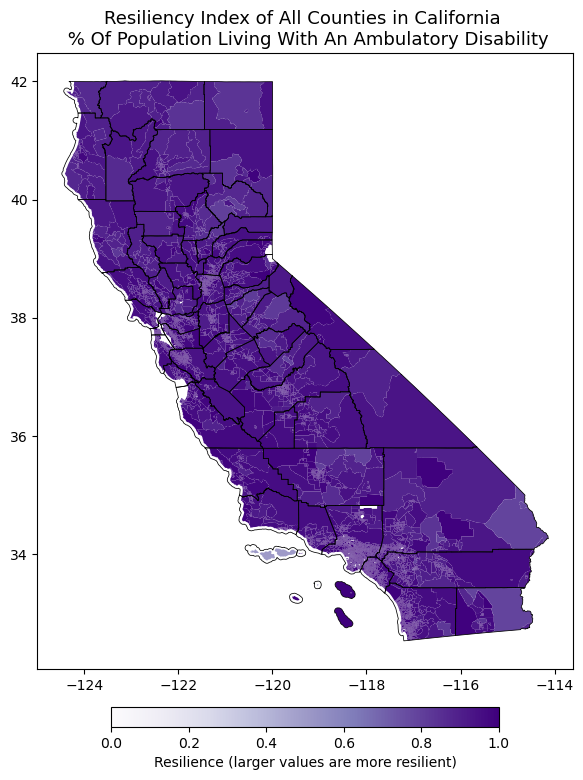

Plotting for column: % of population American Indian and Alaska Native
Plot saved: plots_directory\percent of population American Indian and Alaska Native_plot.png


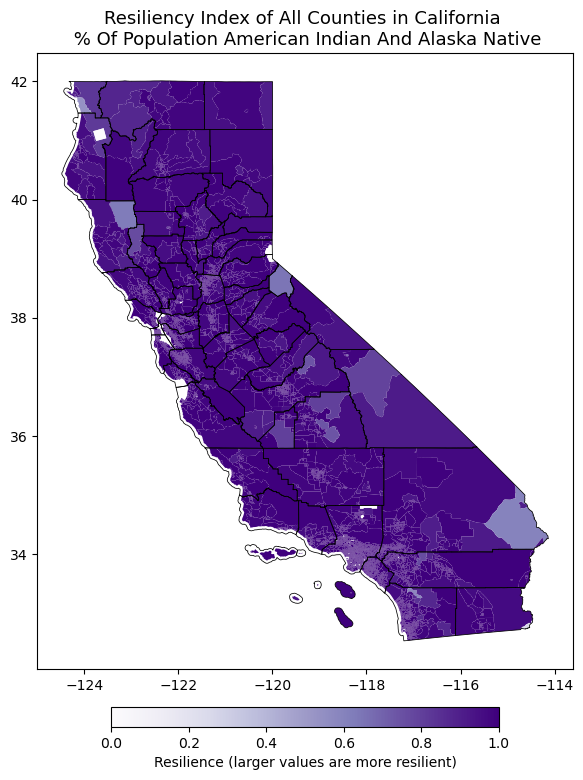

Plotting for column: # of blood and organ banks per 10,000 people
Plot saved: plots_directory\number of blood and organ banks per 10,000 people_plot.png


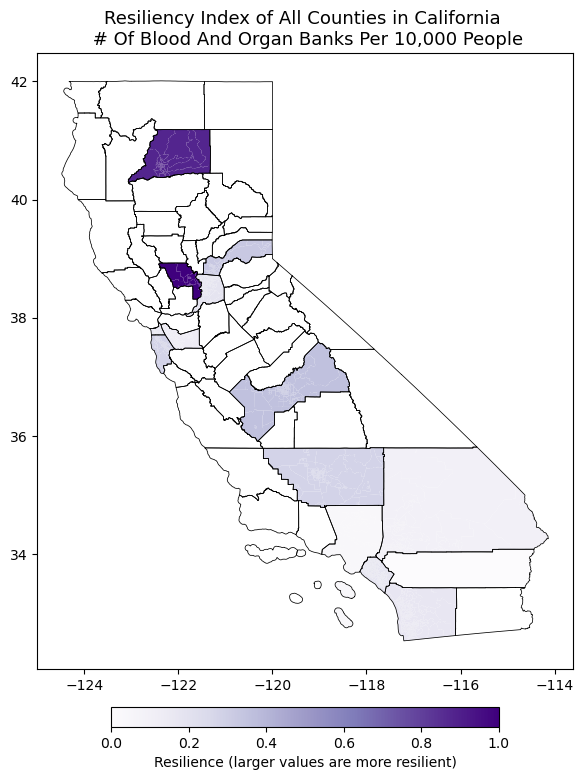

Plotting for column: % of population living with a cognitive disability
Plot saved: plots_directory\percent of population living with a cognitive disability_plot.png


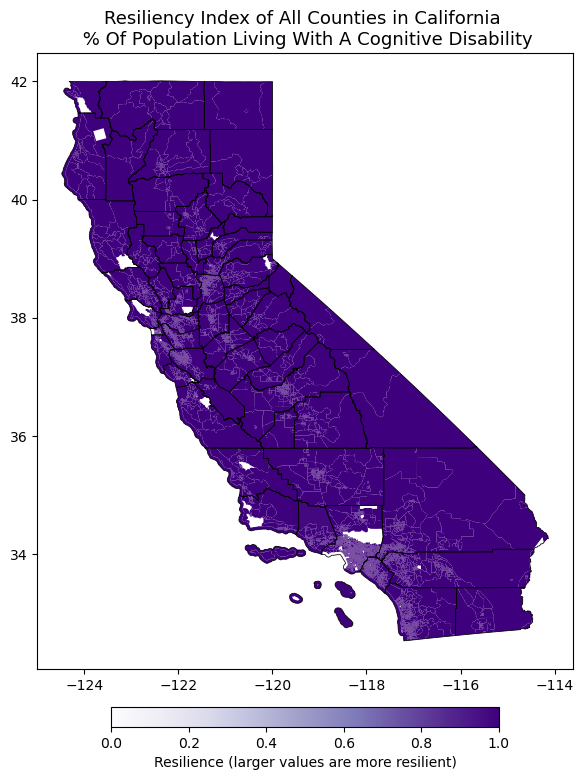

Plotting for column: gini index
Plot saved: plots_directory\gini index_plot.png


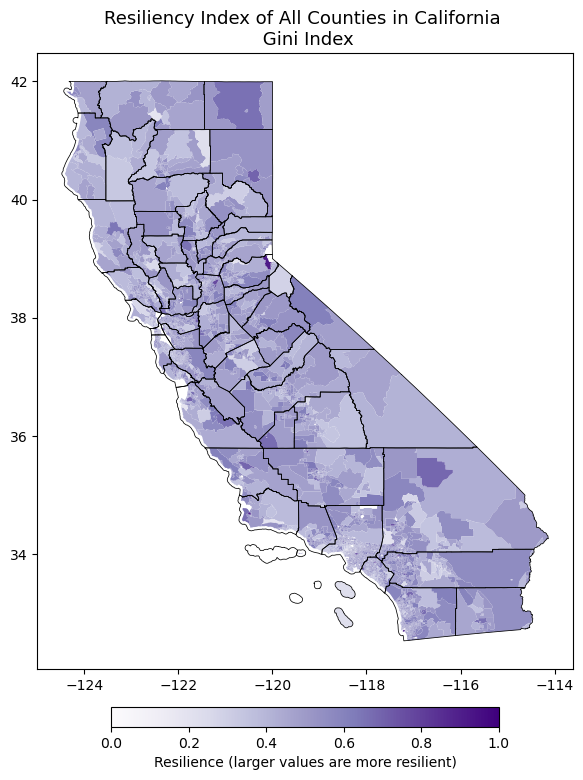

Plotting for column: hachman index from industry-specific employment data
Plot saved: plots_directory\hachman index from industry-specific employment data_plot.png


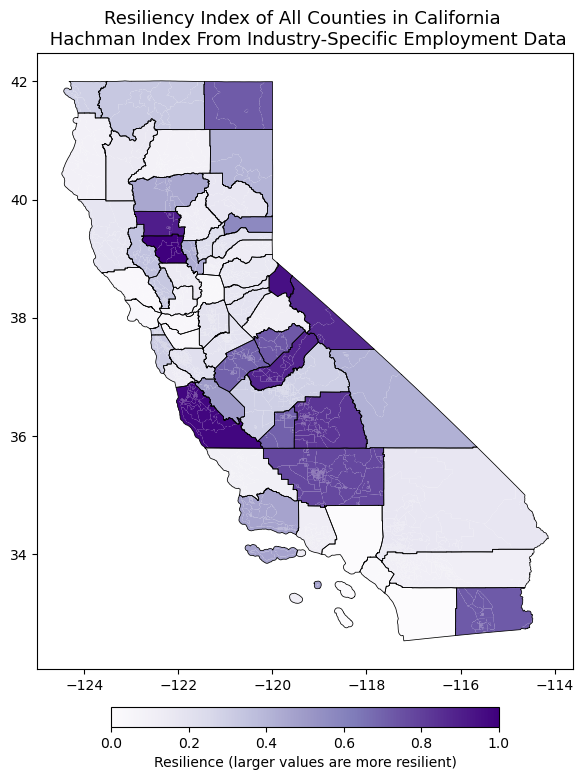

Plotting for column: median Income
Plot saved: plots_directory\median Income_plot.png


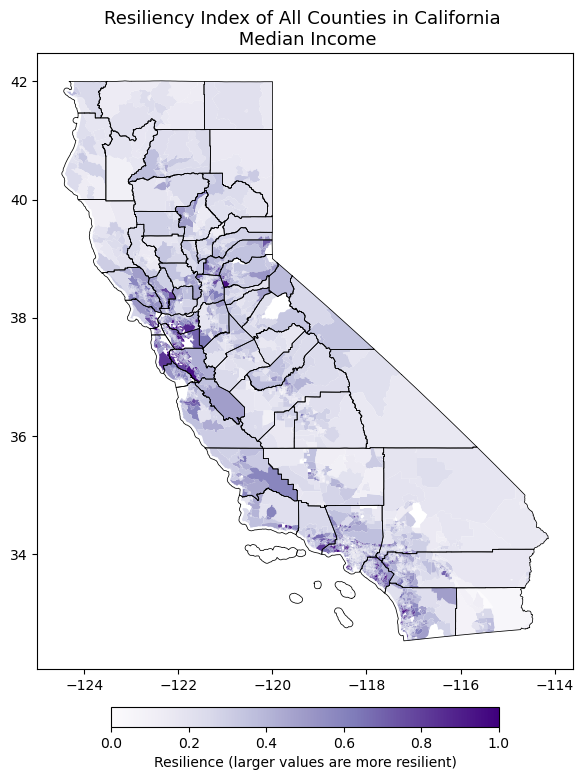

Plotting for column: % of population living in household with Supplemental Security Income (SSI), cash public assistance income, or Food Stamps/SNAP in the past 12 months
Plot saved: plots_directory\percent of population living in household with Supplemental Security Income (SSI), cash public assistance income, or Food Stamps_SNAP in the past 12 months_plot.png


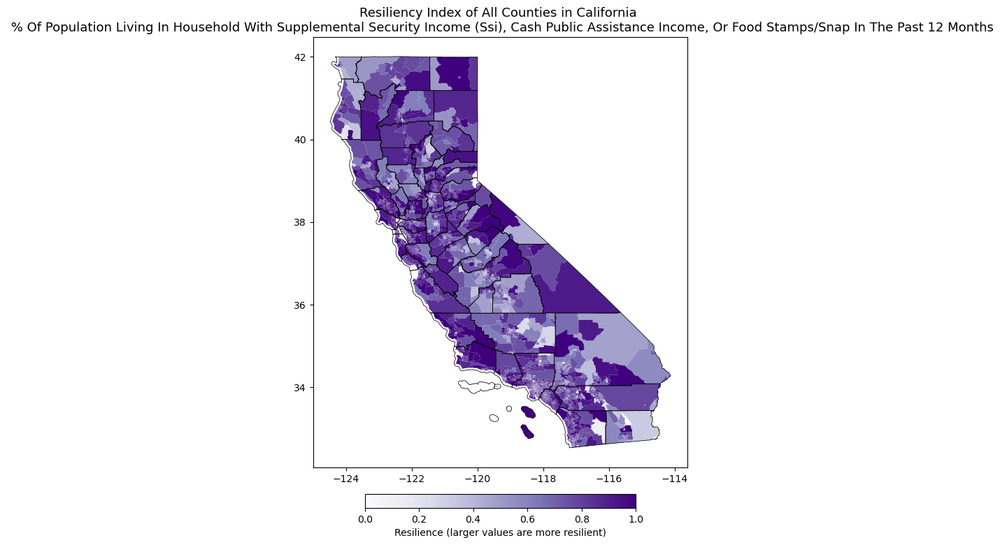

Plotting for column: % of population living more than 1 mile (urban) or 10 miles (rural) from nearest supermarket, supercenter, or large grocery store
Plot saved: plots_directory\percent of population living more than 1 mile (urban) or 10 miles (rural) from nearest supermarket, supercenter, or large grocery store_plot.png


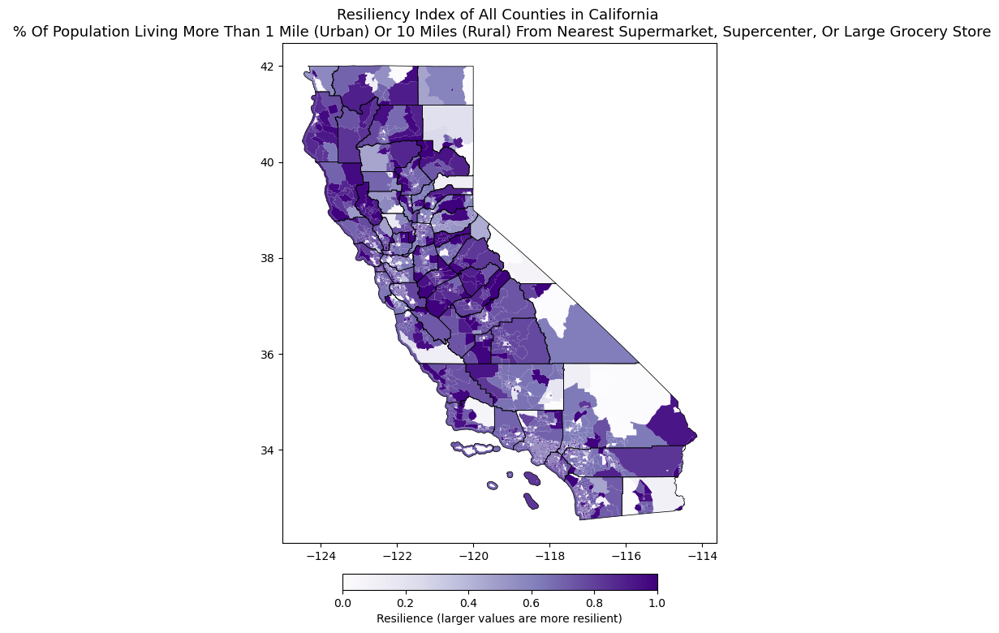

Plotting for column: # of health and personal care store facilities per 10,000 people
Plot saved: plots_directory\number of health and personal care store facilities per 10,000 people_plot.png


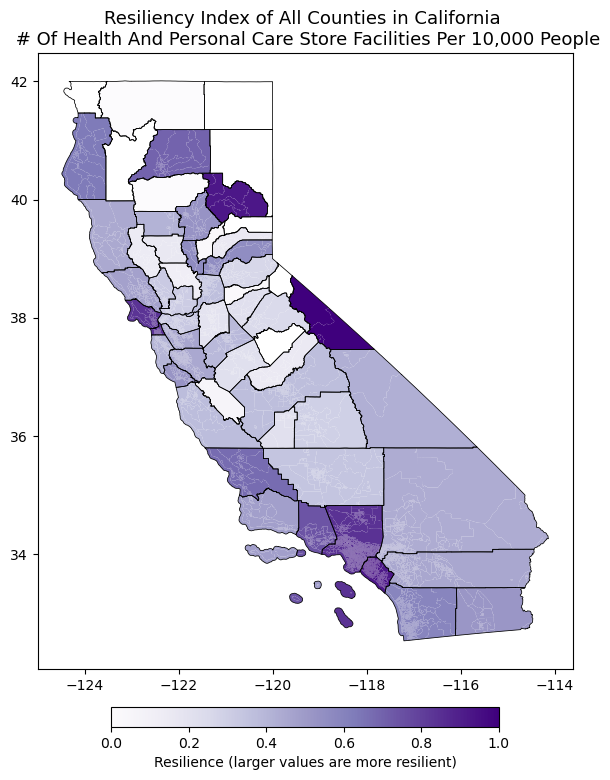

Plotting for column: # of heavy and civil engineering construction establishments and specialty trade contractors per 10,000 people
Plot saved: plots_directory\number of heavy and civil engineering construction establishments and specialty trade contractors per 10,000 people_plot.png


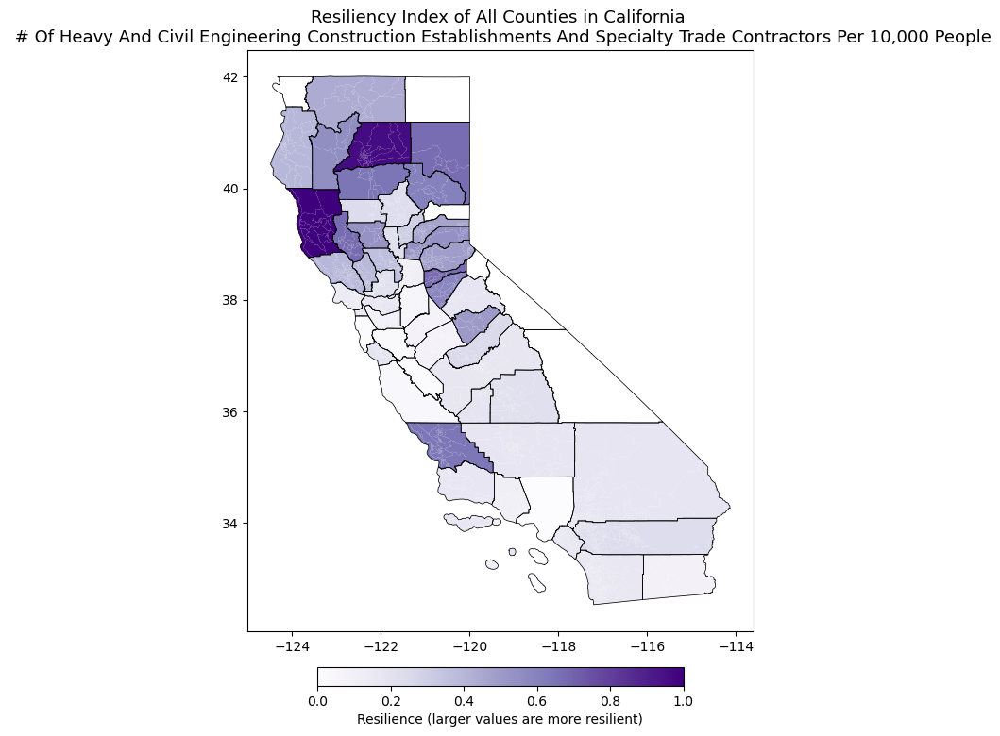

Plotting for column: # of hospitals per 10,000 people
Plot saved: plots_directory\number of hospitals per 10,000 people_plot.png


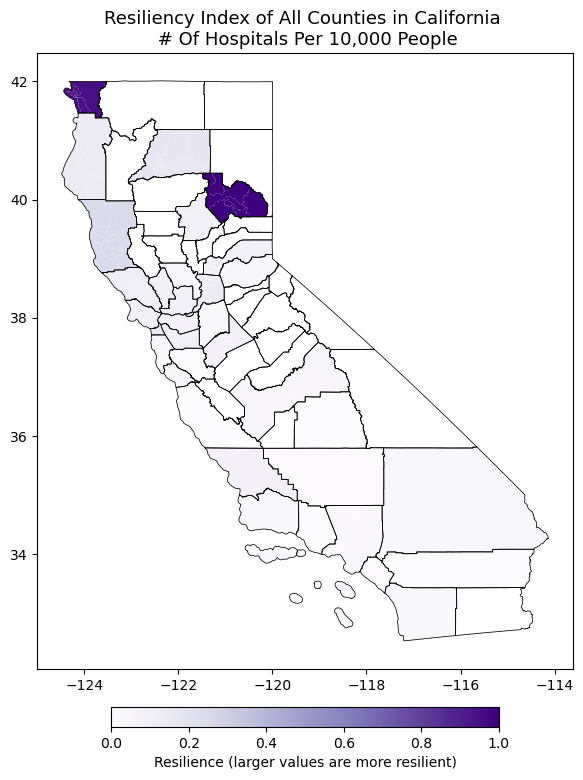

Plotting for column: average mental health professional shortage area score
Plot saved: plots_directory\average mental health professional shortage area score_plot.png


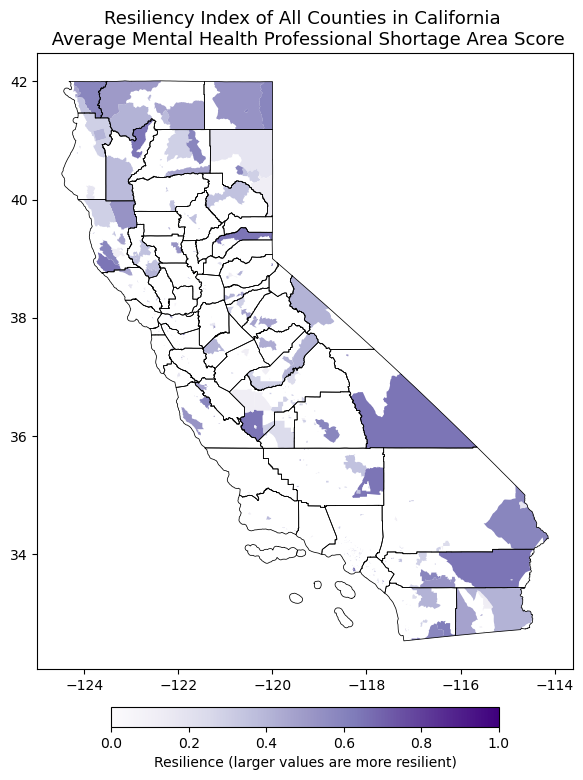

Plotting for column: # of licensed narcotic treatment programs per 10,000 people
Plot saved: plots_directory\number of licensed narcotic treatment programs per 10,000 people_plot.png


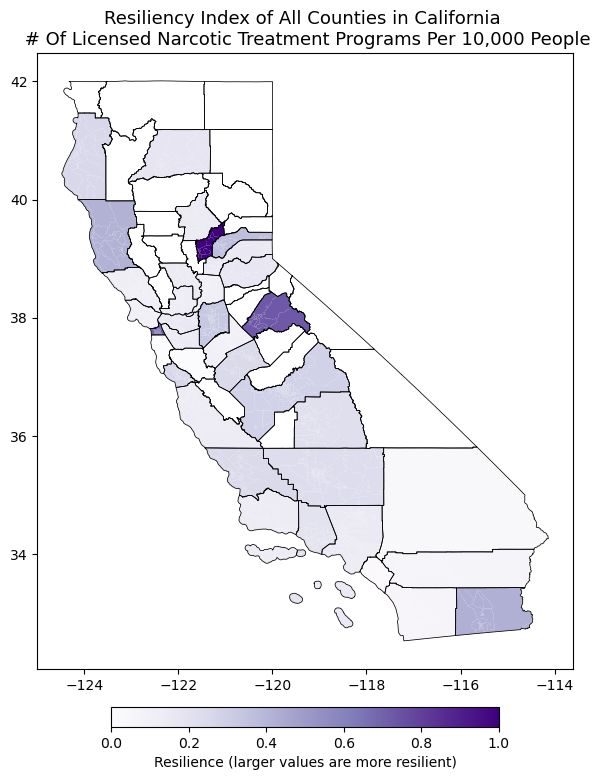

Plotting for column: % of population aged 65 or older
Plot saved: plots_directory\percent of population aged 65 or older_plot.png


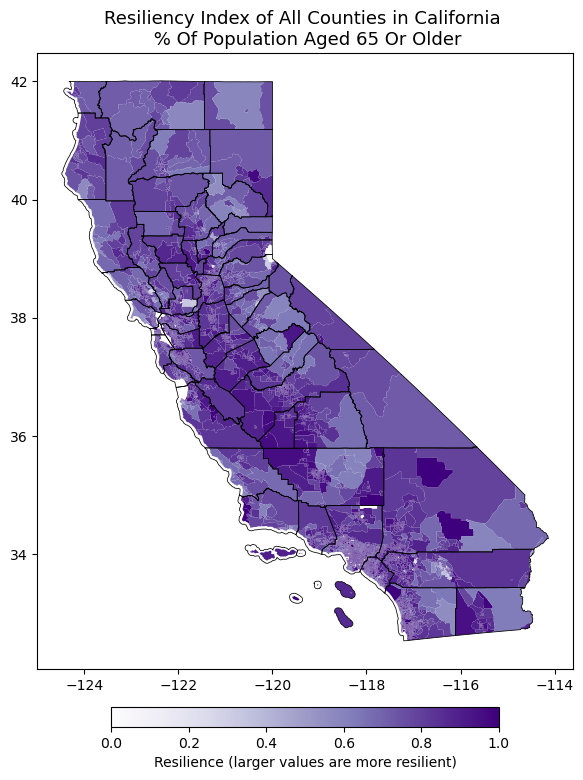

Plotting for column: # of household appliance stores and repair establishments per 10,000 people
Plot saved: plots_directory\number of household appliance stores and repair establishments per 10,000 people_plot.png


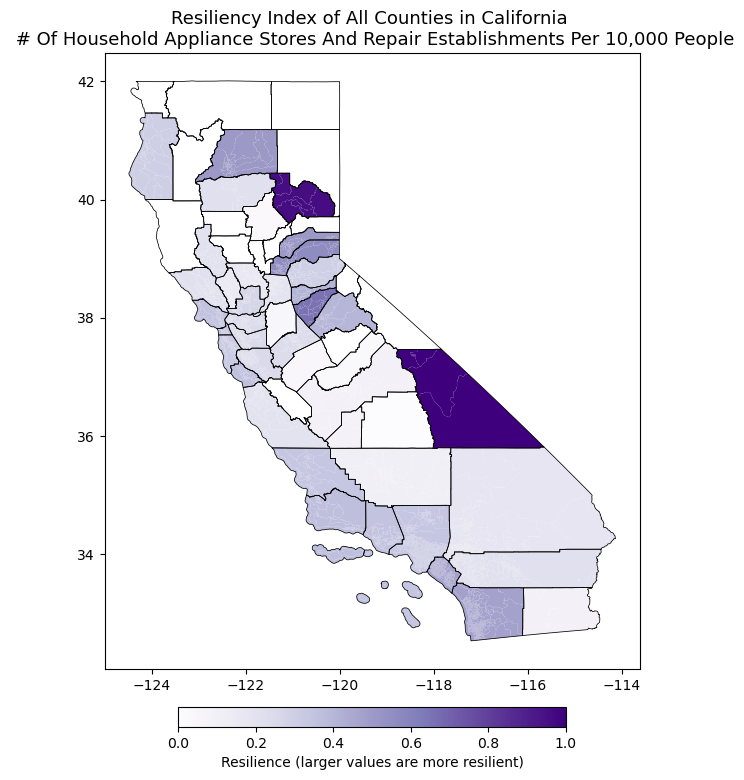

Plotting for column: average primary health care professional shortage area score
Plot saved: plots_directory\average primary health care professional shortage area score_plot.png


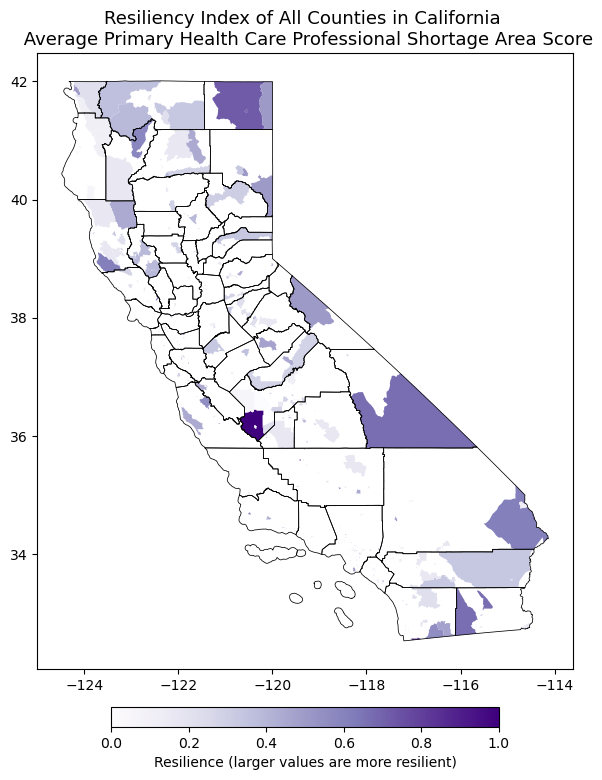

Plotting for column: # of specialty trade contractors per 10,000 people
Plot saved: plots_directory\number of specialty trade contractors per 10,000 people_plot.png


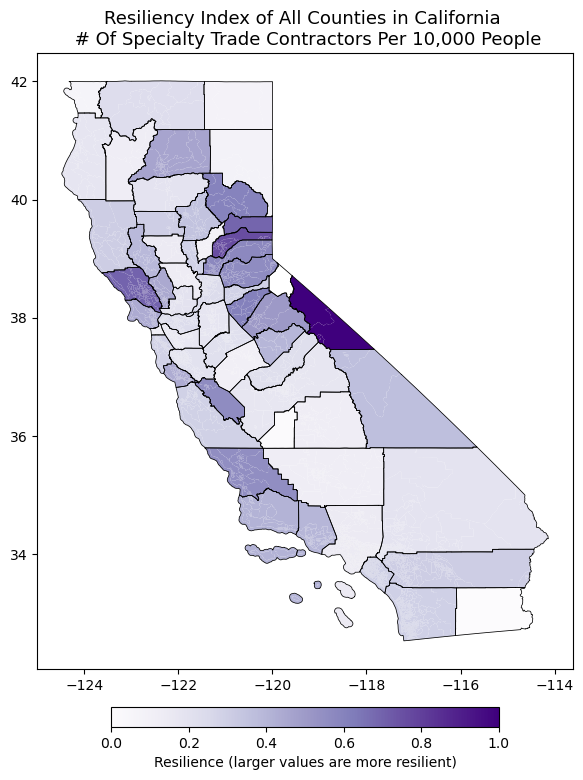

Plotting for column: % of population under 5 years old
Plot saved: plots_directory\percent of population under 5 years old_plot.png


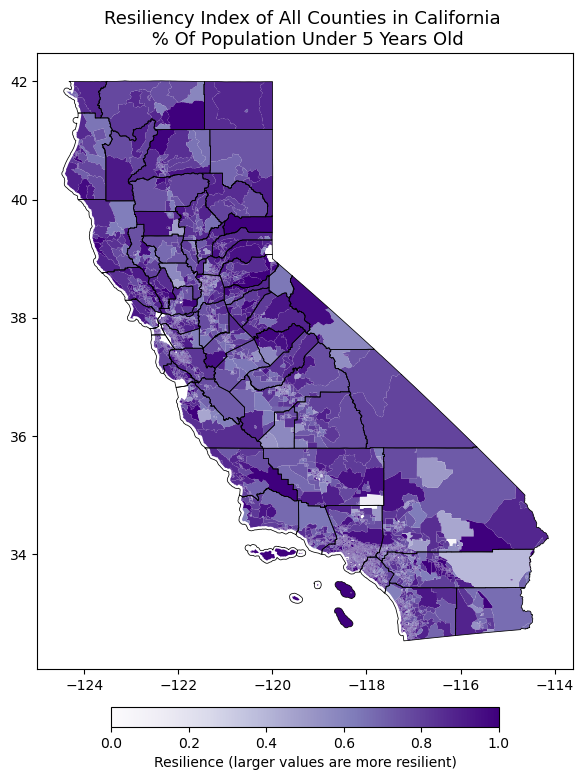

Plotting for column: age-adjusted emergency department visits per 10,000 people
Plot saved: plots_directory\age-adjusted emergency department visits per 10,000 people_plot.png


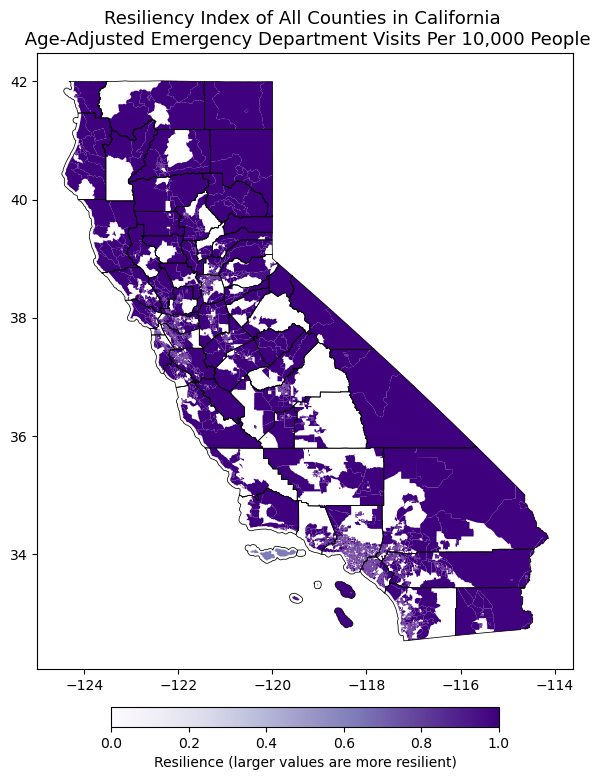

Plotting for column: age-adjusted emergency department visits for myocardial infarction per 10,000 people
Plot saved: plots_directory\age-adjusted emergency department visits for myocardial infarction per 10,000 people_plot.png


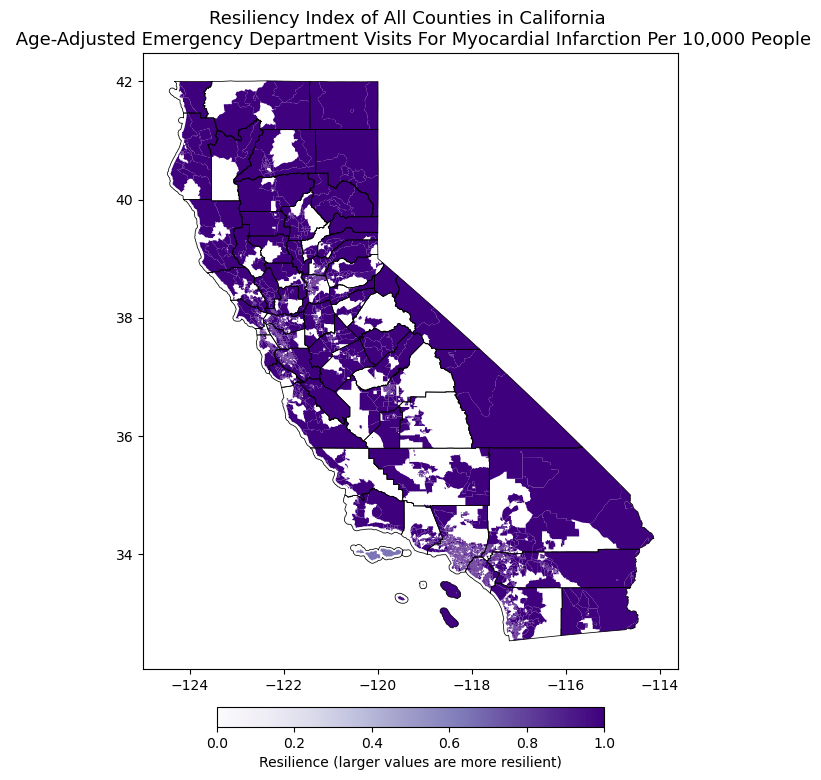

Plotting for column: % of population 25 and older with less than a high school education
Plot saved: plots_directory\percent of population 25 and older with less than a high school education_plot.png


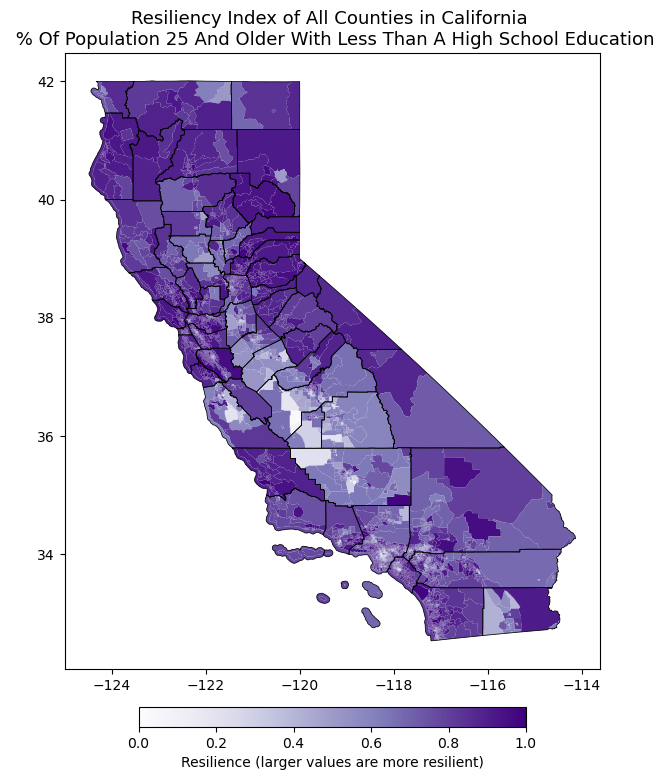

Plotting for column: average percentage of population receiving homeless response services
Plot saved: plots_directory\average percentage of population receiving homeless response services_plot.png


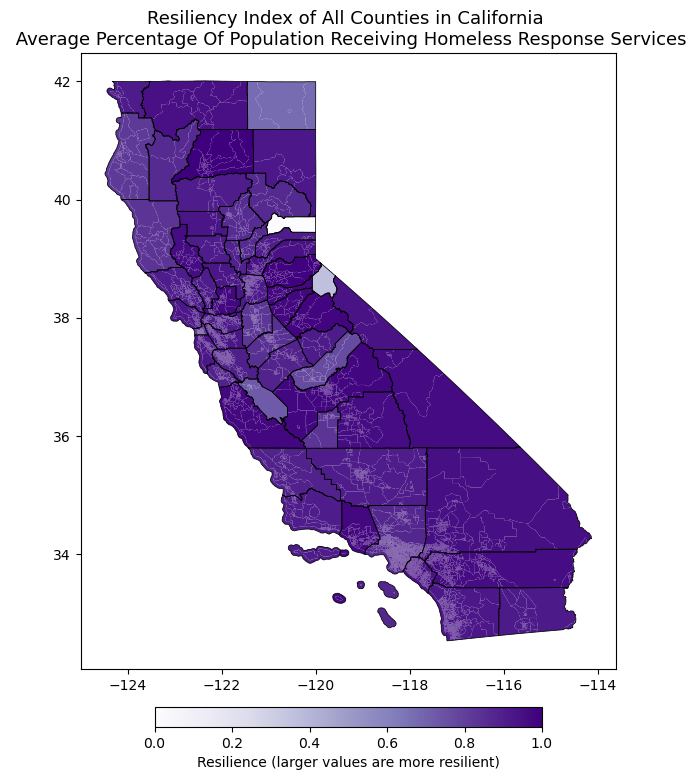

Plotting for column: % of housholds which are low-income and housing-burdened
Plot saved: plots_directory\percent of housholds which are low-income and housing-burdened_plot.png


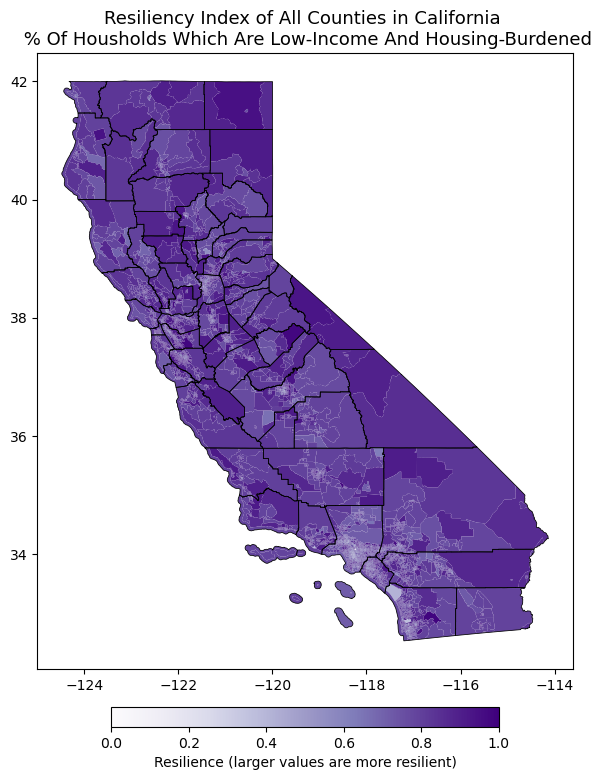

Plotting for column: drinking water score percentile
Plot saved: plots_directory\drinking water score percentile_plot.png


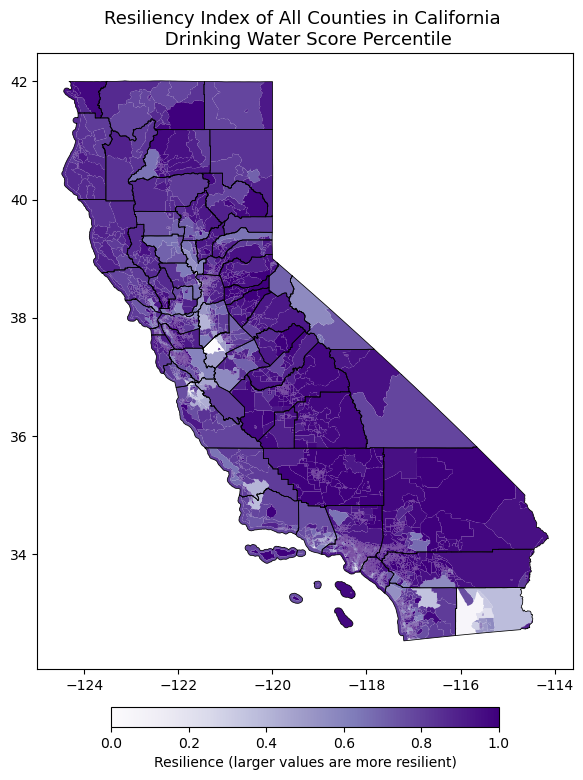

Plotting for column: % of households where all members 14 and older have some difficult speaking English
Plot saved: plots_directory\percent of households where all members 14 and older have some difficult speaking English_plot.png


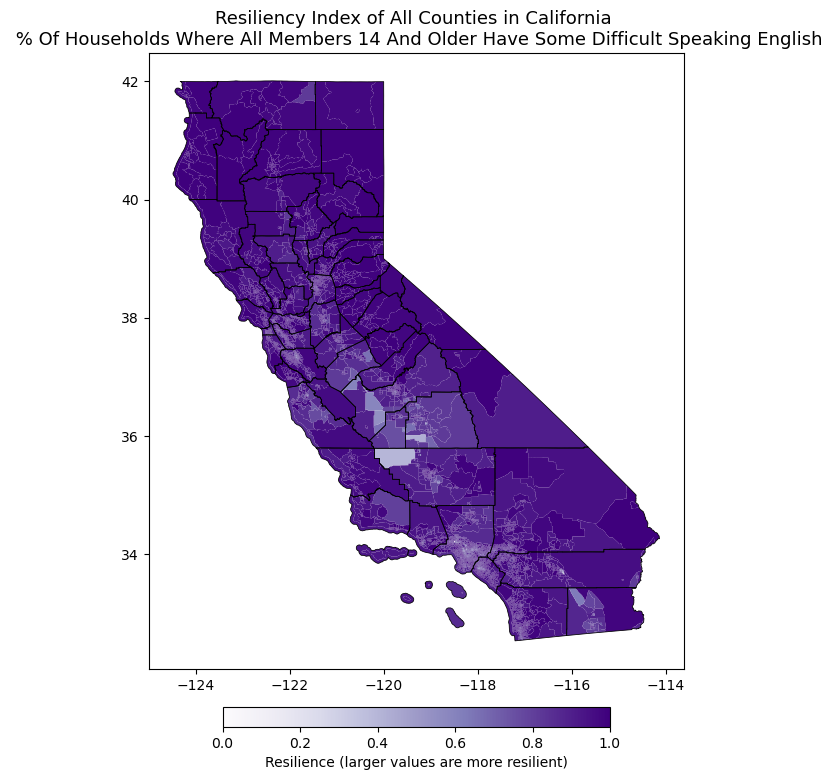

Plotting for column: % of live, singleton births < 5.5 pounds (non-twin, including premature)
Plot saved: plots_directory\percent of live, singleton births less than 5.5 pounds (non-twin, including premature)_plot.png


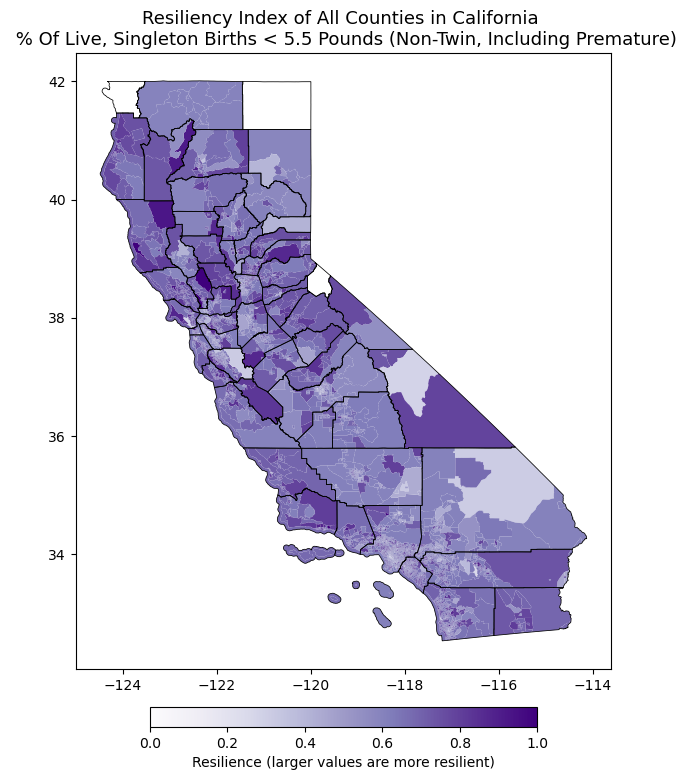

Plotting for column: % of households without air conditioning
Plot saved: plots_directory\percent of households without air conditioning_plot.png


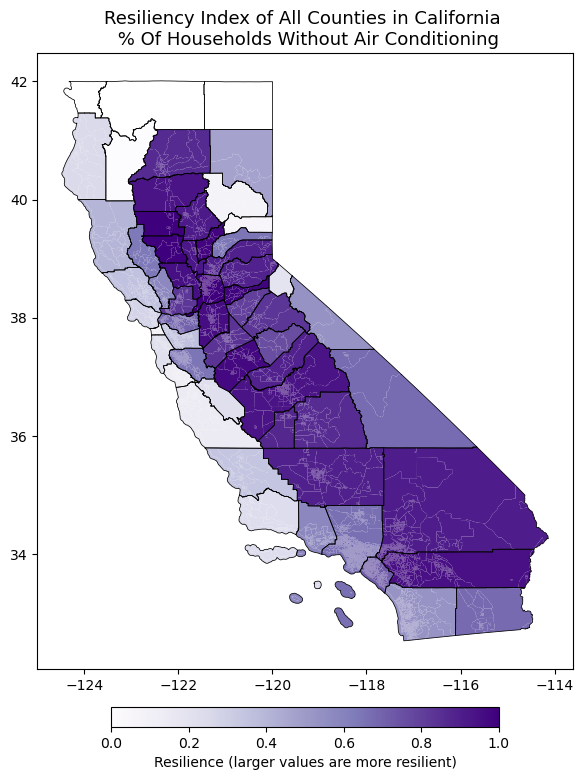

Plotting for column: % of population aged 16 and older working outdoors
Plot saved: plots_directory\percent of population aged 16 and older working outdoors_plot.png


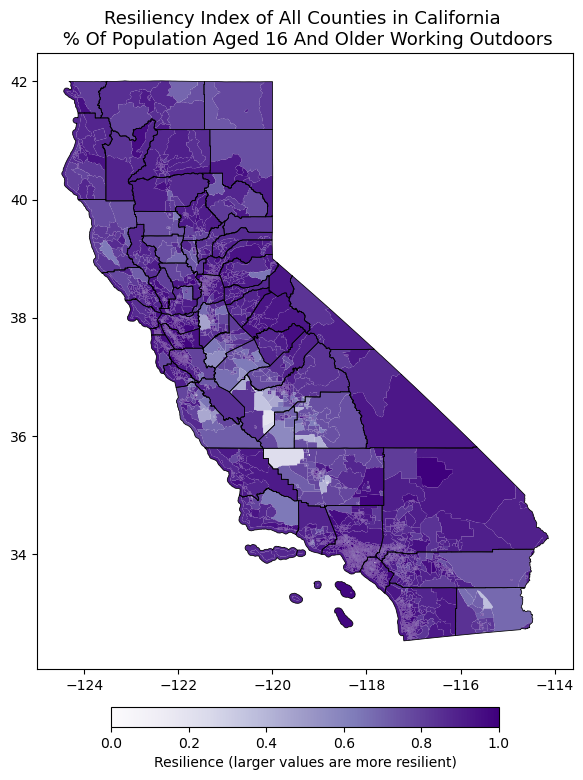

Plotting for column: % of population living below 2x federal poverty level
Plot saved: plots_directory\percent of population living below 2x federal poverty level_plot.png


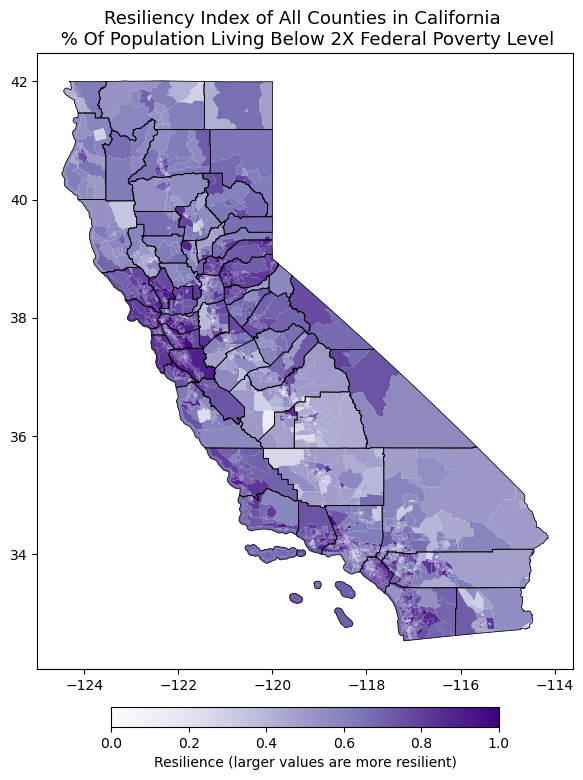

Plotting for column: % of population > 16 years old unemployed and eligible for the workforce
Plot saved: plots_directory\percent of population greater than 16 years old unemployed and eligible for the workforce_plot.png


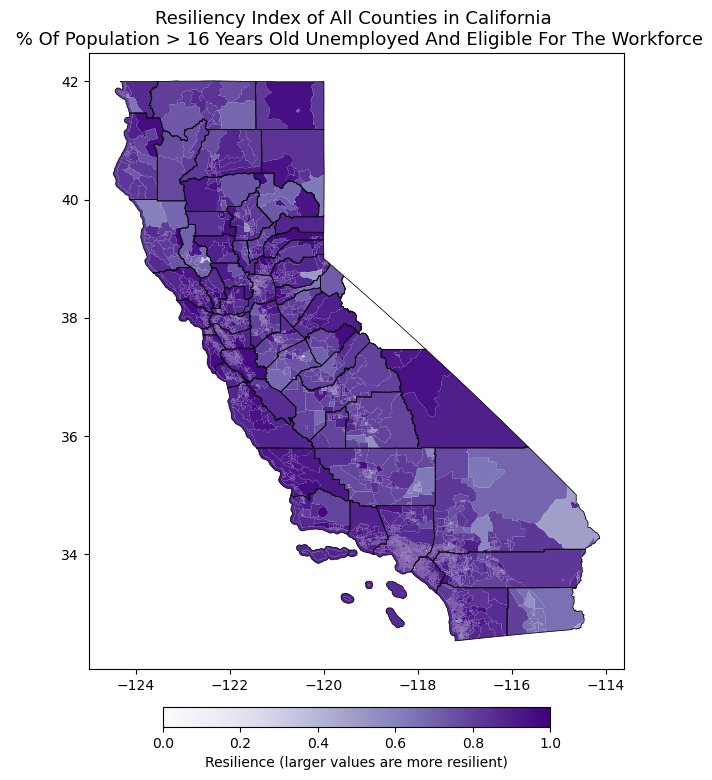

Plotting for column: # of violent crimes per 10,000 people
Plot saved: plots_directory\number of violent crimes per 10,000 people_plot.png


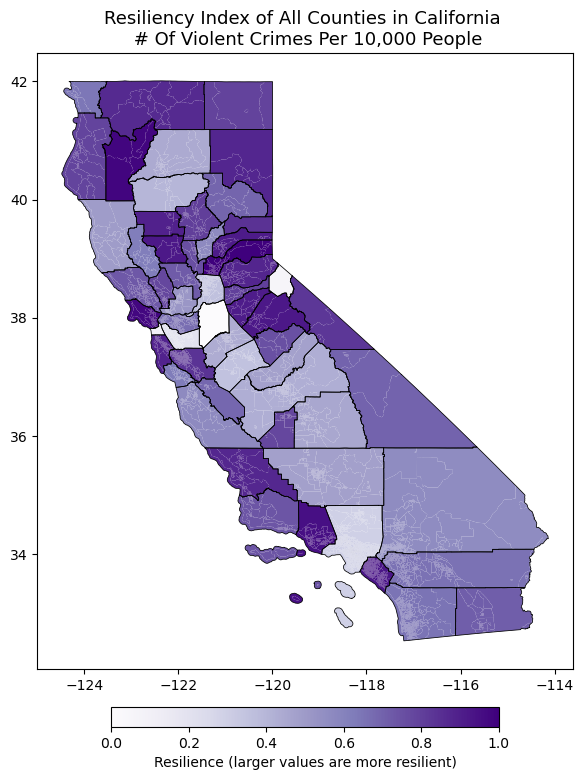

Plotting for column: % of population without health insurance
Plot saved: plots_directory\percent of population without health insurance_plot.png


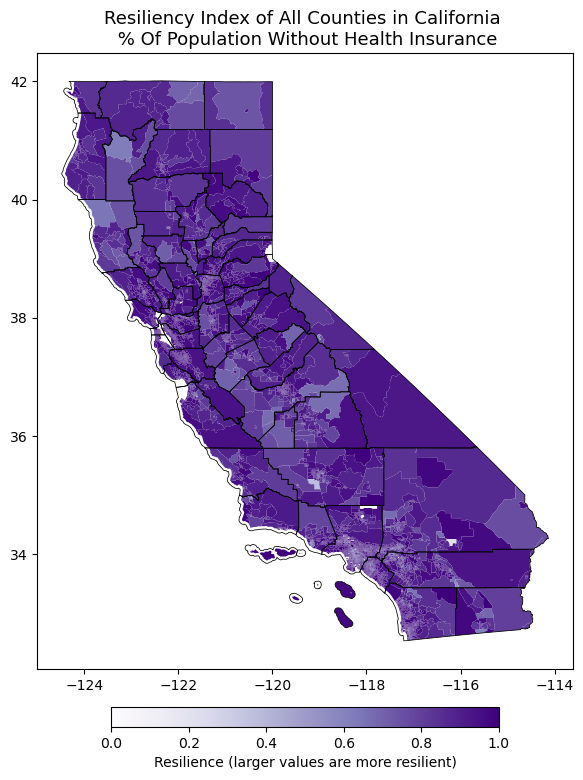

All plots have been saved to plots_directory


In [30]:
plot_region_individual_metrics(gdf, domain='Individual Metric', counties_to_plot=None, region=None, plot_all=True, savefig=True, output_folder='plots_directory')

In [ ]:
# Specify the path to your output folder
output_folder = 'C:/Users/jesse/eagle/carb-climate-index/plots_directory'

# Count the number of files in the directory
file_count = len([f for f in os.listdir(output_folder) if os.path.isfile(os.path.join(output_folder, f))])

# Print the result
print(f"Number of files in the output folder: {file_count}")